<a href="https://colab.research.google.com/github/rtegao/M5Forecasting/blob/master/ForecastingFood.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing Libraries

In [0]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
from sklearn.preprocessing import MinMaxScaler

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# Importing Data Set

In [0]:
dataset = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/sales_train_validation.csv')

In [4]:
dataset.shape

(30490, 1919)

In [5]:
dataset.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,...,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,1,3,1,3,1,2,2,0,1,1,1,1,0,0,0,0,0,1,0,4,2,3,0,1,2,0,0,0,1,1,3,0,1,1,1,3,0,1,1
1,HOBBIES_1_002_CA_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,HOBBIES_1_003_CA_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,2,2,1,2,1,1,1,0,1,1,1
3,HOBBIES_1_004_CA_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,3,4,2,1,4,1,3,5,0,6,6,0,0,0,0,3,1,2,1,3,1,0,2,5,4,2,0,3,0,1,0,5,4,1,0,1,3,7,2
4,HOBBIES_1_005_CA_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,3,2,2,2,3,1,0,0,0,0,1,0,4,4,0,1,4,0,1,0,1,0,1,1,2,0,1,1,2,1,1,0,1,1,2,2,2,4


In [6]:
dataset.loc[:,'d_1':].shape

(30490, 1913)

# In this Notebook I'll try to crate N LSTM models to predict a Food product from one store.


In [7]:
dataset.groupby(['state_id','cat_id']).first()

id  ... d_1913
state_id cat_id                                      ...       
CA       FOODS          FOODS_1_001_CA_1_validation  ...      0
         HOBBIES      HOBBIES_1_001_CA_1_validation  ...      1
         HOUSEHOLD  HOUSEHOLD_1_001_CA_1_validation  ...      1
TX       FOODS          FOODS_1_001_TX_1_validation  ...      0
         HOBBIES      HOBBIES_1_001_TX_1_validation  ...      2
         HOUSEHOLD  HOUSEHOLD_1_001_TX_1_validation  ...      0
WI       FOODS          FOODS_1_001_WI_1_validation  ...      1
         HOBBIES      HOBBIES_1_001_WI_1_validation  ...      1
         HOUSEHOLD  HOUSEHOLD_1_001_WI_1_validation  ...      0

[9 rows x 1917 columns]

In [0]:
group = dataset.groupby(['state_id','cat_id']).first()
df_food =  group.loc[('WI','FOODS'),'d_1':]
del group

# Spliting Data

In [9]:
train_limit = int(round((df_food.shape[0])*0.7,0))
val_limit = int(round((df_food.shape[0])*0.85,0))

df_food_train = df_food[:train_limit]
df_food_val = df_food[train_limit:val_limit]
df_food_test = df_food[val_limit:]

print(df_food_test.shape)

(287,)


# Normalizing Data


In [10]:
df_food_train = df_food_train.values.reshape(-1,1)
df_food_val = df_food_val.values.reshape(-1,1)
df_food_test = df_food_test.values.reshape(-1,1)

print(df_food_train.shape)
print(df_food_val.shape)
print(df_food_test.shape)

(1339, 1)
(287, 1)
(287, 1)


In [0]:
scaler_food = MinMaxScaler(feature_range=(0,1))
df_food_train = scaler_food.fit_transform(df_food_train)
df_food_val = scaler_food.transform(df_food_val)
df_food_test = scaler_food.transform(df_food_test)

# Regressor

- # The competition determines that the model predict 28 days in the future, so we need to scale the regressor and the outputs for this prerequisite.

- # The step time for each LTMS can be different, so lets start with the Hobbies data



In [0]:
def Regressor(future_steps,time_steps,n_features,df_train,df_val,df_test):
  # future_steps: how many days in the furure to predict 
  # time_steps: number of samples the LSTM model will use for predict 28 days in the future
  # n_features: number of features (LSTM input) 

  #################### TRAIN #################################################
  # Defining the number of samples for the train data
  n_samples = df_train.shape[0]
  x_train = []
  y_train = []

  # shaping data to have the number of time_steps in the x_train ans the 28 future values in the y_train 
  for i in range(time_steps,n_samples - time_steps): 
    x_train.append(df_train[i - time_steps : i, 0])
    y_train.append(df_train[i : i+future_steps,0])

  x_train,y_train = np.array(x_train),np.array(y_train) # transforming in array
  # LSTM need 3D tensor as input 
  x_train = np.reshape(x_train,(x_train.shape[0],x_train.shape[1],n_features))  

  ##################### VALIDATION ###############################################

  # to predict the first 28 values of the validation data, LSTM need time_steps values. 
  # to make this possible I'm using the last 60 values that came before the validation data.
  df_val = np.concatenate((df_train[-time_steps:],df_val))

  n_samples = df_val.shape[0]
  x_val = []
  y_val = []

  for i in range(time_steps,n_samples - time_steps):
    x_val.append(df_val[i - time_steps : i, 0])
    y_val.append(df_val[i : i+future_steps,0])

  x_val,y_val = np.array(x_val),np.array(y_val)
  x_val = np.reshape(x_val,(x_val.shape[0],x_val.shape[1],n_features))

  ####################### TEST ################################################
  # the same methodologie implemented in training and validation data are here in the test data

  df_test = np.concatenate((df_val[-time_steps:],df_test))
  n_samples = df_test.shape[0]
  x_test = []
  y_test = []

  for i in range(time_steps,n_samples - time_steps):
    x_test.append(df_test[i - time_steps : i, 0])
    y_test.append(df_test[i : i+future_steps,0])

  x_test,y_test = np.array(x_test),np.array(y_test)
  x_test = np.reshape(x_test,(x_test.shape[0],x_test.shape[1],n_features))
  
  return x_train,x_test,x_val,y_train,y_val,y_test

In [0]:
time_steps = 60
future_steps = 28
n_features = 1
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_food_train,df_val = df_food_val,df_test = df_food_test)

# LSTM (Hobbies)

## First try

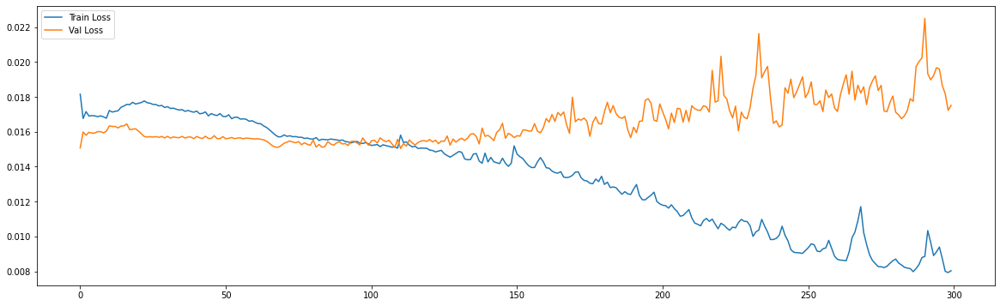

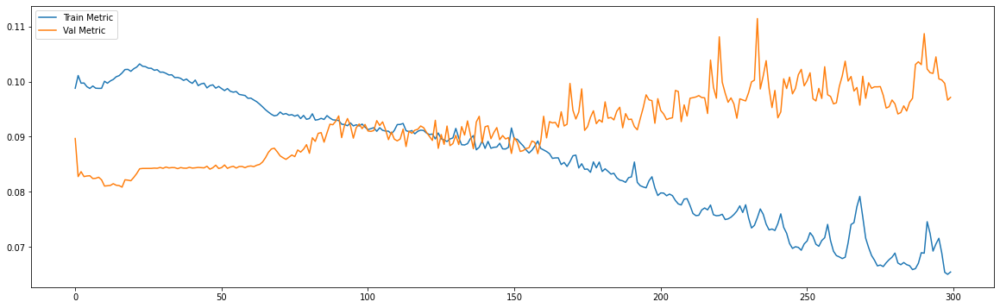



39/39 [==============================] - 0s 6ms/step - loss: 0.0084 - mae: 0.0654
loss and metric train data [0.008386374451220036, 0.06543157249689102]
8/8 [==============================] - 0s 5ms/step - loss: 0.0175 - mae: 0.0971
loss and metric val data [0.017513511702418327, 0.09714583307504654]
8/8 [==============================] - 0s 5ms/step - loss: 0.0134 - mae: 0.0870
loss and metric test data [0.013437391258776188, 0.08700226992368698]


In [14]:
# The LSTM architecture

regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

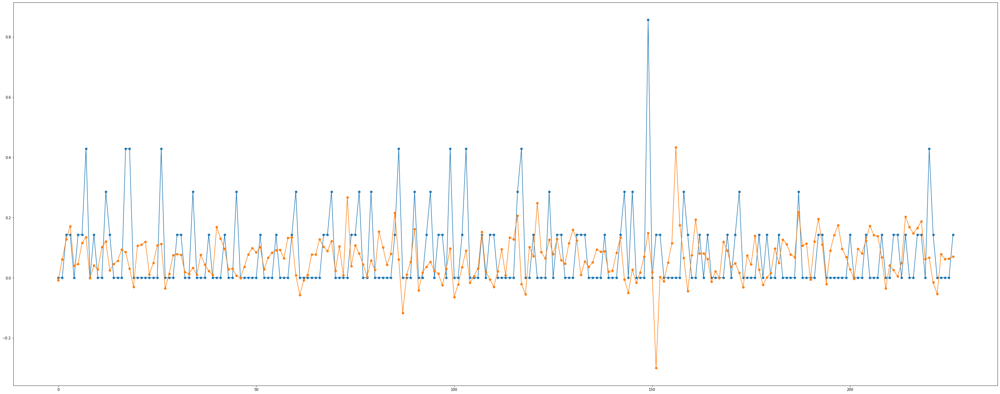

In [15]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### Dropout

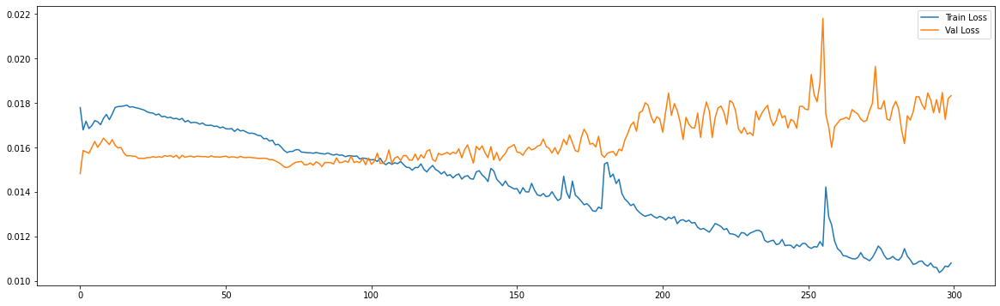

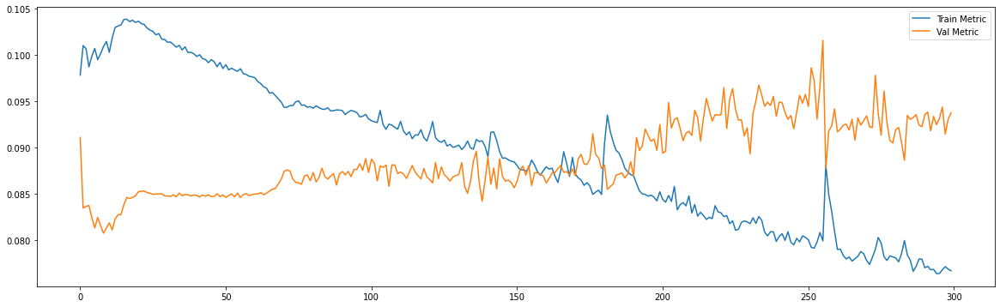



39/39 [==============================] - 0s 6ms/step - loss: 0.0110 - mae: 0.0739
loss and metric train data [0.0109751271083951, 0.07386992126703262]
8/8 [==============================] - 0s 5ms/step - loss: 0.0183 - mae: 0.0938
loss and metric val data [0.018324853852391243, 0.09375736862421036]
8/8 [==============================] - 0s 5ms/step - loss: 0.0125 - mae: 0.0790
loss and metric test data [0.012527236714959145, 0.07902709394693375]


In [16]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.2))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

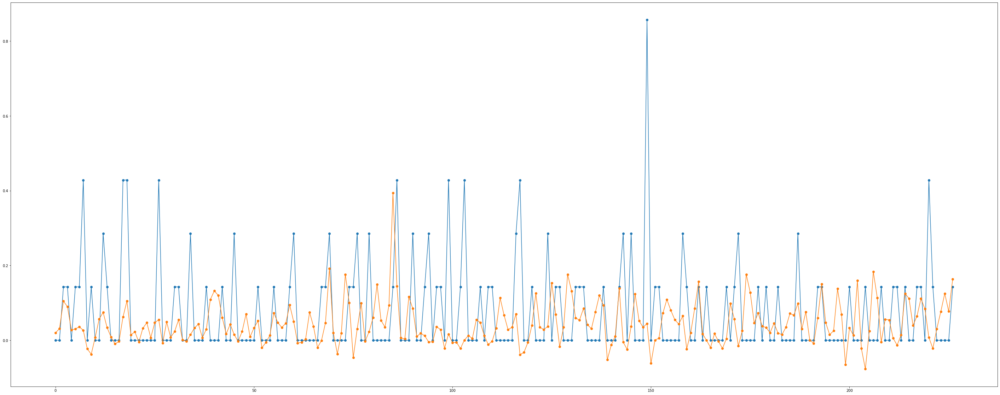

In [17]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### Increasing Dropout

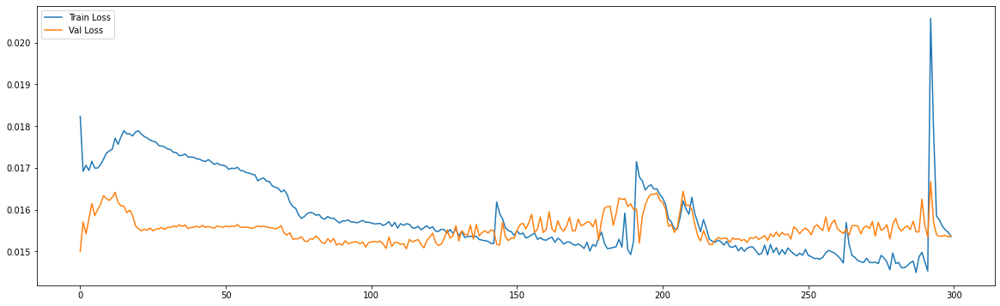

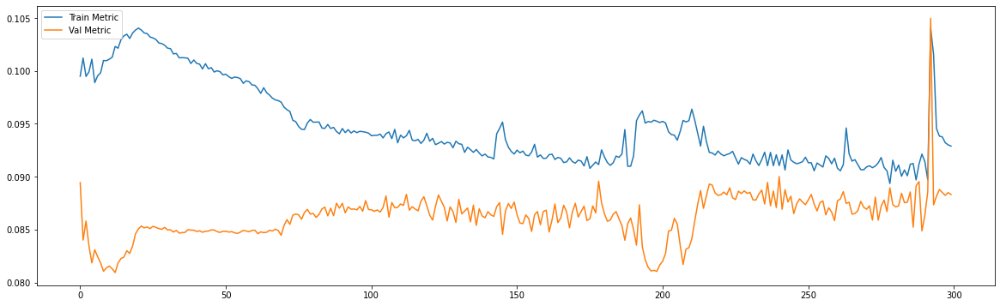



39/39 [==============================] - 0s 6ms/step - loss: 0.0155 - mae: 0.0861
loss and metric train data [0.015503003261983395, 0.08611197024583817]
8/8 [==============================] - 0s 5ms/step - loss: 0.0154 - mae: 0.0883
loss and metric val data [0.01537875272333622, 0.0883193090558052]
8/8 [==============================] - 0s 5ms/step - loss: 0.0109 - mae: 0.0746
loss and metric test data [0.010926605202257633, 0.0745825245976448]


In [18]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.4))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

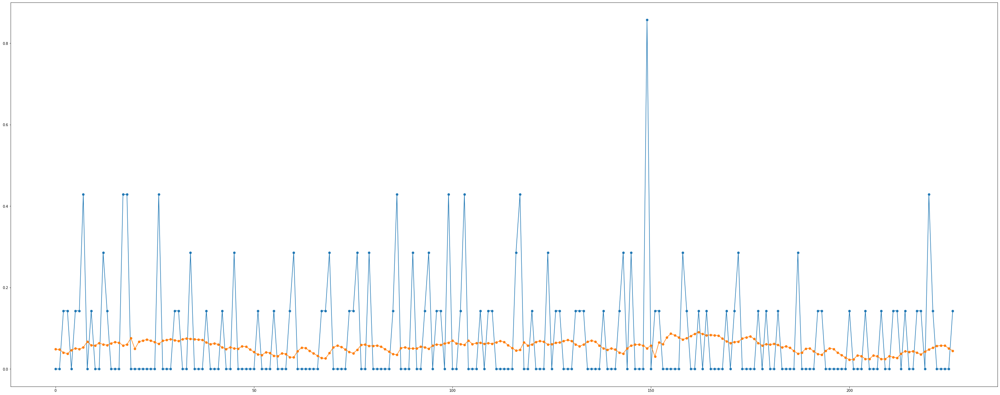

In [19]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### L2 regilarization with dropout

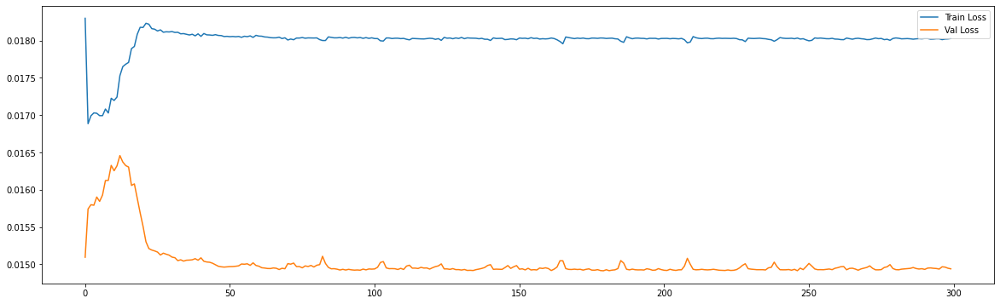

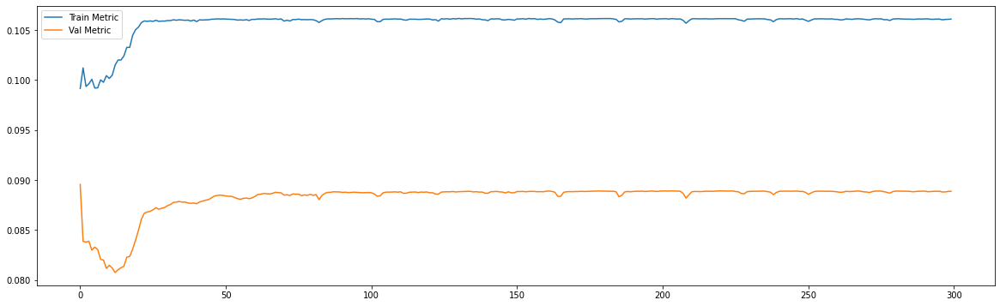



39/39 [==============================] - 0s 6ms/step - loss: 0.0173 - mae: 0.0966
loss and metric train data [0.017337189987301826, 0.09656085073947906]
8/8 [==============================] - 0s 5ms/step - loss: 0.0149 - mae: 0.0889
loss and metric val data [0.014940510503947735, 0.0888901948928833]
8/8 [==============================] - 0s 5ms/step - loss: 0.0105 - mae: 0.0810
loss and metric test data [0.010526145808398724, 0.08098049461841583]


In [20]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False,kernel_regularizer=regularizers.l2(0.0001), input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.2))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

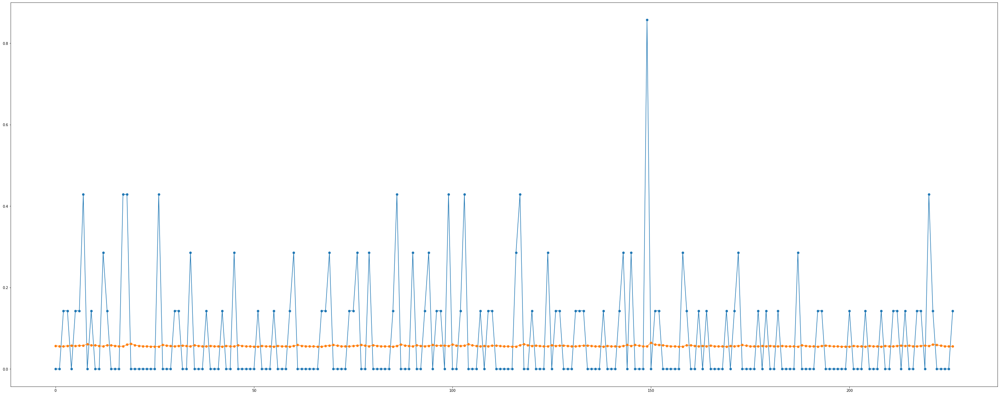

In [21]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

## Simplifying the model

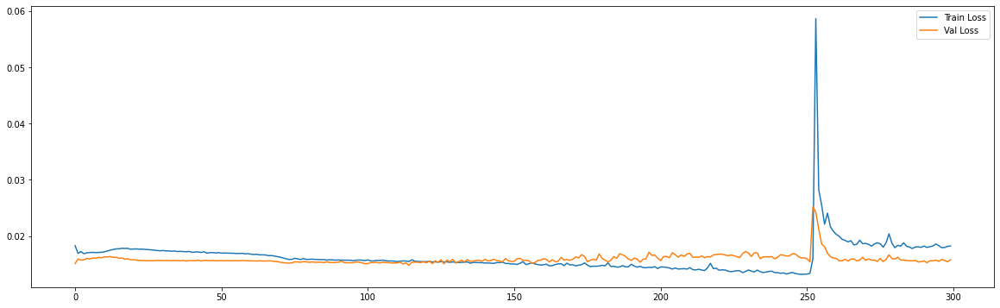

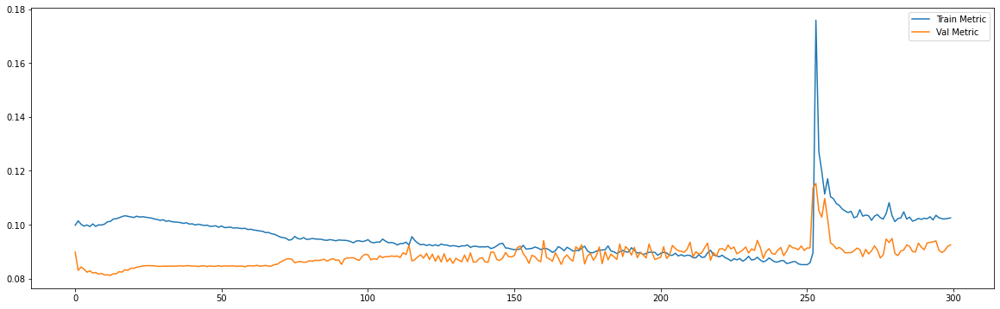



39/39 [==============================] - 0s 6ms/step - loss: 0.0183 - mae: 0.1021
loss and metric train data [0.0183482114225626, 0.10211453586816788]
8/8 [==============================] - 0s 5ms/step - loss: 0.0158 - mae: 0.0925
loss and metric val data [0.015778923407197, 0.09249251335859299]
8/8 [==============================] - 0s 5ms/step - loss: 0.0120 - mae: 0.0869
loss and metric test data [0.011962125077843666, 0.0868549570441246]


In [22]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=40, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.2))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

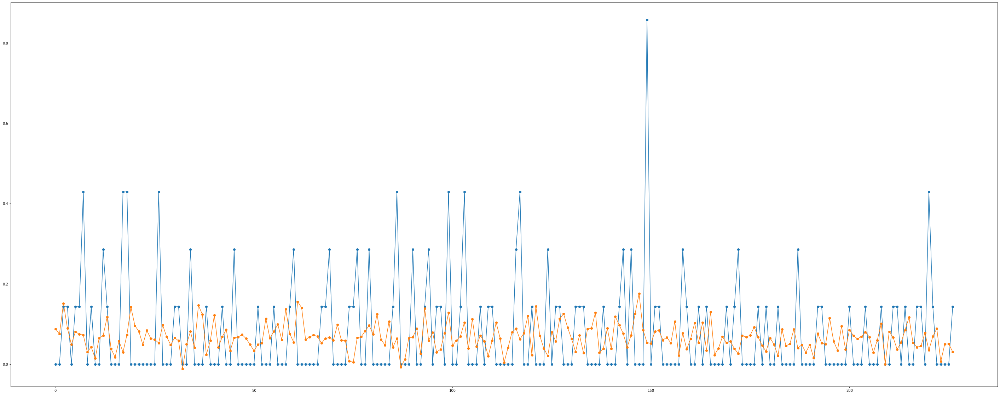

In [23]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### Increasing the dropout

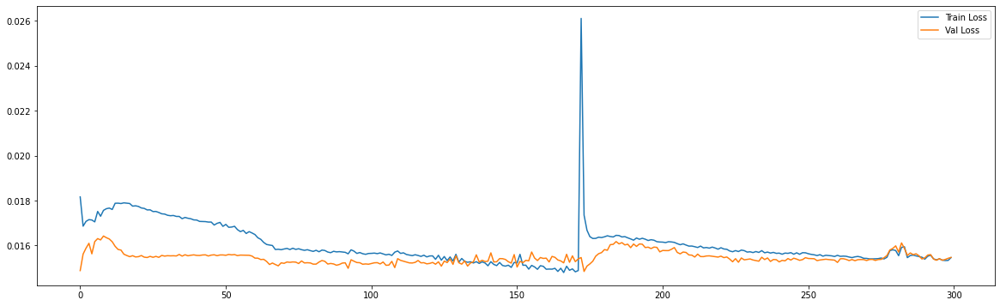

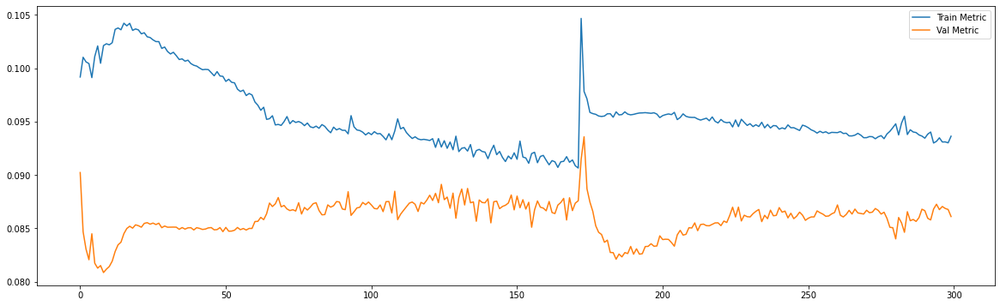



39/39 [==============================] - 0s 5ms/step - loss: 0.0153 - mae: 0.0891
loss and metric train data [0.015282109379768372, 0.0890686959028244]
8/8 [==============================] - 0s 5ms/step - loss: 0.0155 - mae: 0.0861
loss and metric val data [0.015471805818378925, 0.0860992968082428]
8/8 [==============================] - 0s 5ms/step - loss: 0.0109 - mae: 0.0763
loss and metric test data [0.010867218486964703, 0.07630681991577148]


In [24]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=40, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.4))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

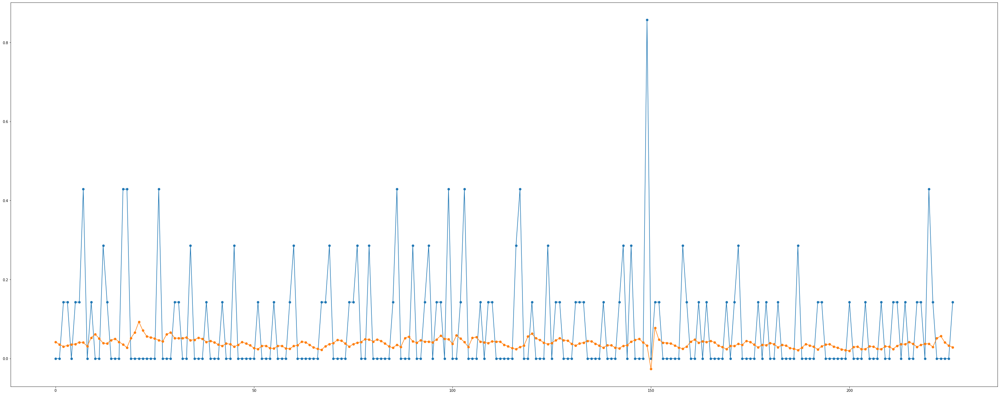

In [25]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

## Last chance... 

============================model:0===========================


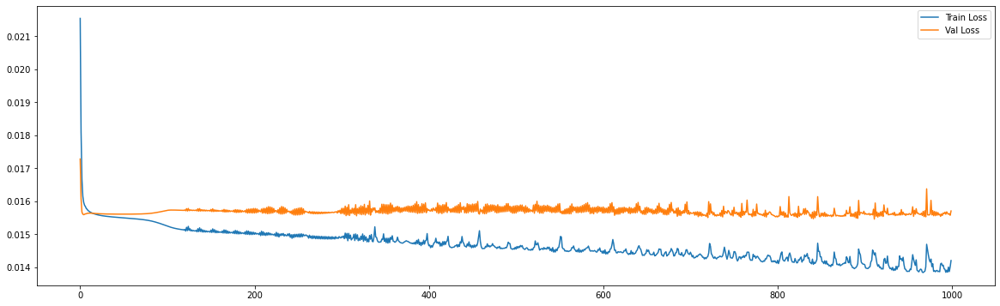

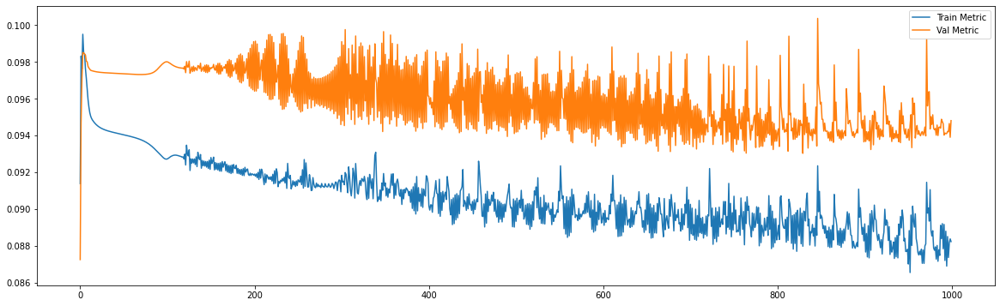

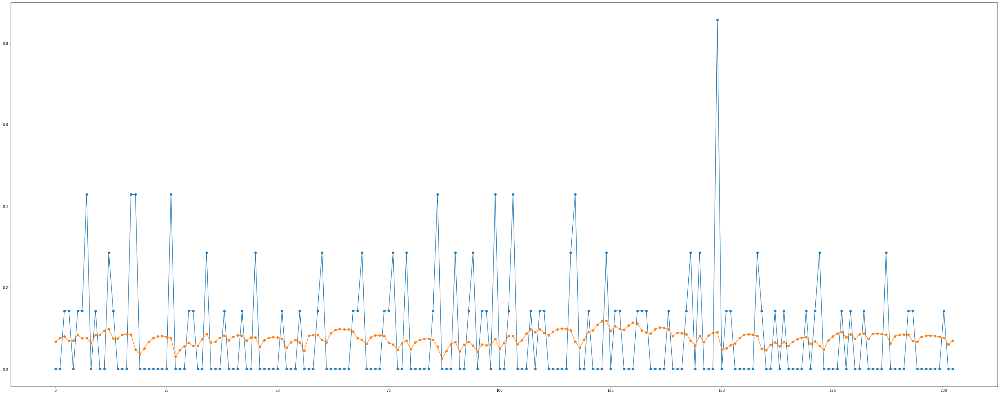

============================model:1===========================


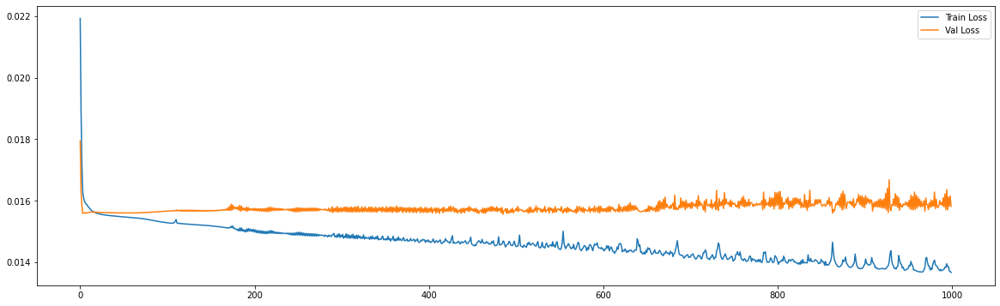

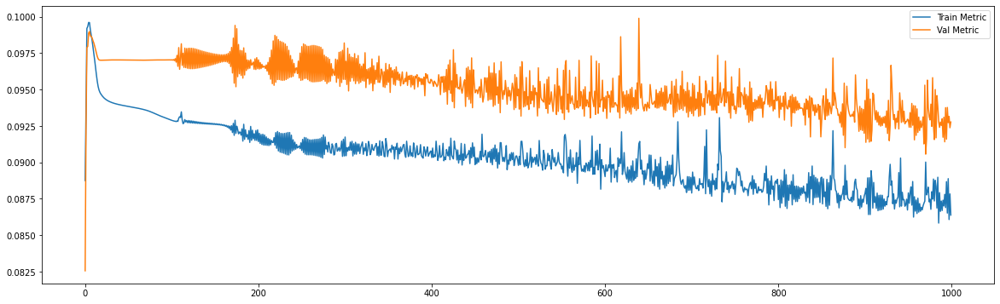

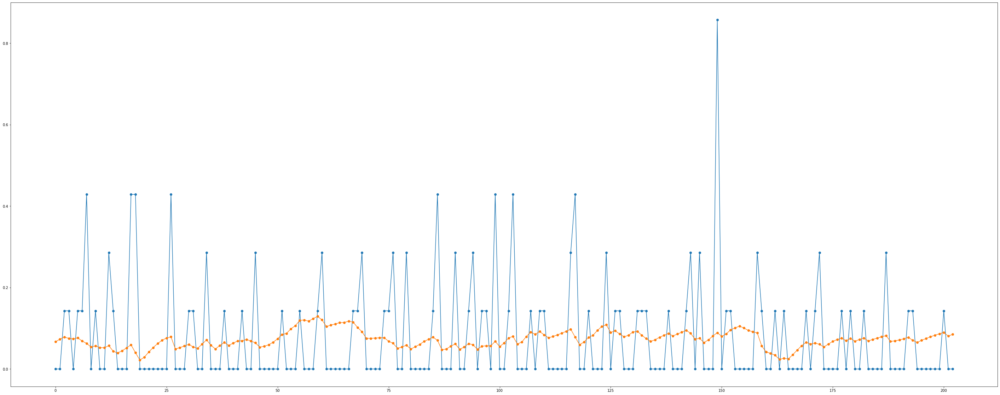

============================model:2===========================


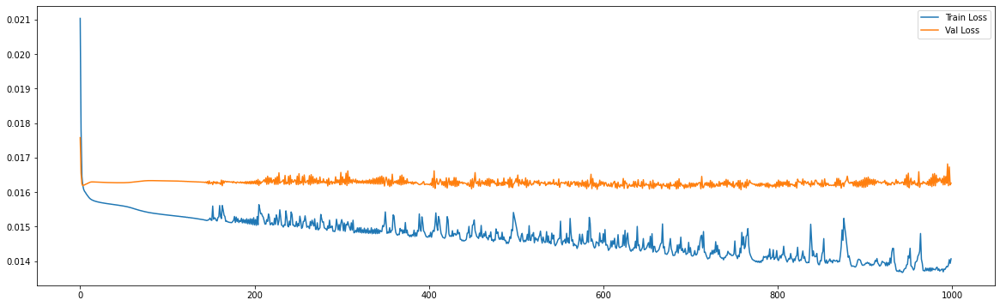

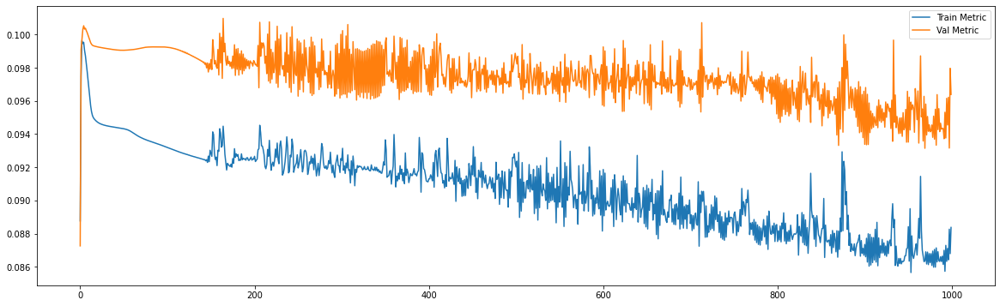

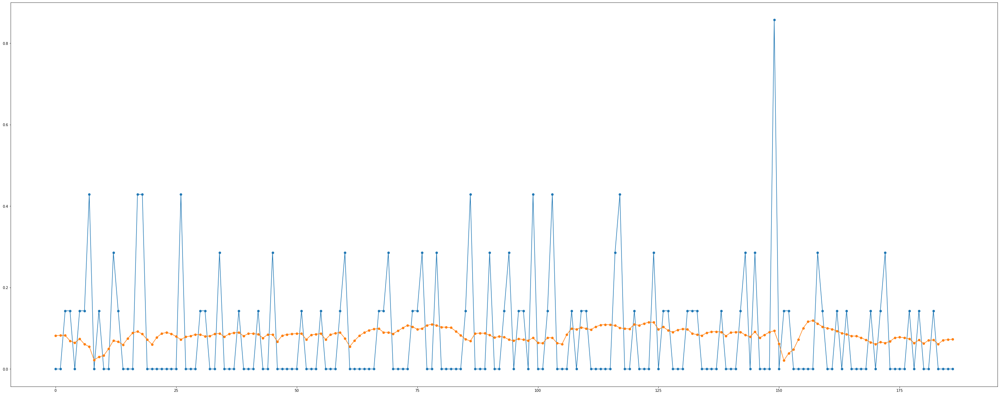

============================model:3===========================


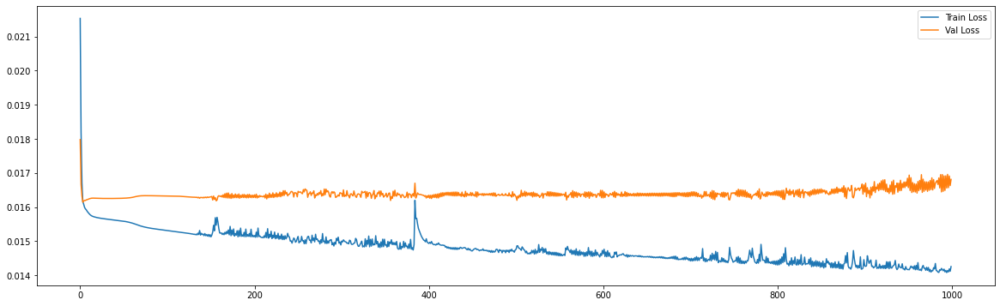

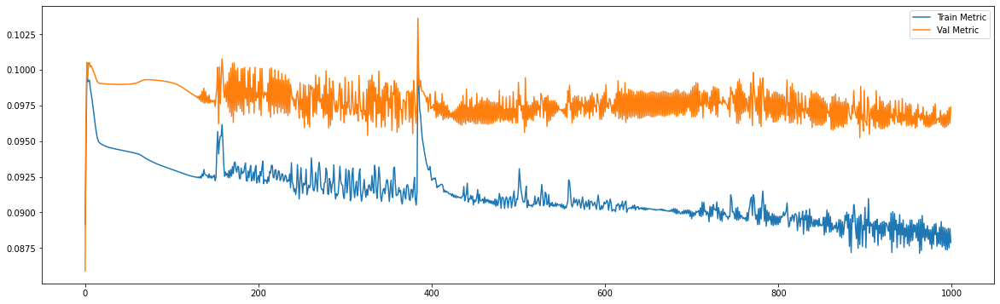

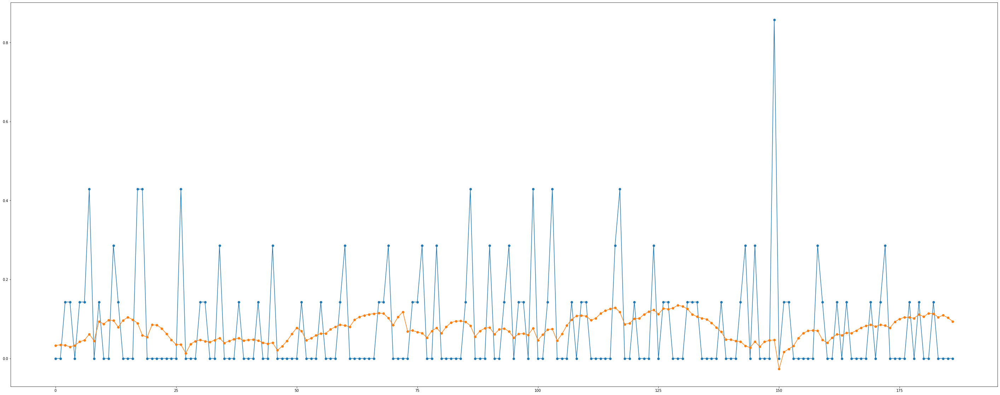

============================model:4===========================


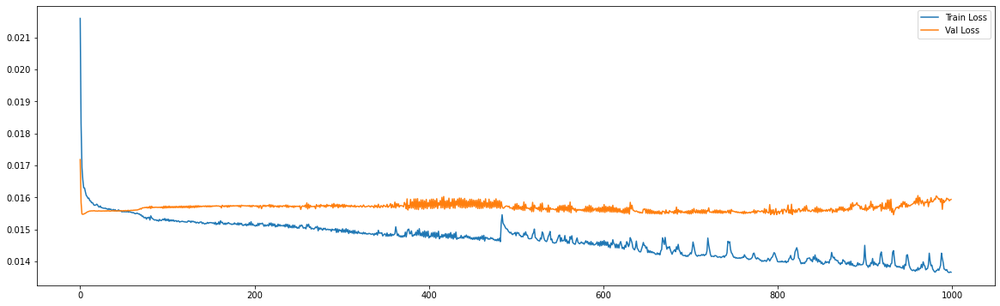

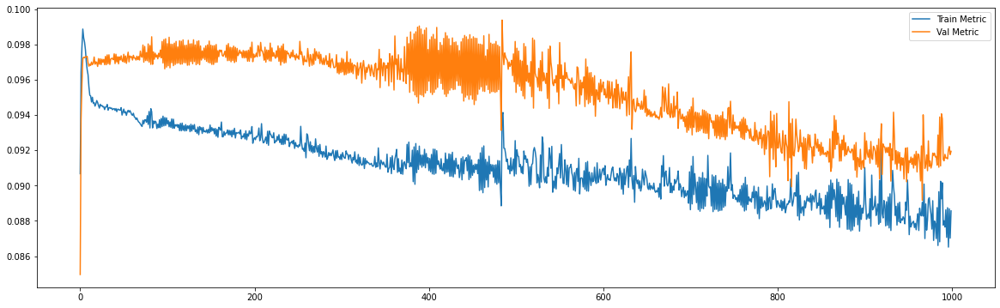

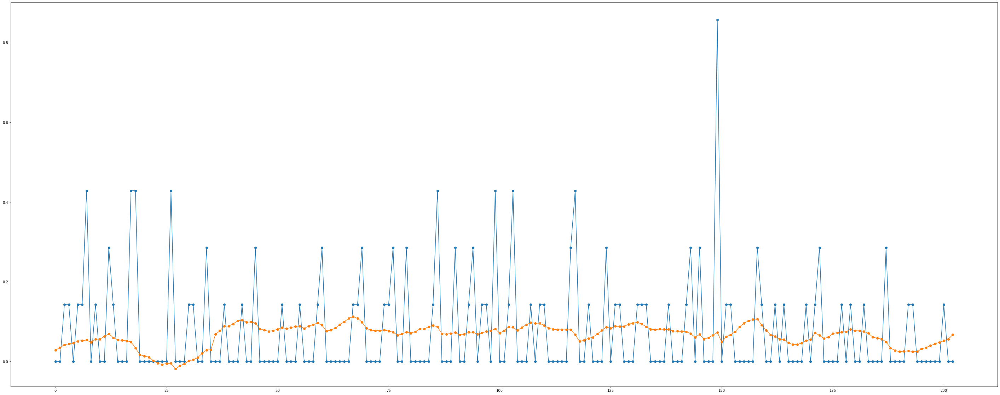

============================model:5===========================


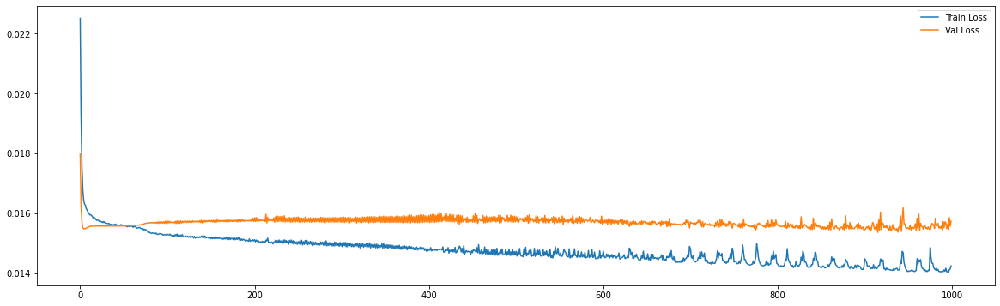

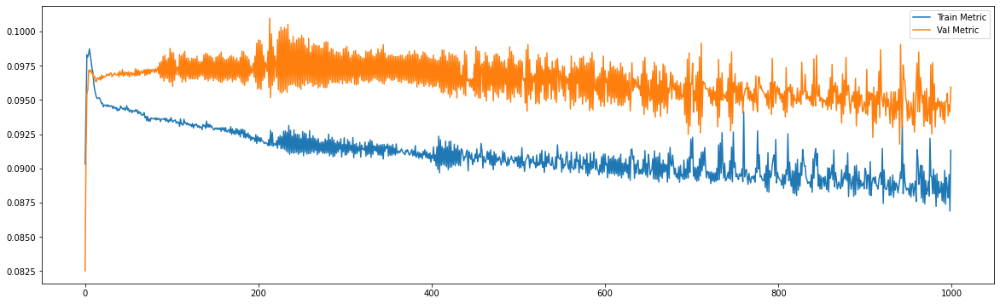

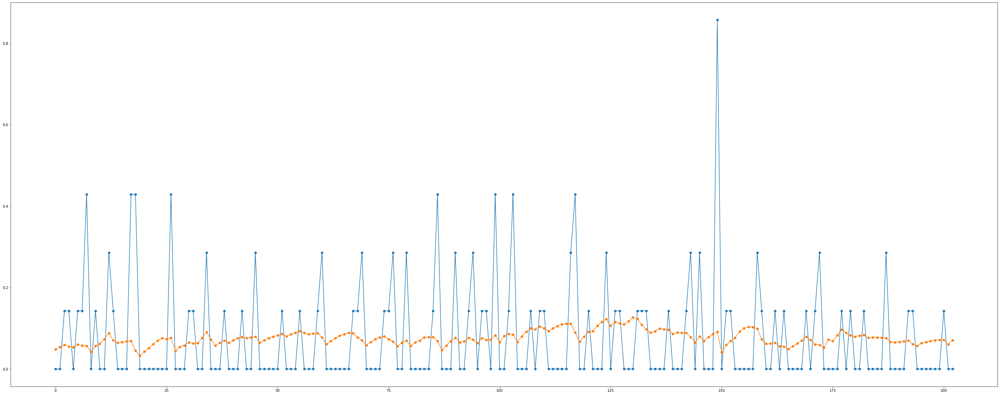

============================model:6===========================


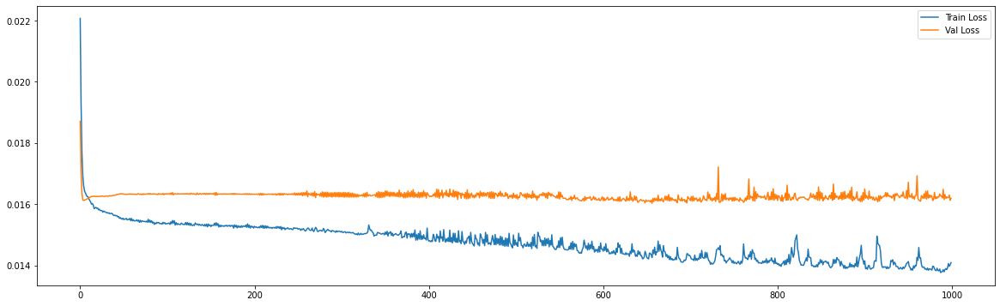

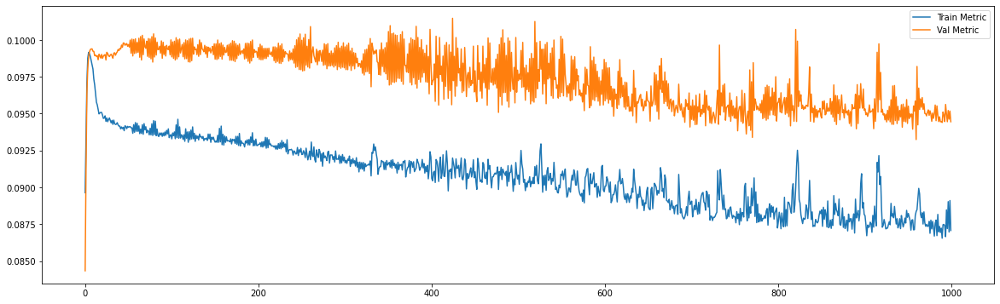

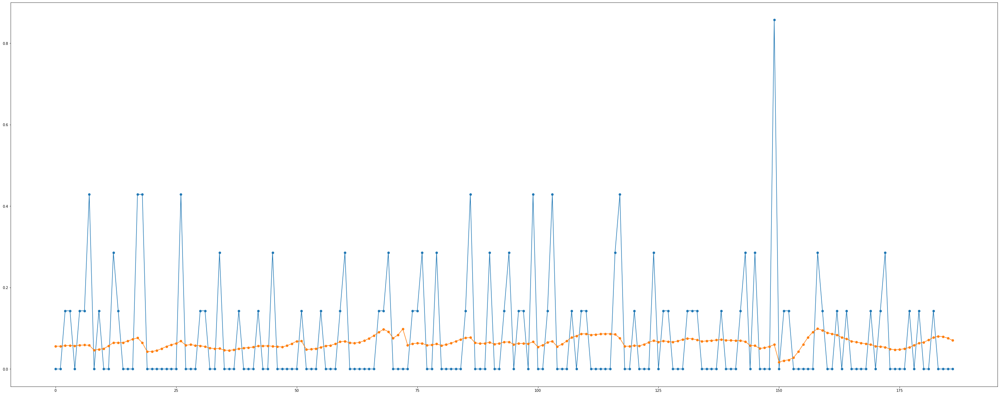

============================model:7===========================


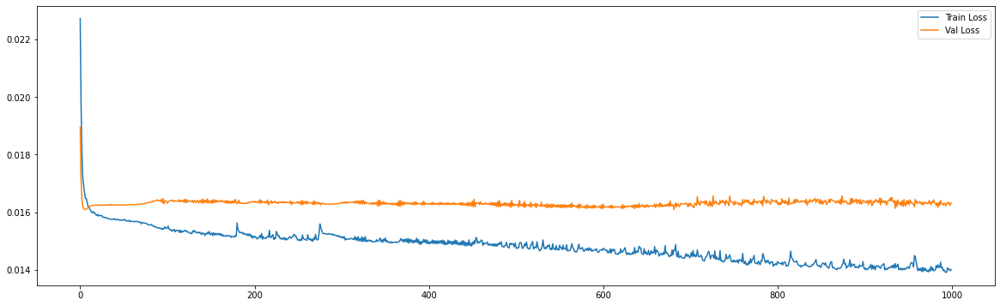

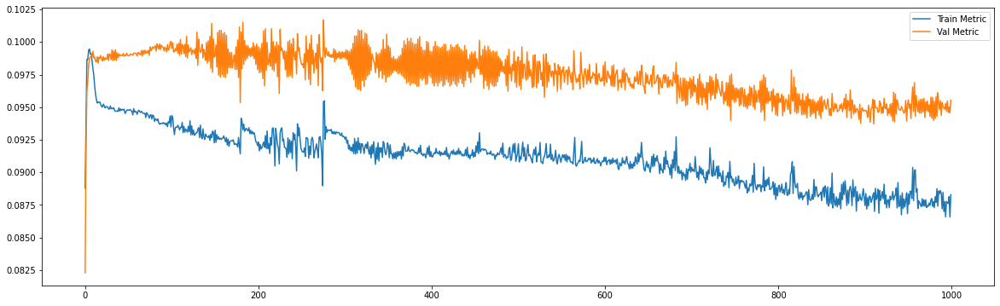

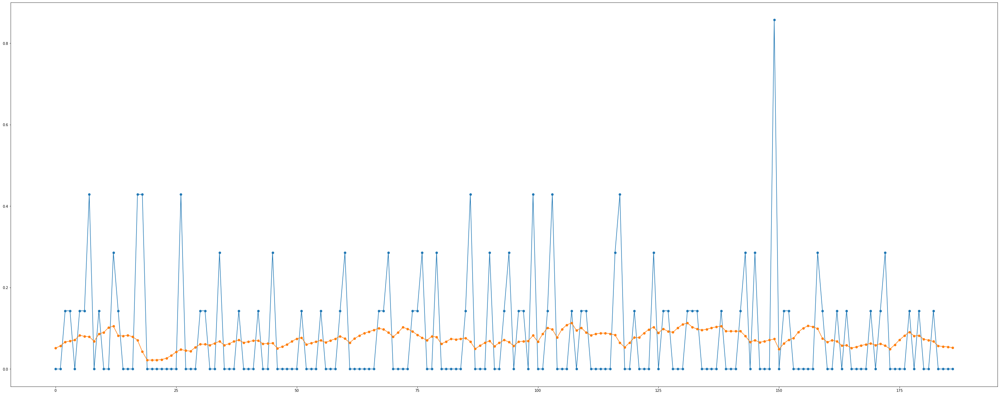

============================model:8===========================


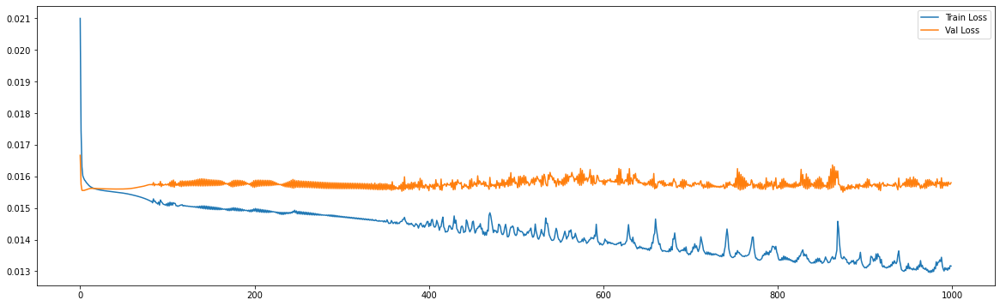

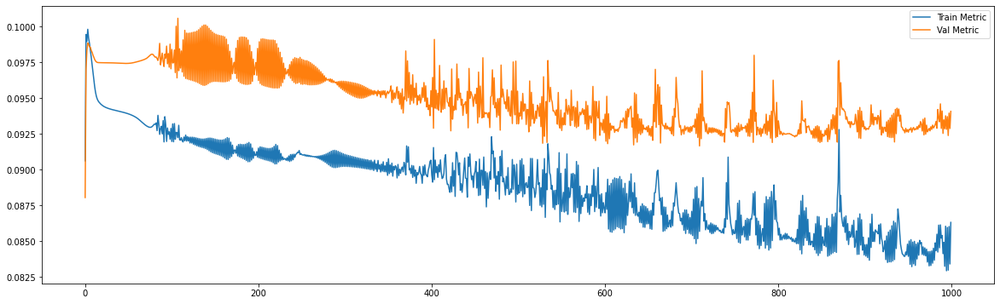

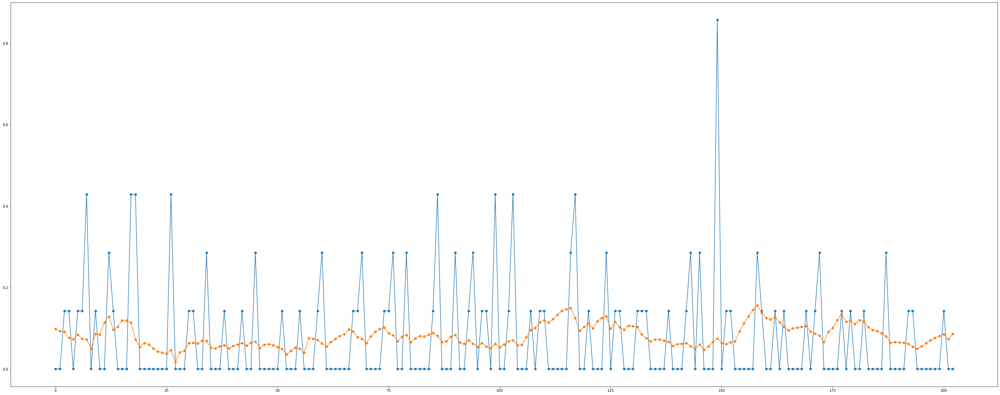

============================model:9===========================


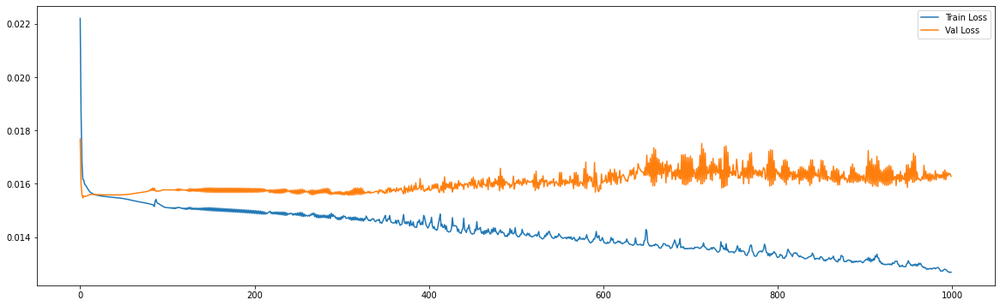

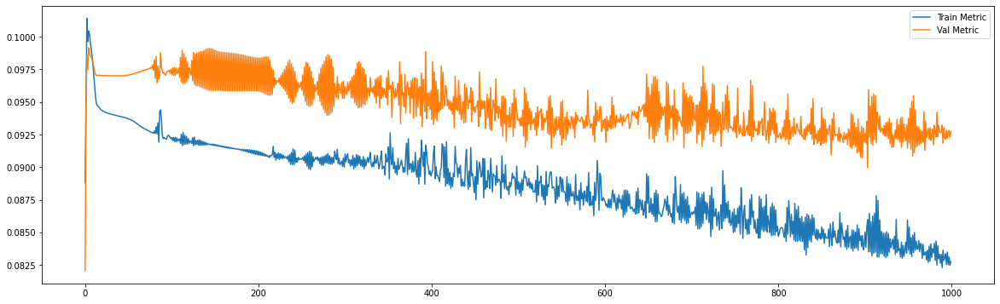

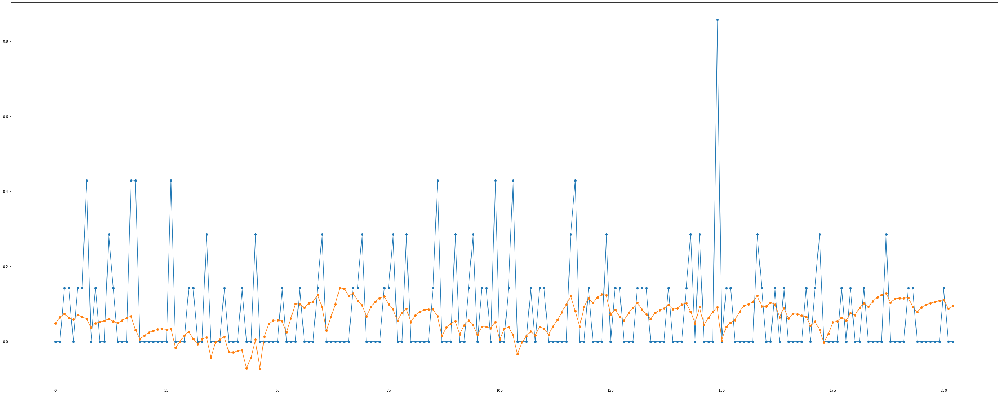

============================model:10===========================


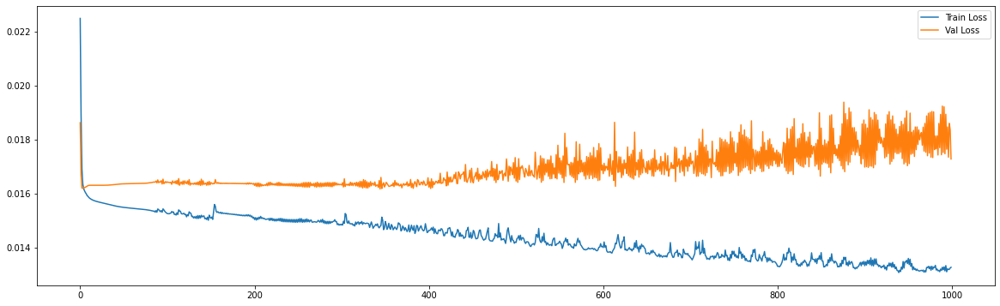

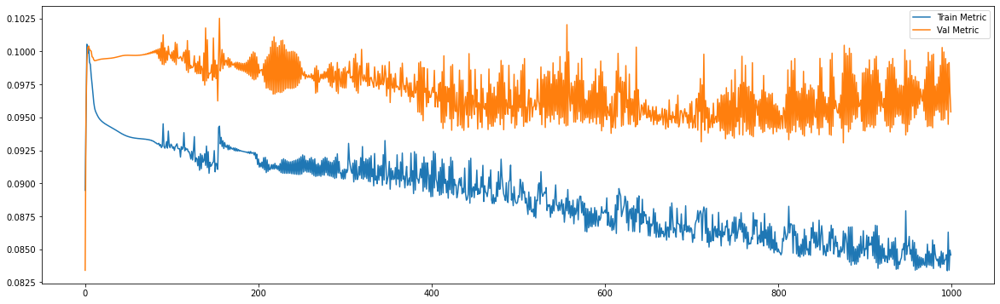

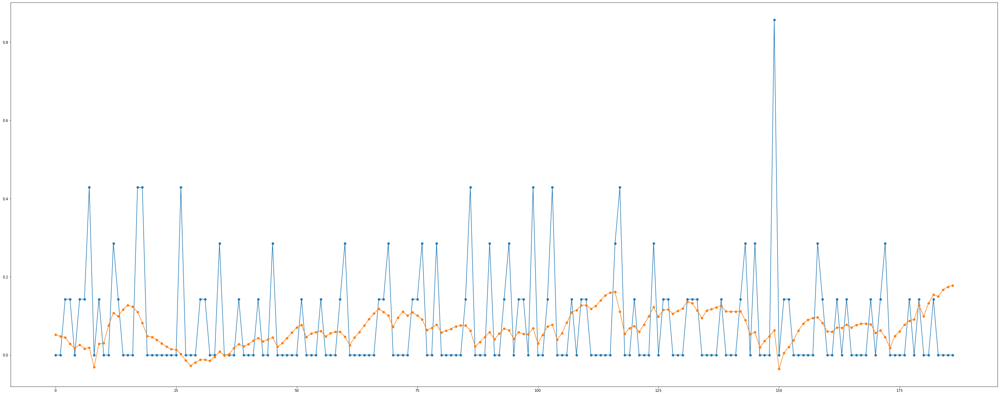

============================model:11===========================


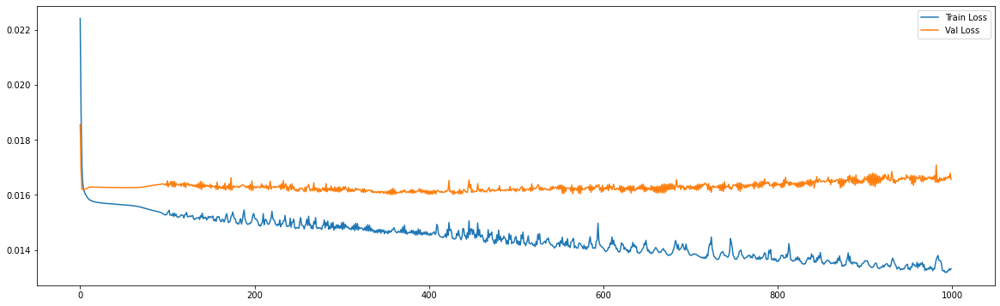

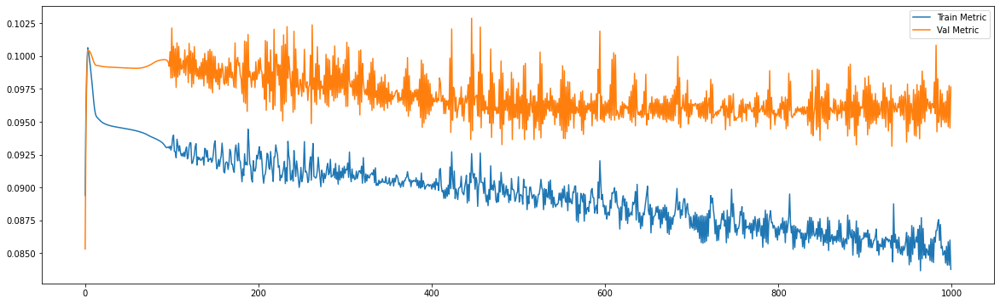

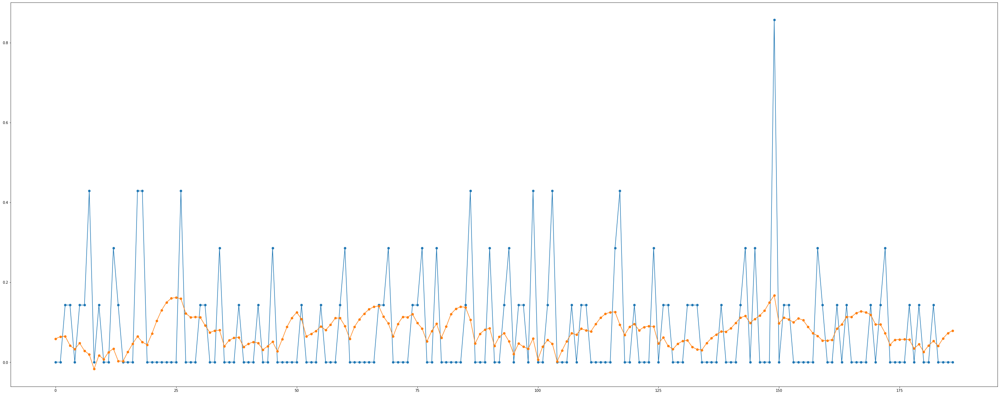

============================model:12===========================


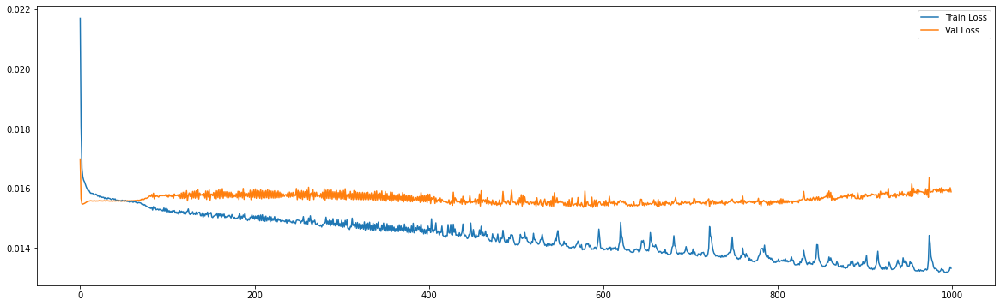

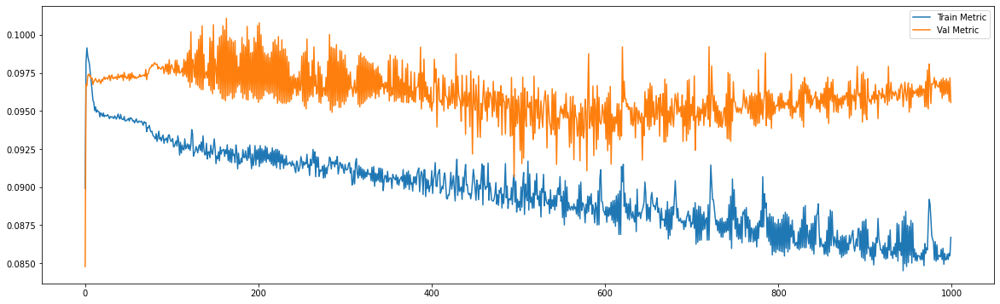

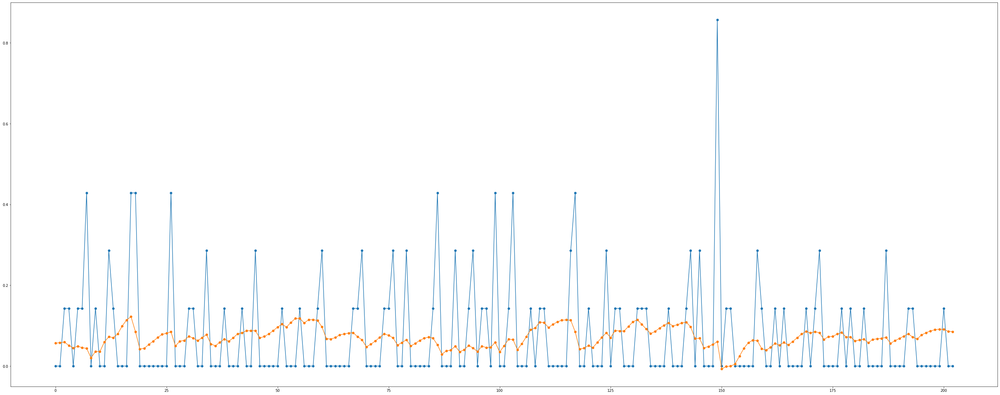

============================model:13===========================


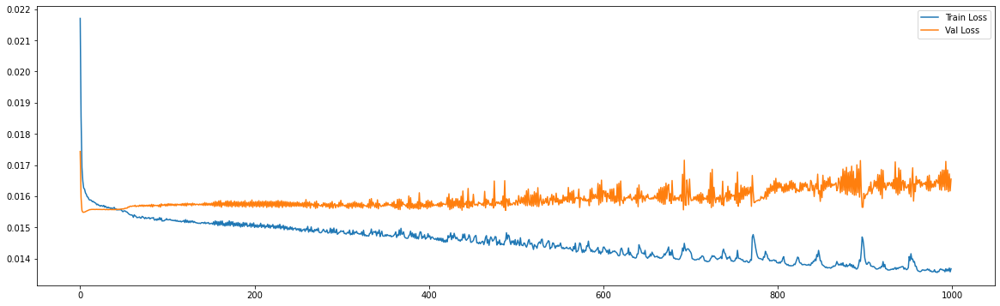

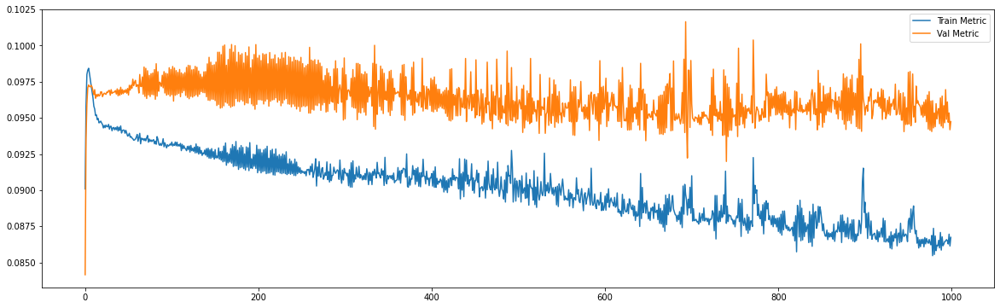

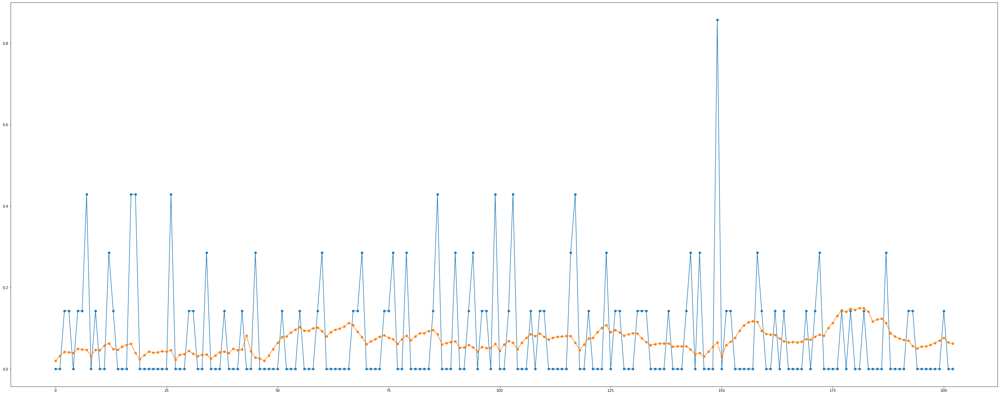

============================model:14===========================


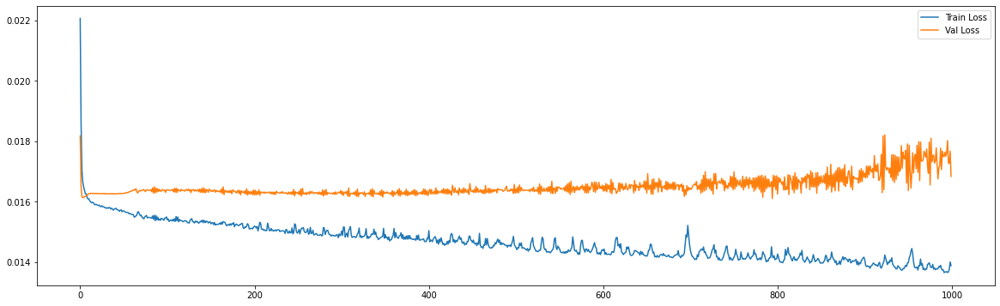

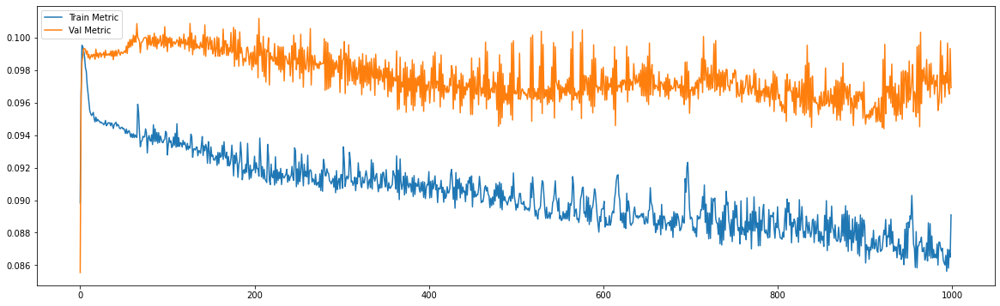

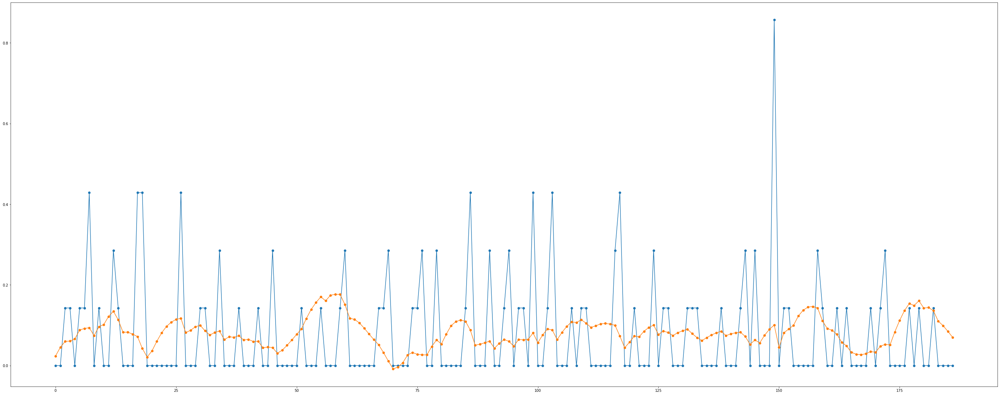

============================model:15===========================


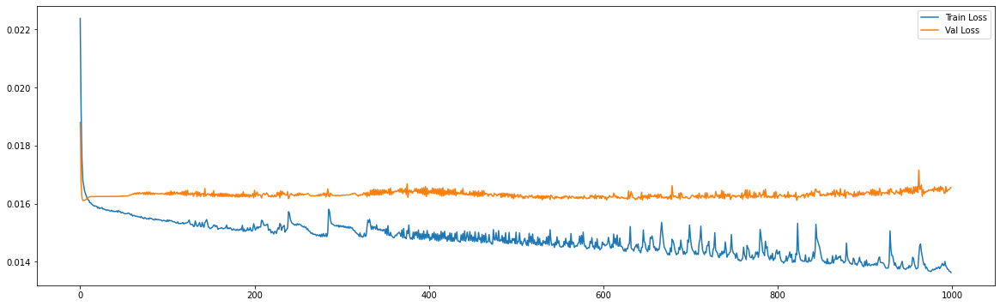

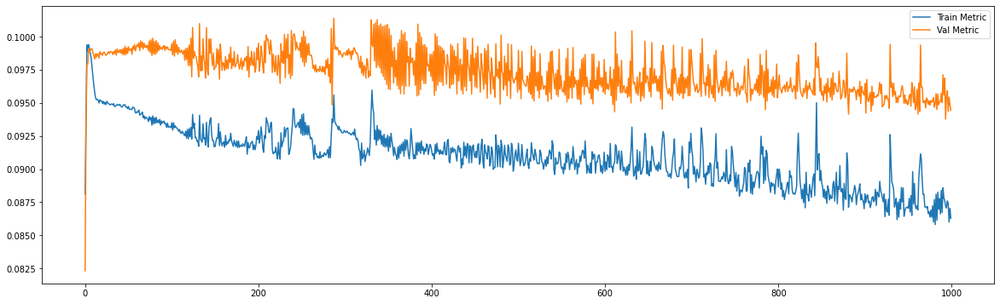

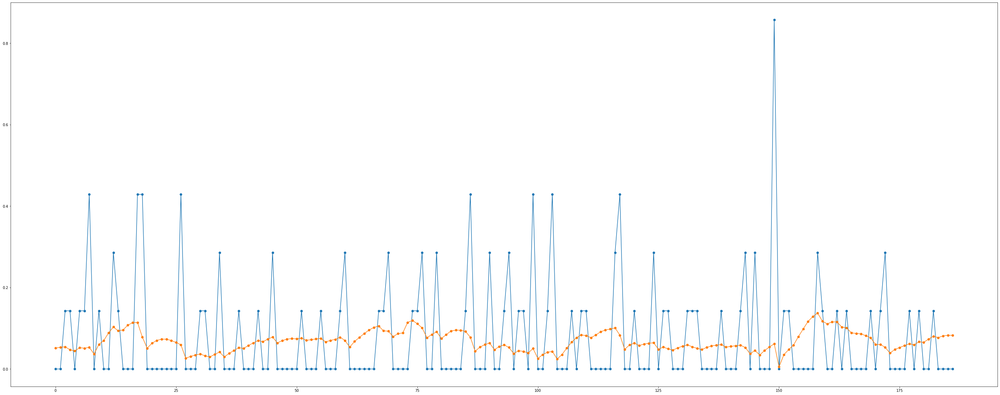

============================model:16===========================


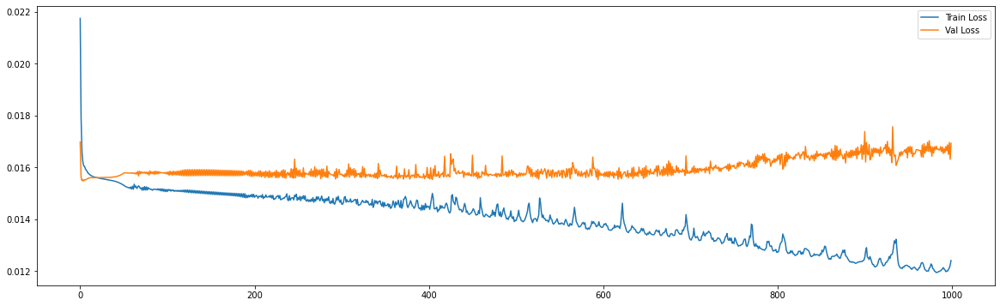

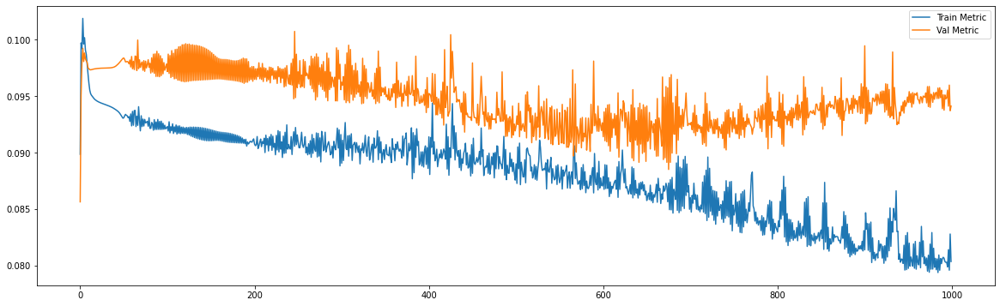

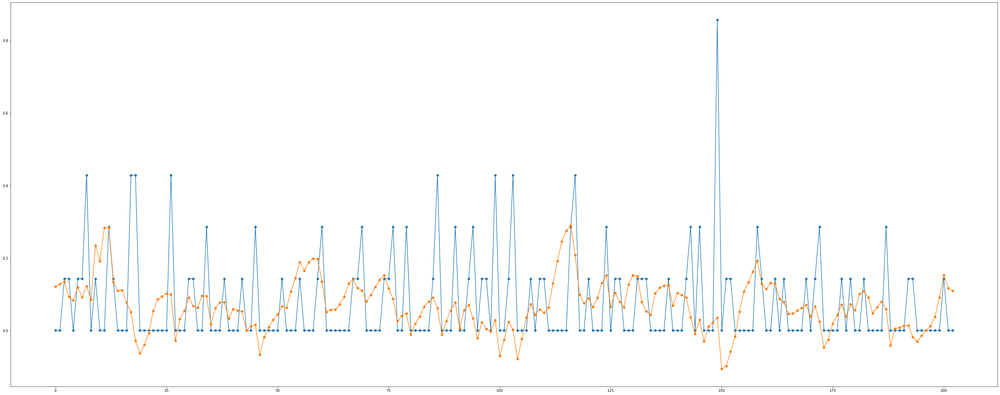

============================model:17===========================


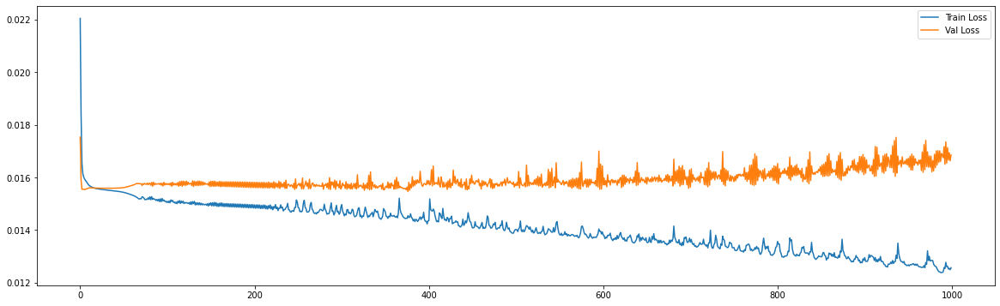

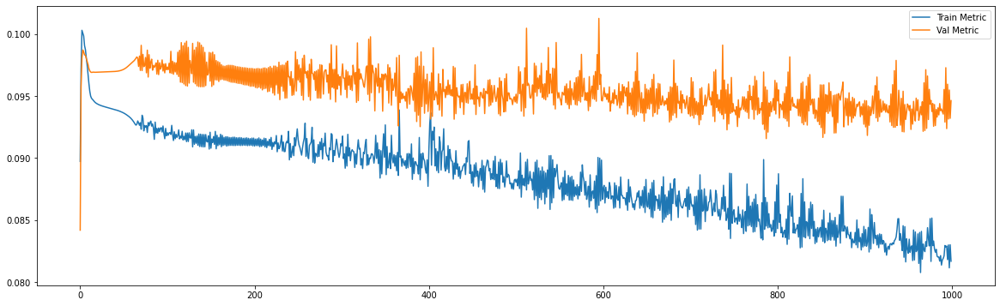

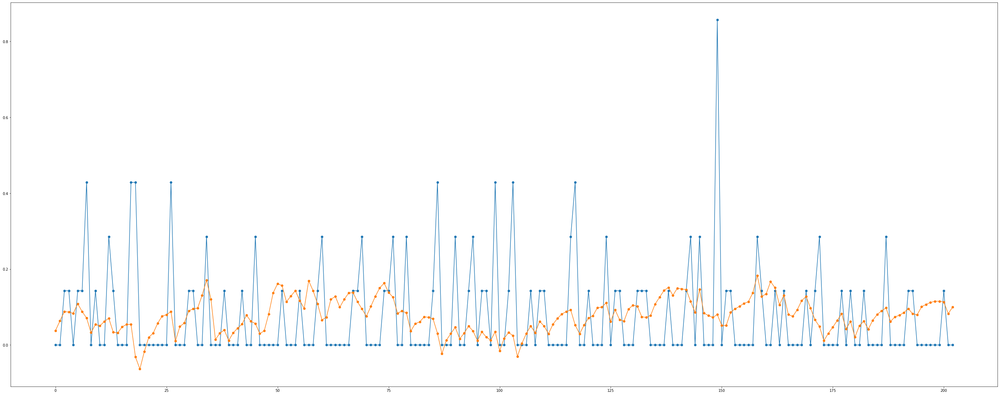

============================model:18===========================


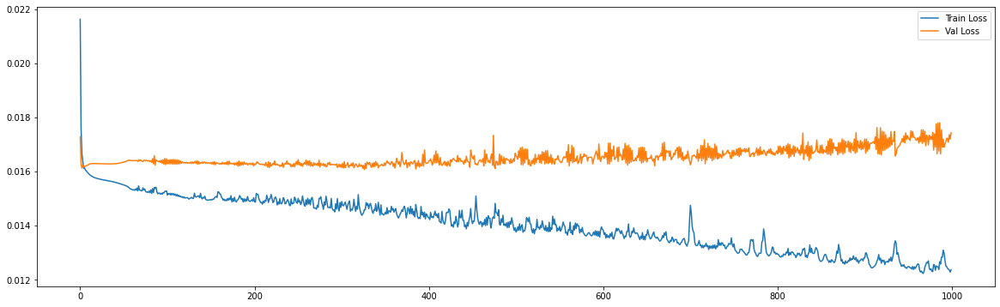

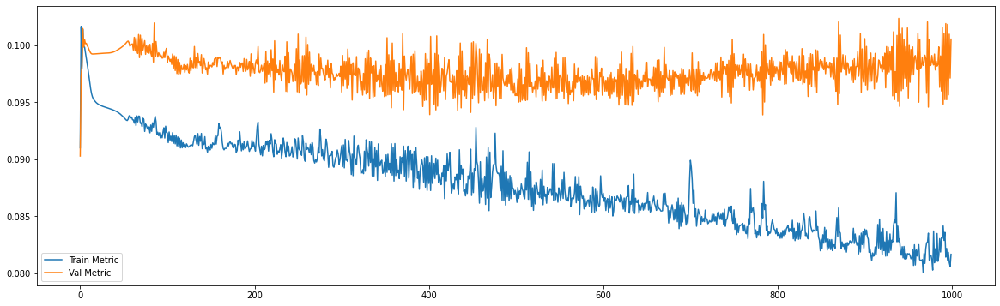

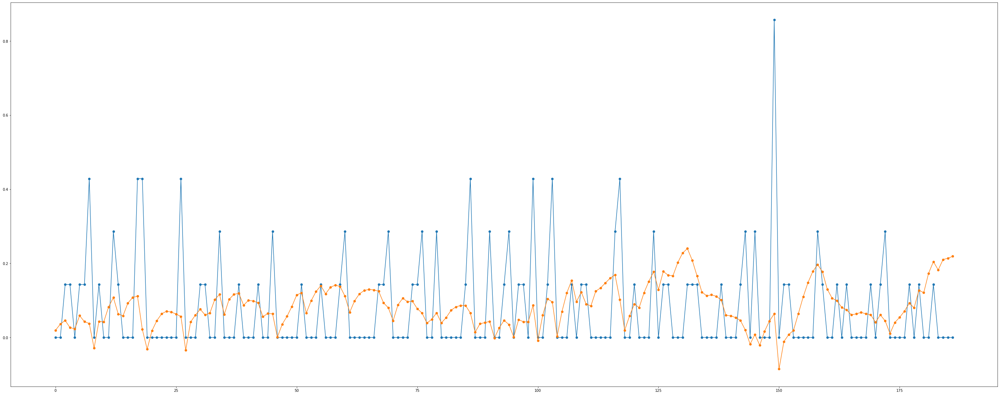

============================model:19===========================


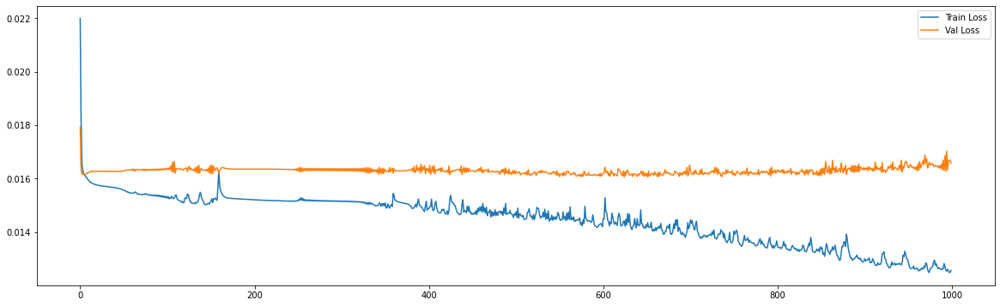

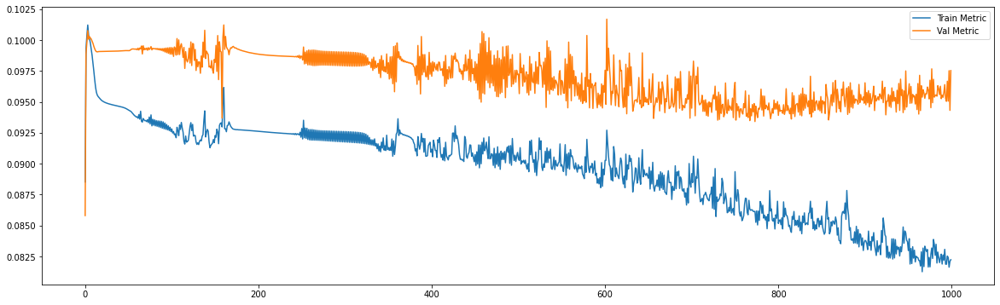

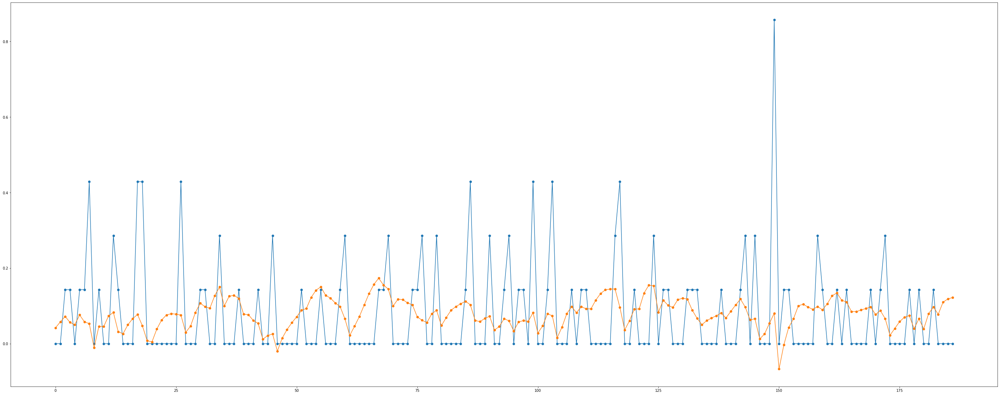

============================model:20===========================


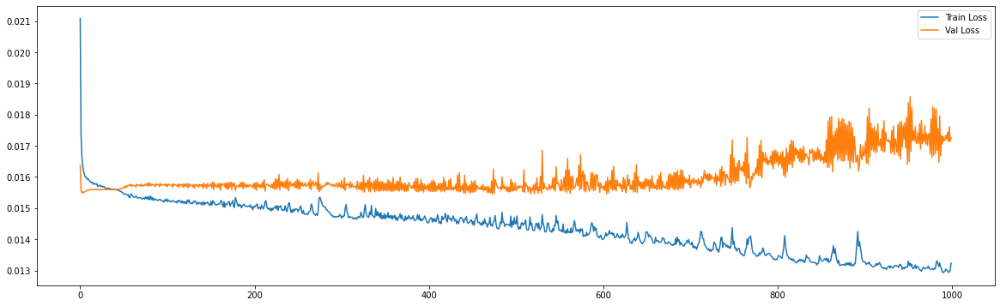

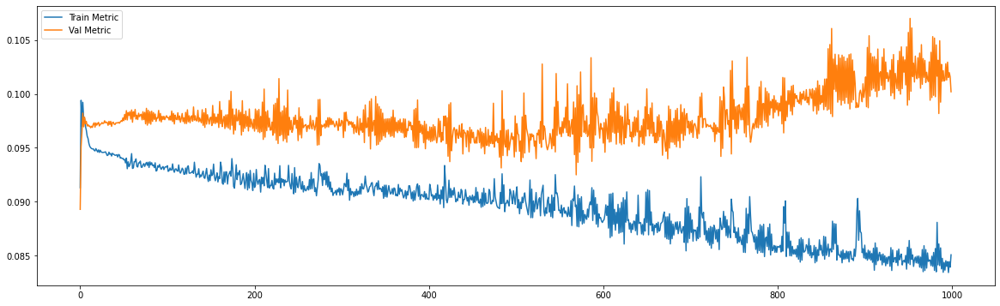

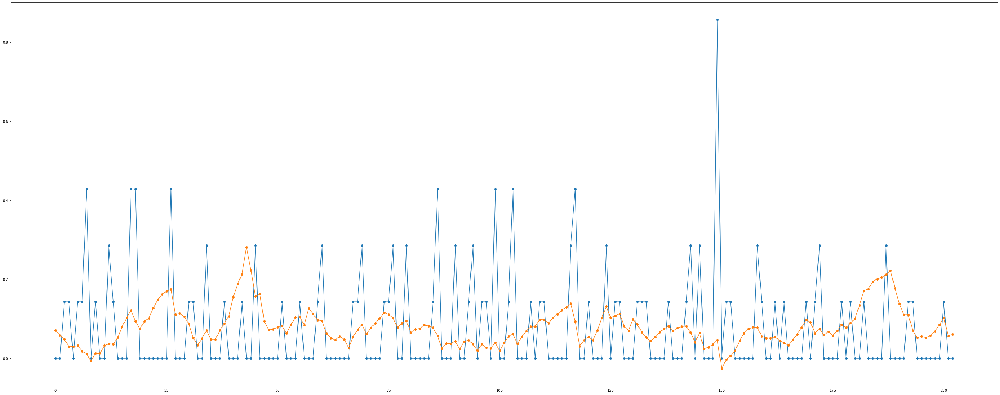

============================model:21===========================


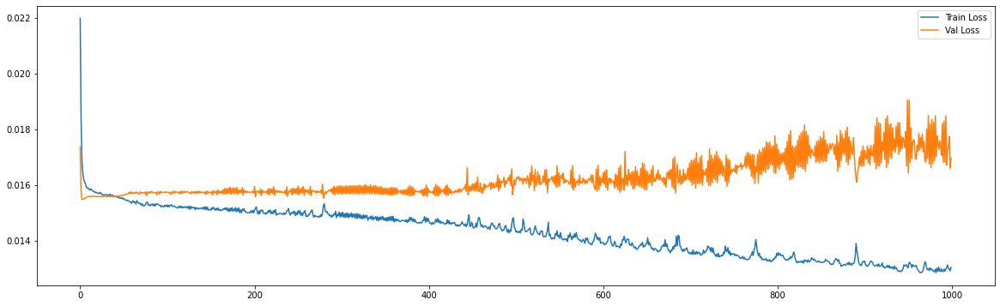

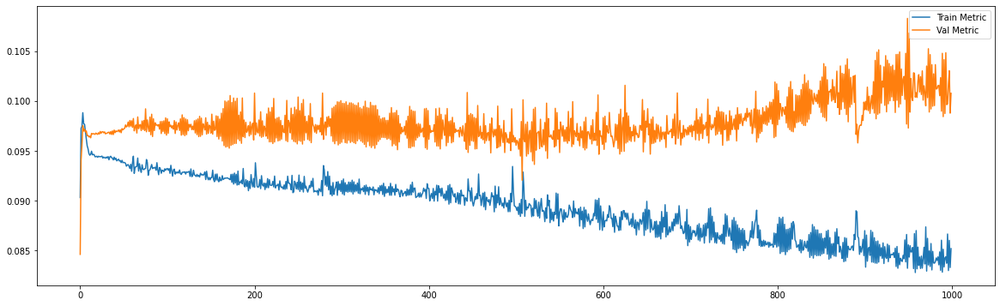

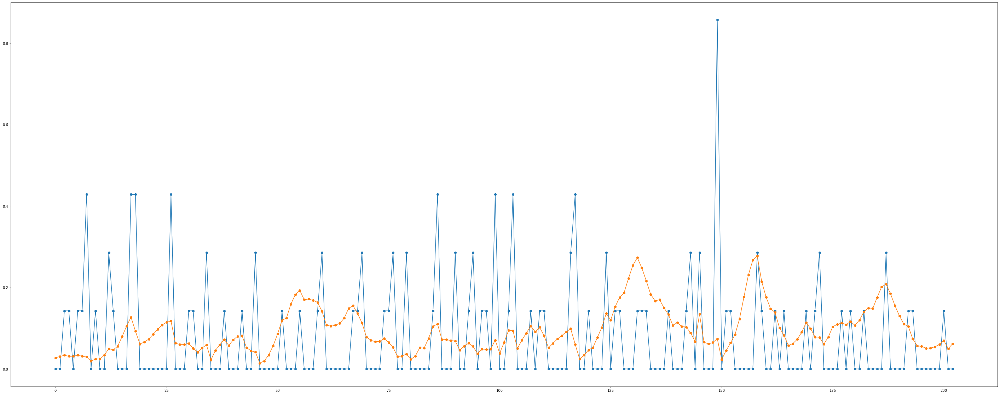

============================model:22===========================


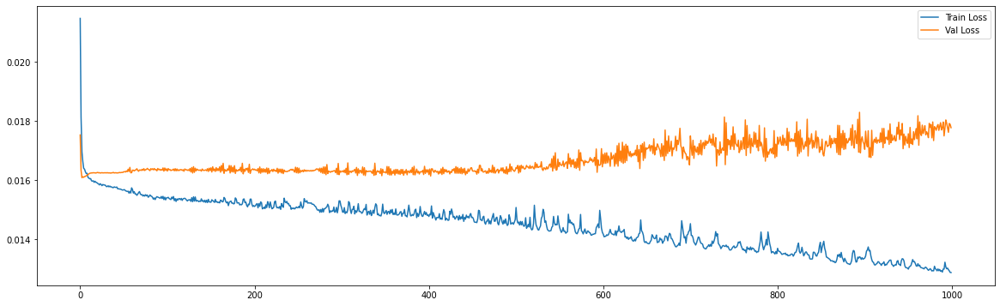

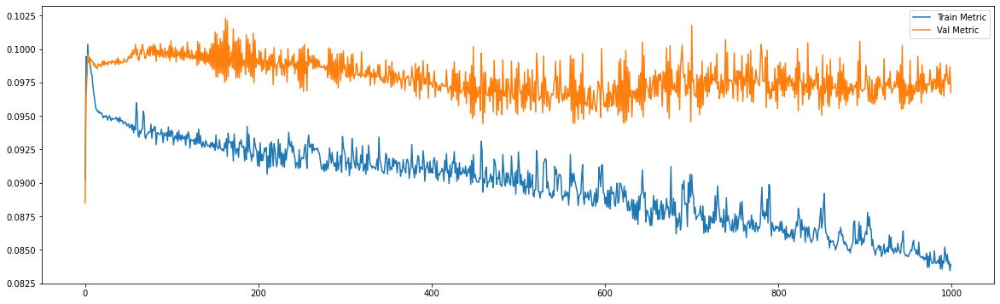

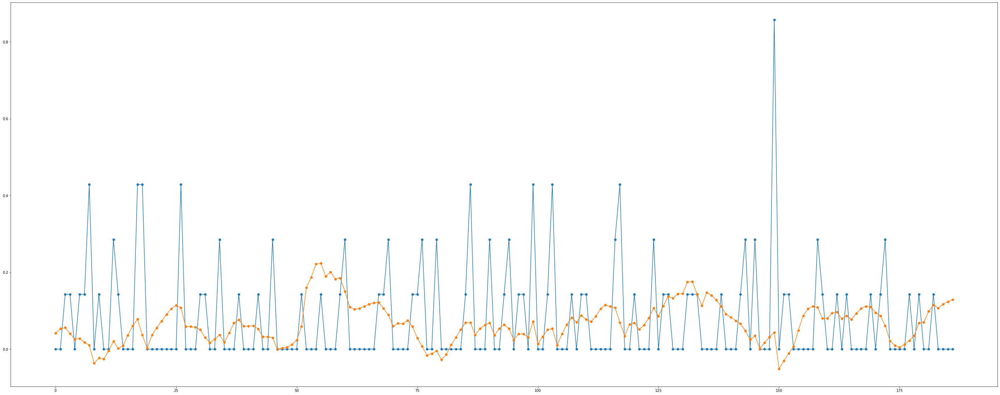

============================model:23===========================


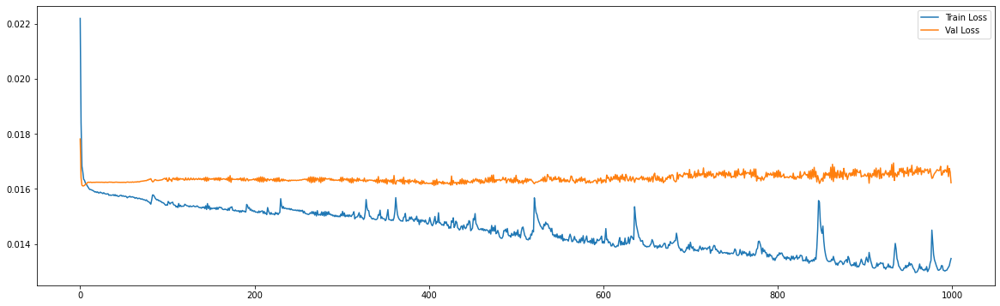

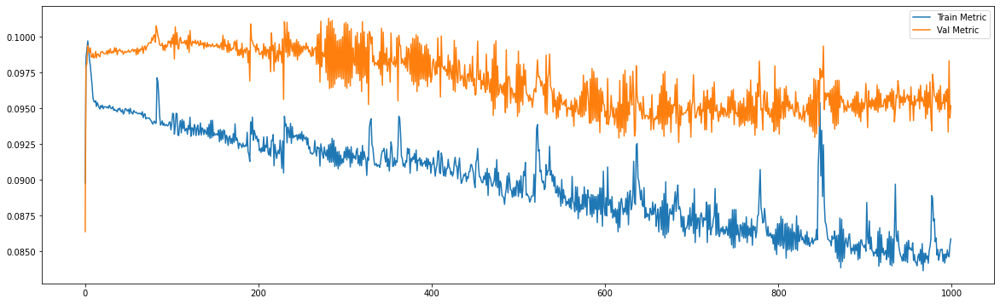

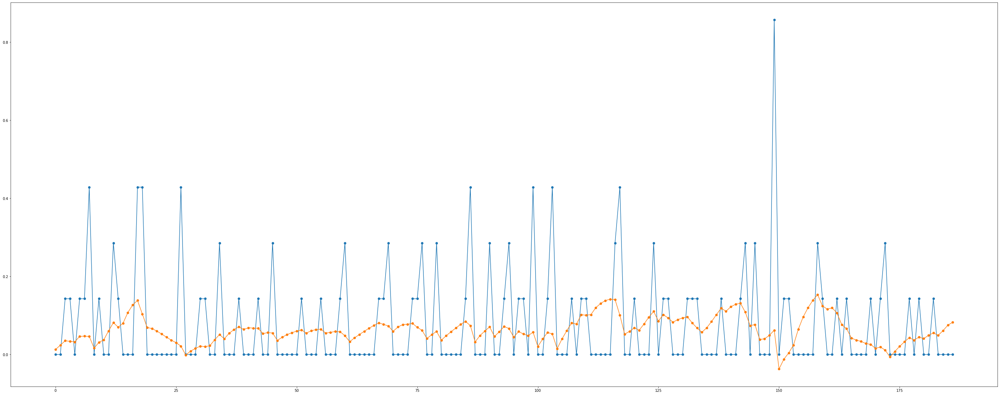

In [26]:
future_steps = 28
n_features = 1

neurons_list = [30,40,50]
dropout_list = [0.0,0.2]
time_steps_list = [84,100]
bach_list = [84,100]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch in bach_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_food_train,df_val = df_food_val,df_test = df_food_test)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}".format(neurons,dropout,time_steps,batch)

        # The LSTM architecture
        models[i] = Sequential()
        models[i].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i].add(Dropout(dropout))
        models[i].add(Dense(units=28))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        #Fitting to traning set
        history = models[i].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=batch, verbose = 0, shuffle= False)

        print('============================model:{}==========================='.format(i))
        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        y_val_pred = models[i].predict(x_val)
        plt.figure(figsize=(50,20))
        plt.plot(y_val[:,0],marker='o')
        plt.plot(y_val_pred[:,0],marker='o')
        plt.show()

        i+=1

# Changing pre-processing

In the attempts above, doesn't matter how much I increase the regularization 
methods the network doesn't generalise.

---

Now I'll try to make an outlier treatment to improve generalization. 

In [0]:
dataset = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/sales_train_validation.csv')

In [28]:
group = dataset.groupby(['state_id','cat_id']).first()
df_food =  group.loc[('WI','FOODS'),'d_1':]
del group

train_limit = int(round((df_food.shape[0])*0.7,0))
val_limit = int(round((df_food.shape[0])*0.85,0))

df_food_train = df_food[:train_limit]
df_food_val = df_food[train_limit:val_limit]
df_food_test = df_food[val_limit:]

print(df_food_test.shape)

(287,)


## To detect outliers lets see the quantiles of 0.8, 0.9 and 0.95 

--- 

The values doesn't fluctuate to much at the distibution, let's impose a maximum value of 2.

In [29]:
print(df_food_train.quantile(q = 0.8))
print(df_food_train.quantile(q = 0.9))
print(df_food_train.quantile(q = 0.95))

1.0
2.0
2.0


In [0]:
df_food_train[df_food_train > df_food_train.quantile(q = 0.9)] = int(df_food_train.quantile(q = 0.9))

## Normalizing

In [0]:
df_food_train = df_food_train.values.reshape(-1,1)
df_food_val = df_food_val.values.reshape(-1,1)
df_food_test = df_food_test.values.reshape(-1,1)

scaler_food = MinMaxScaler(feature_range=(0,1))
df_food_train = scaler_food.fit_transform(df_food_train)
df_food_val = scaler_food.transform(df_food_val)
df_food_test = scaler_food.transform(df_food_test)

## Regressor

with the most promissing model, 

============================model:0===========================


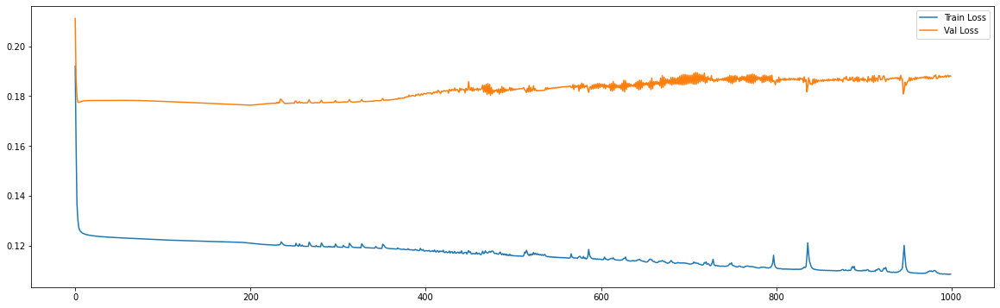

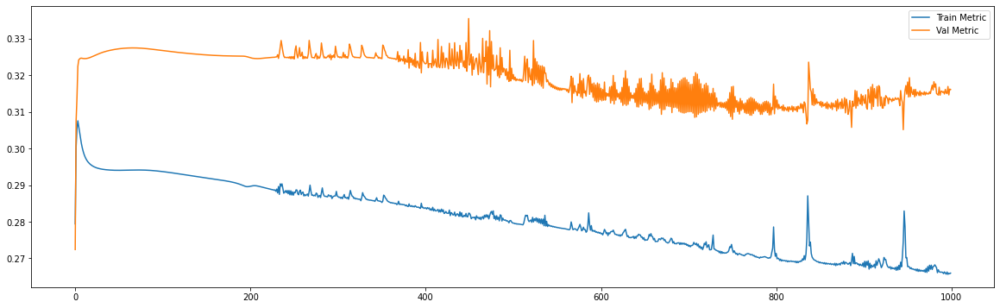

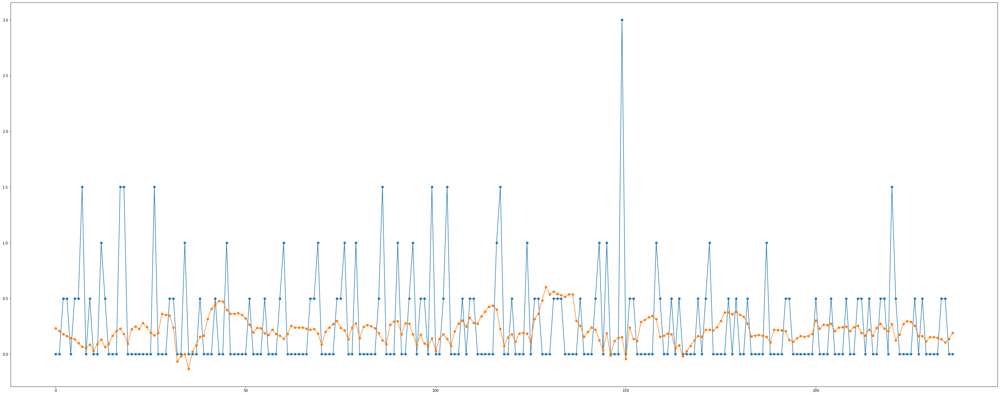

============================model:1===========================


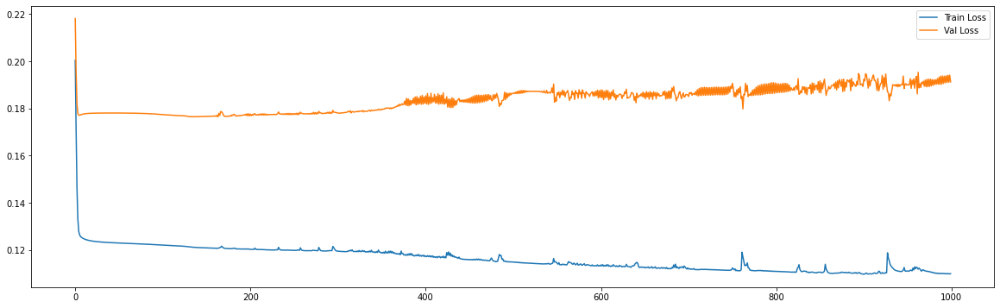

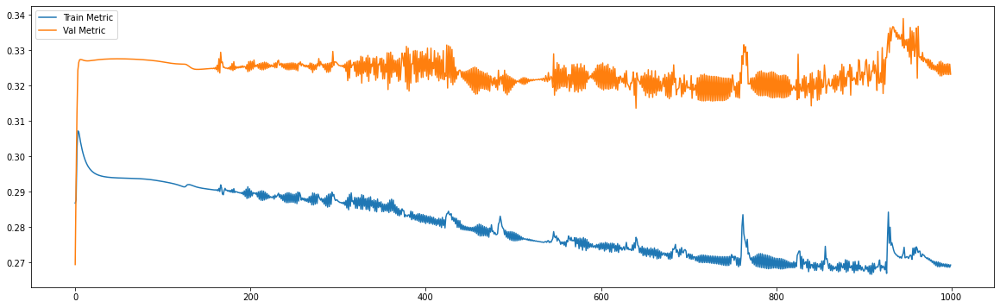

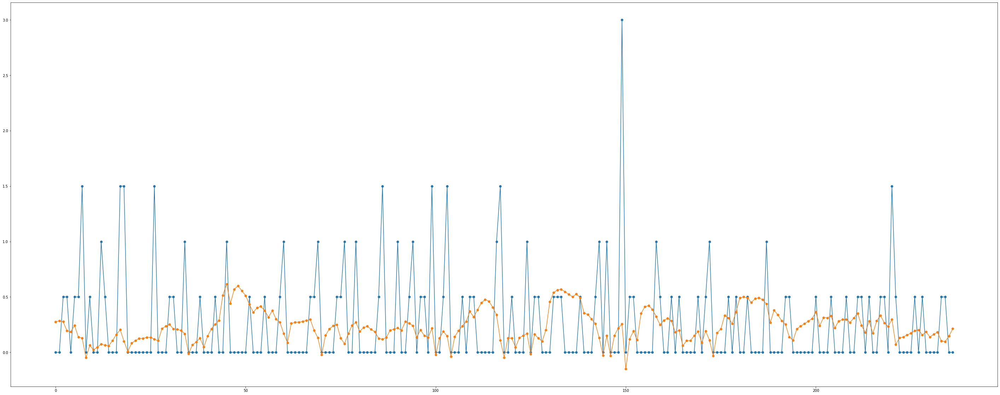

============================model:2===========================


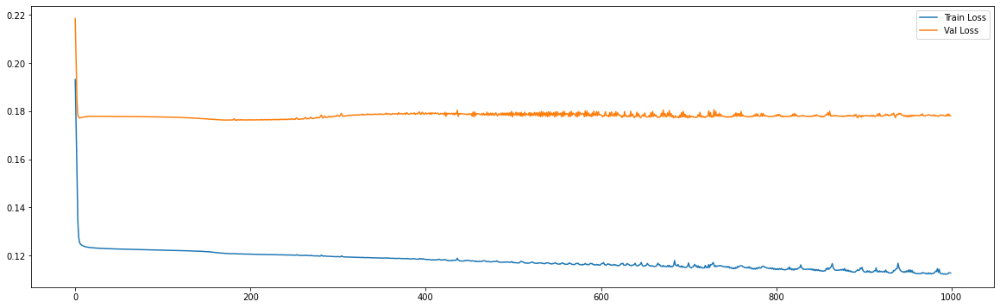

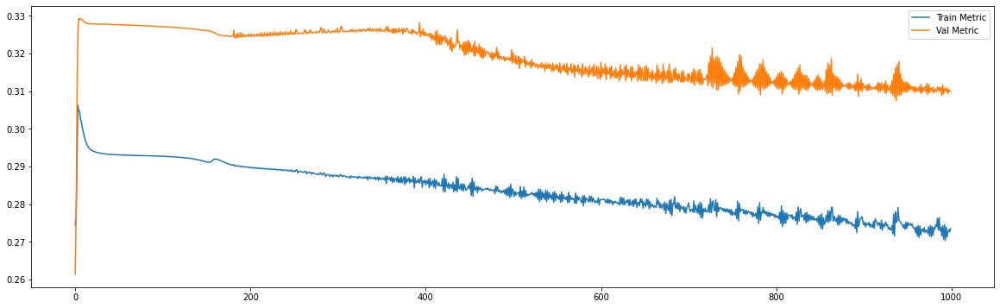

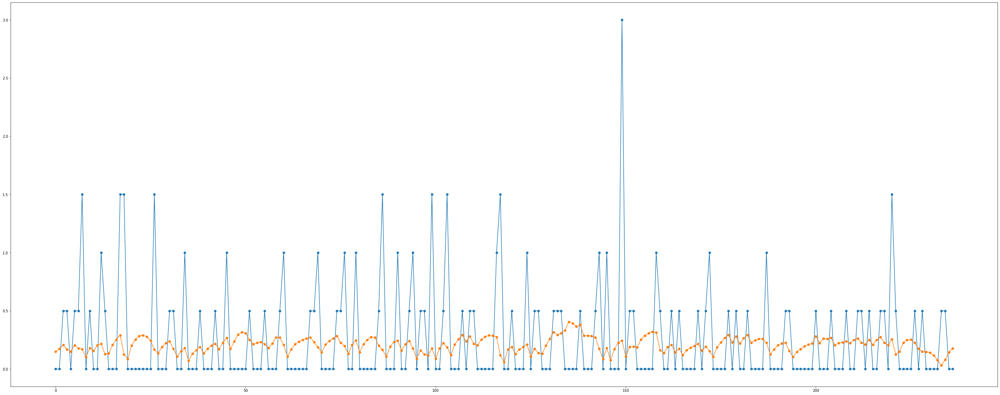

============================model:3===========================


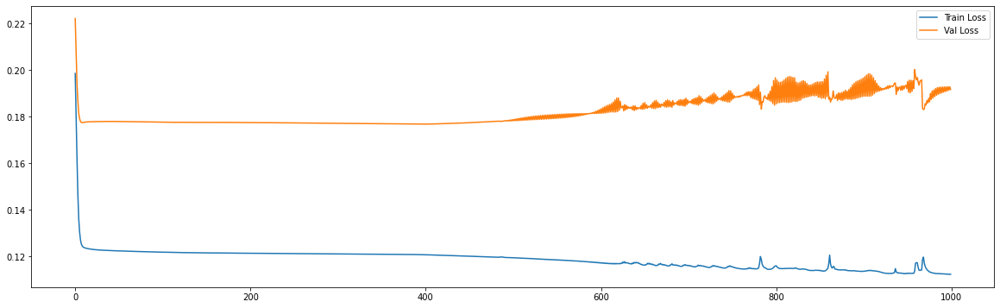

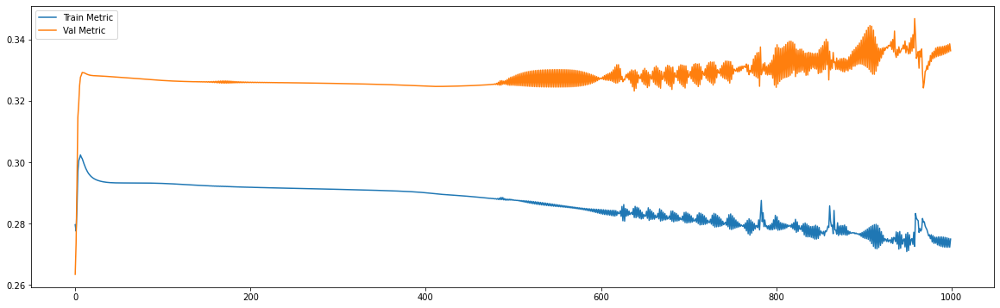

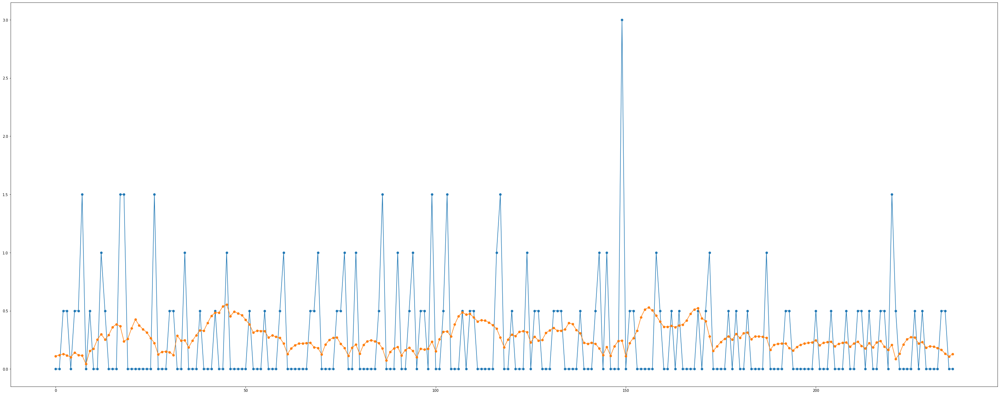

============================model:4===========================


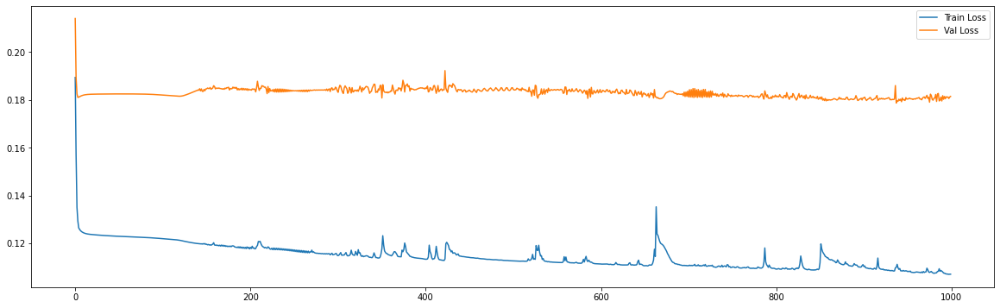

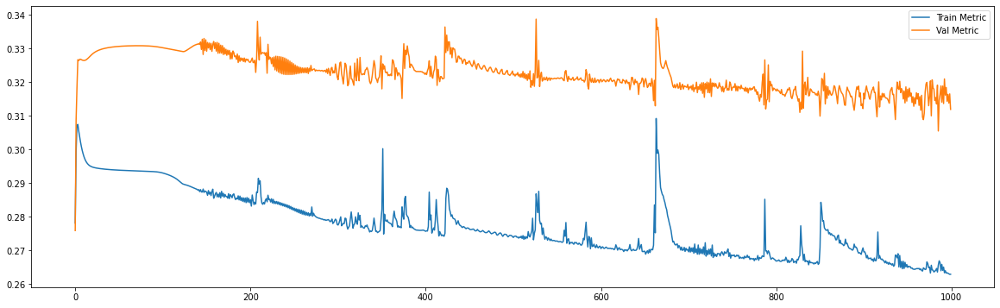

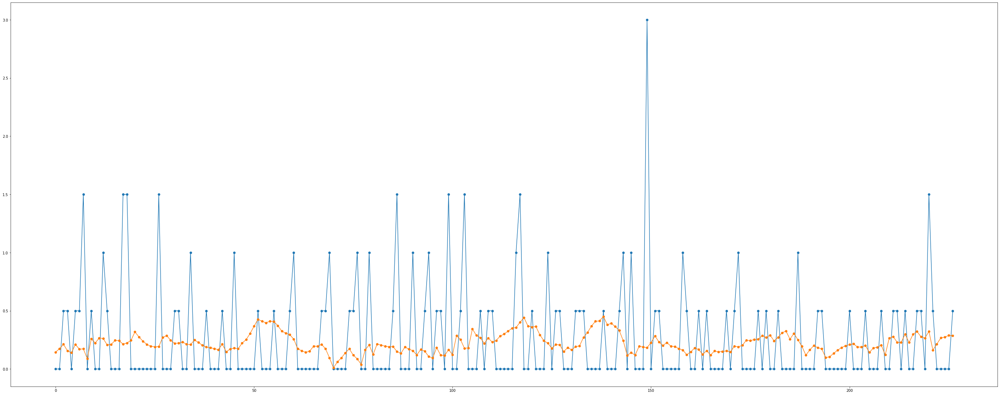

============================model:5===========================


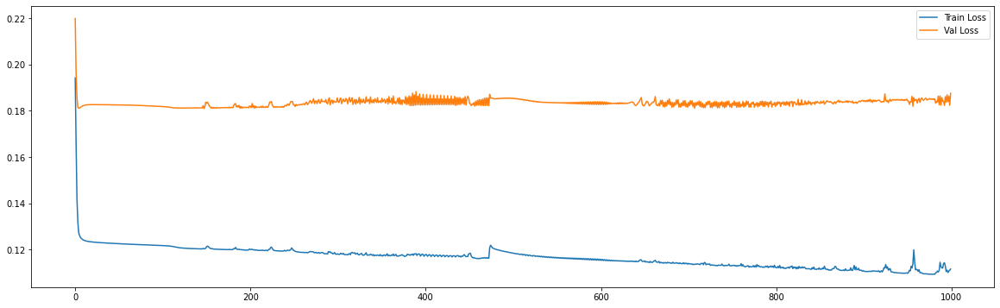

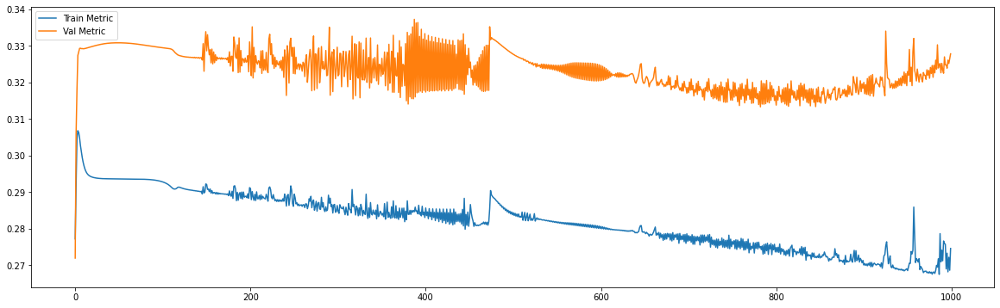

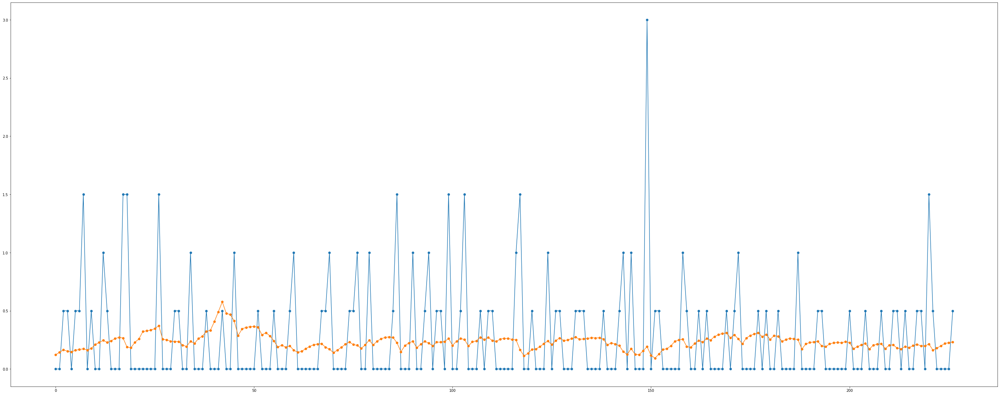

============================model:6===========================


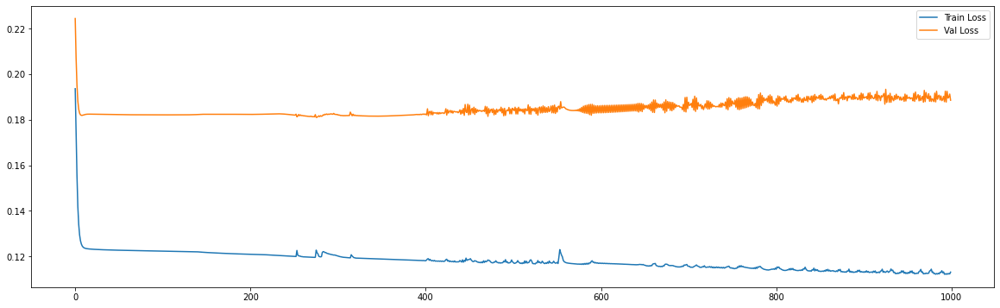

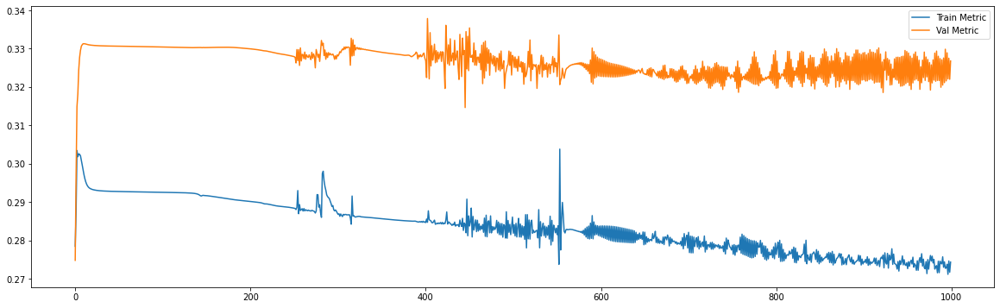

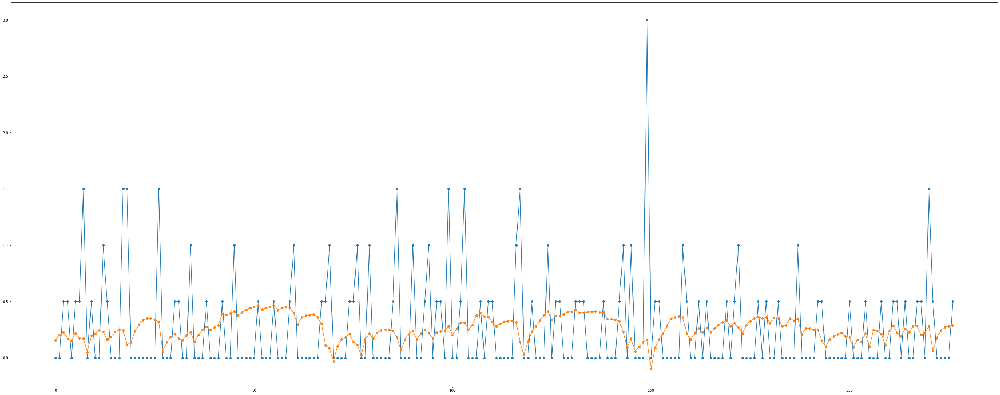

============================model:7===========================


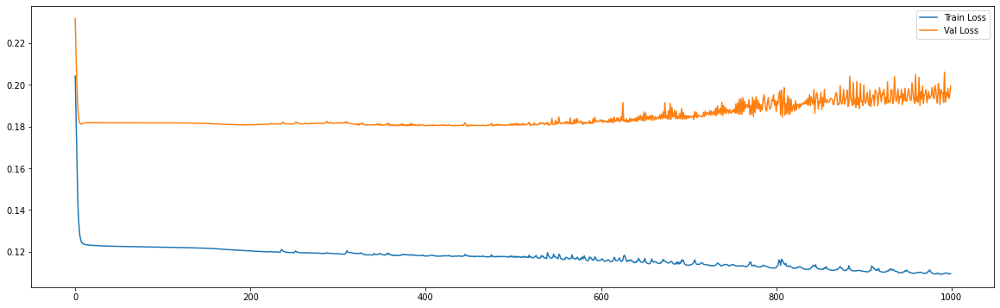

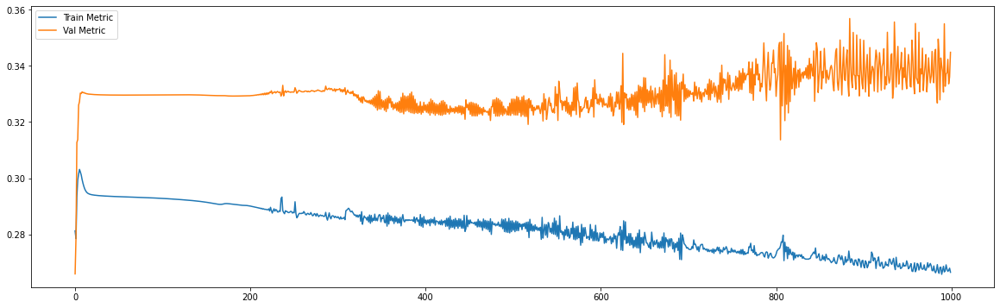

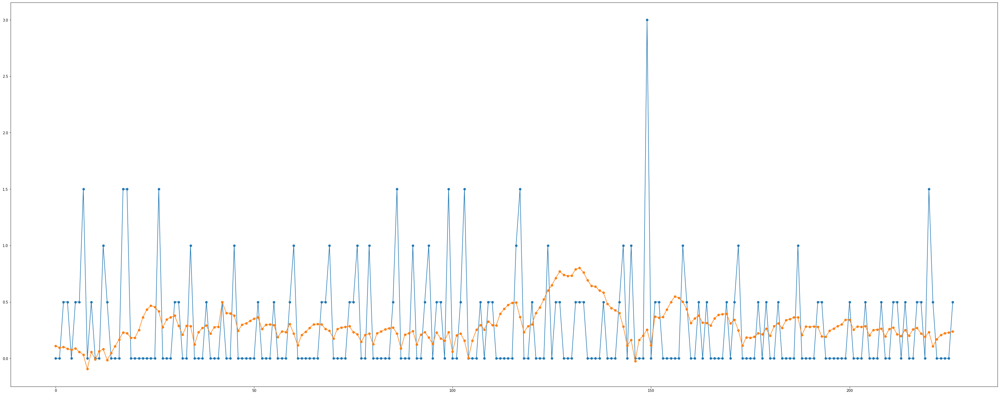

============================model:8===========================


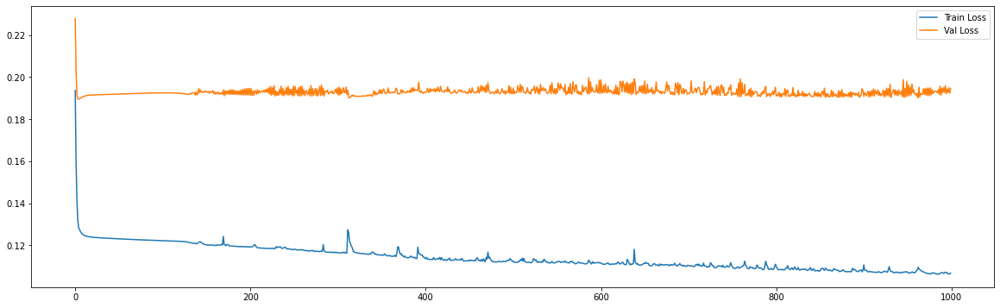

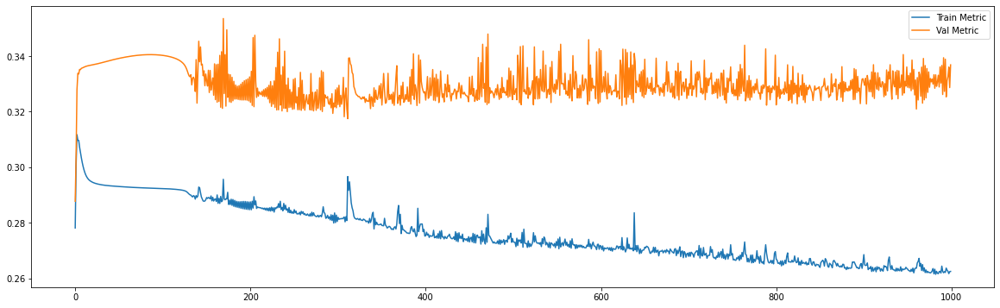

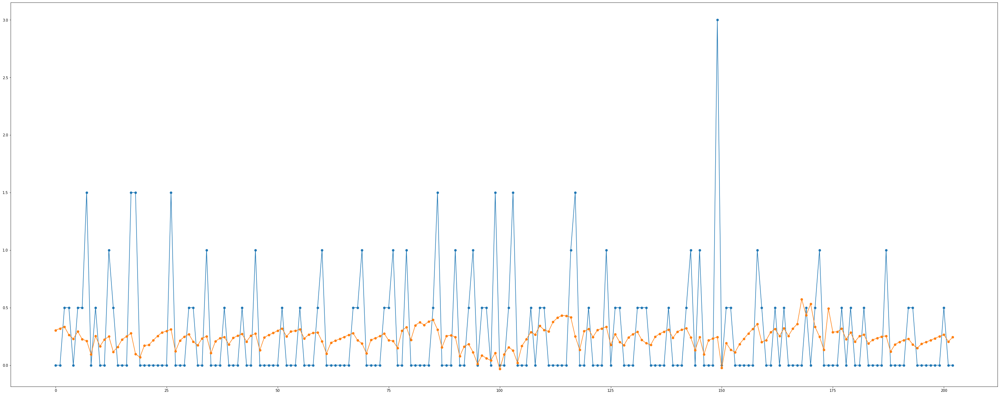

============================model:9===========================


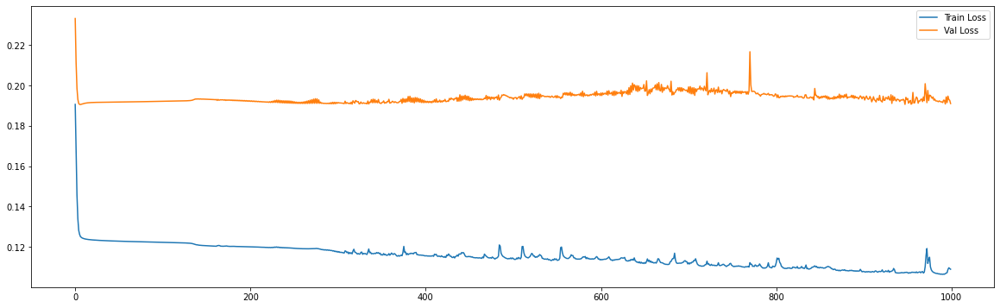

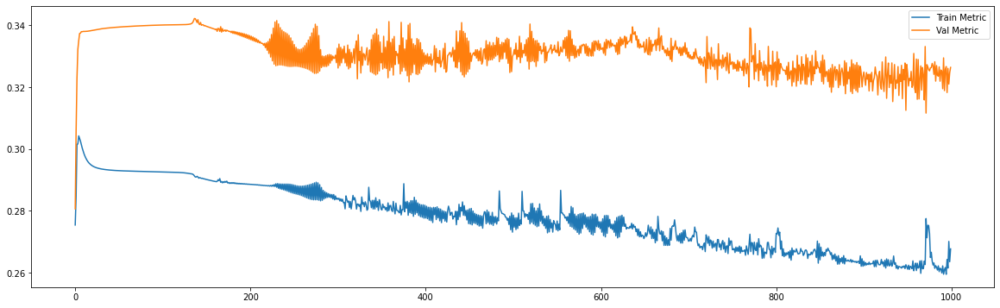

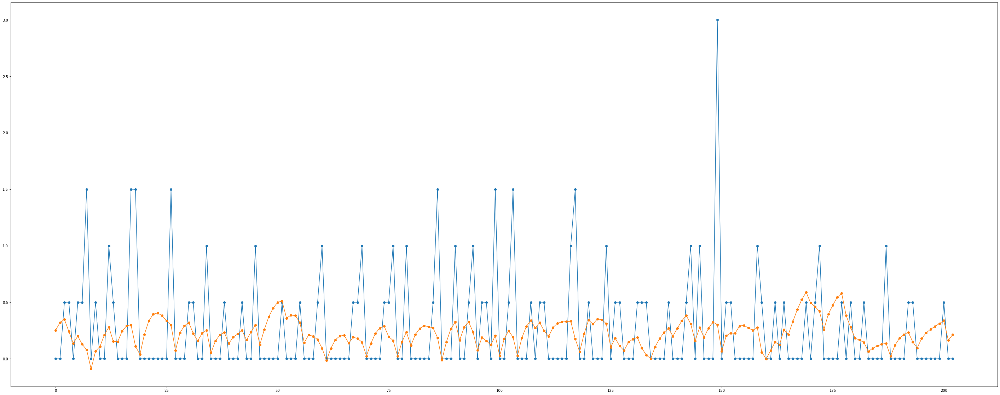

============================model:10===========================


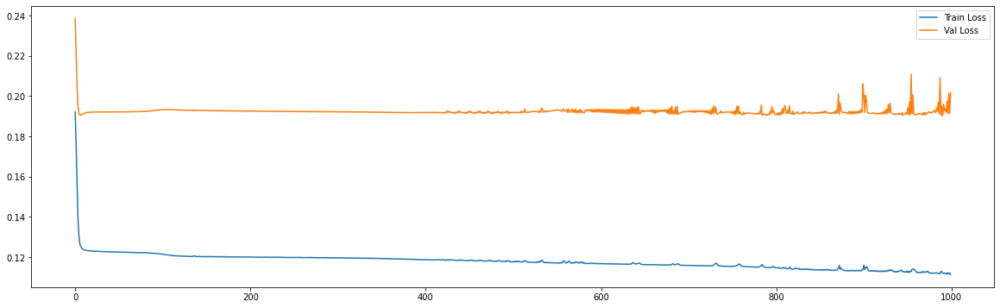

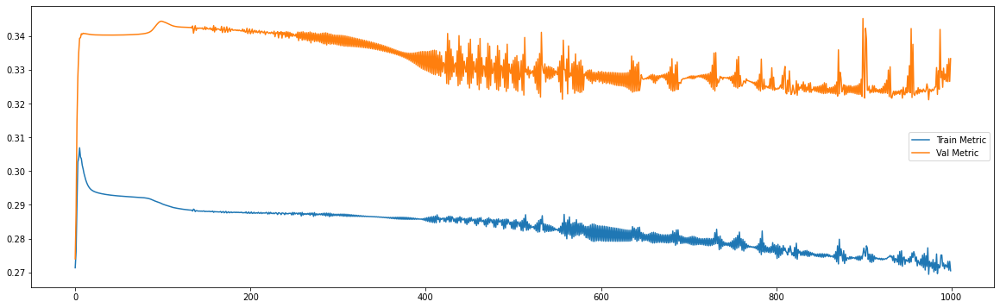

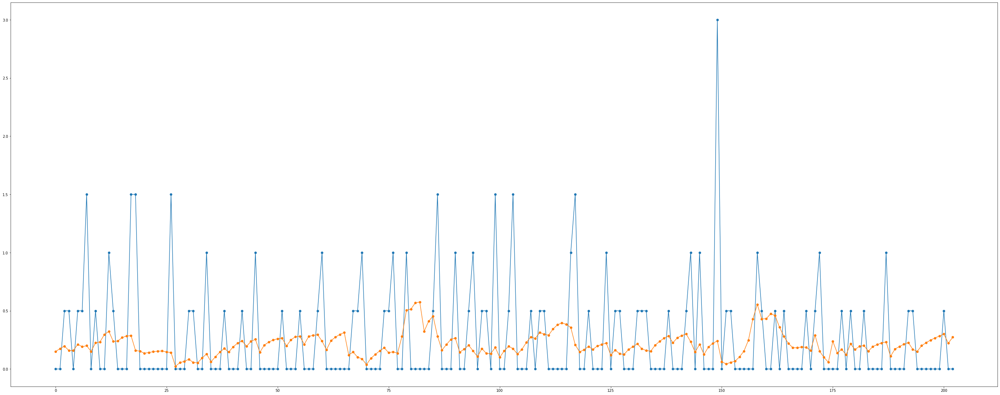

============================model:11===========================


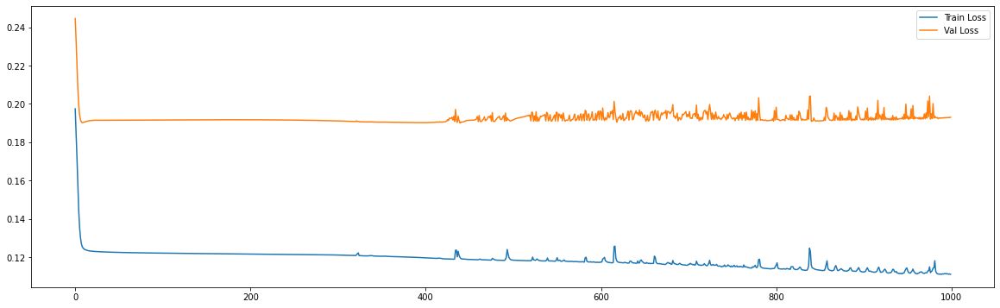

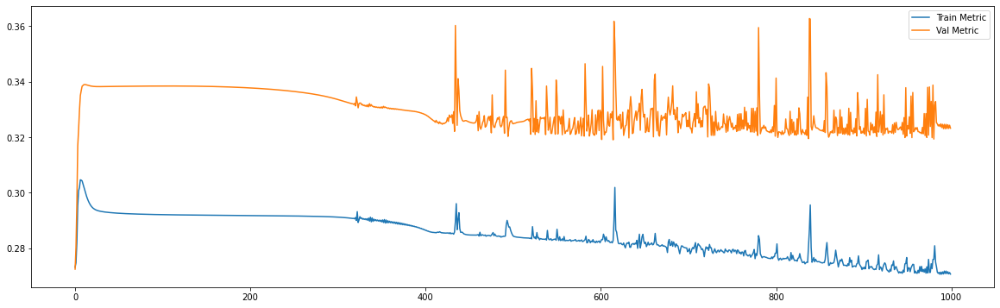

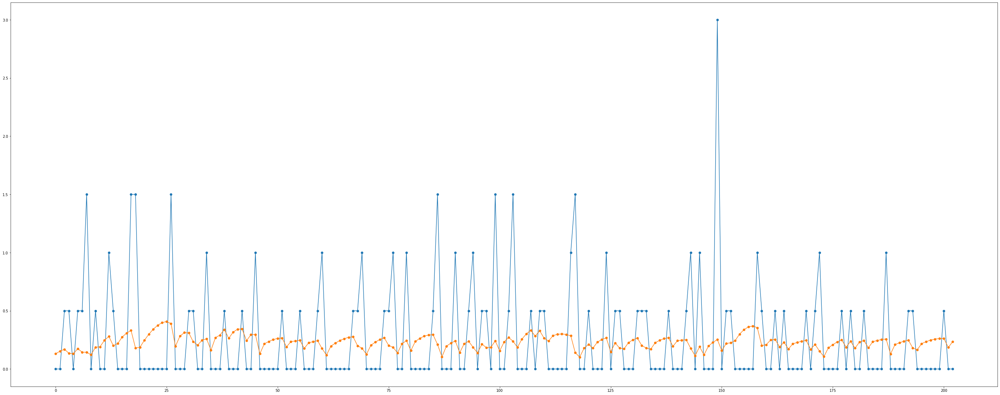

============================model:12===========================


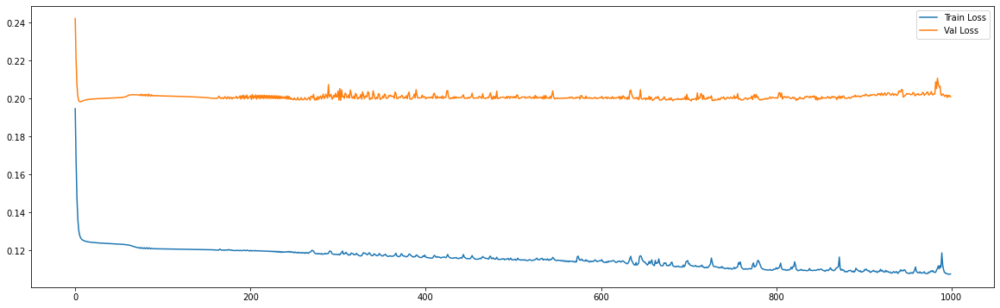

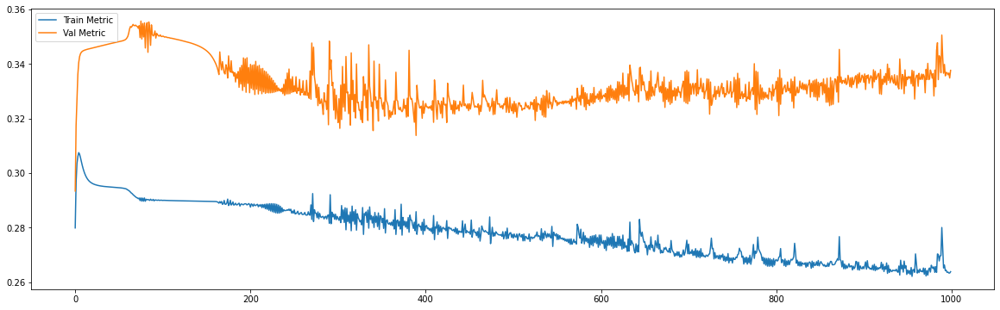

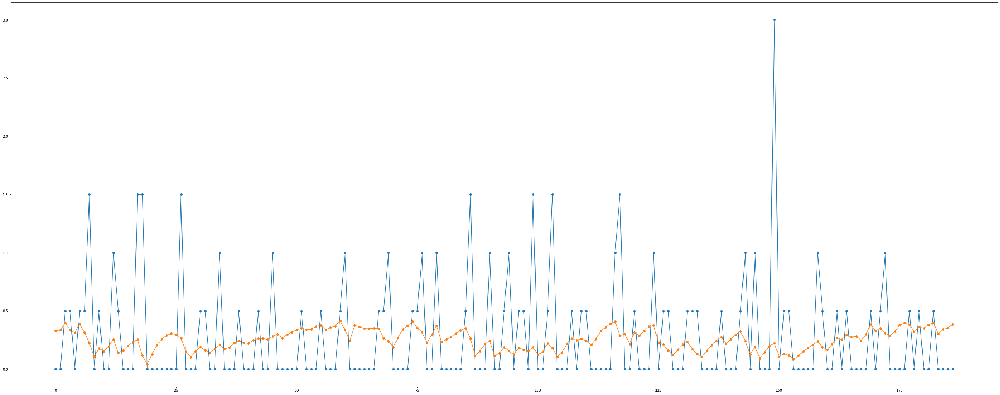

============================model:13===========================


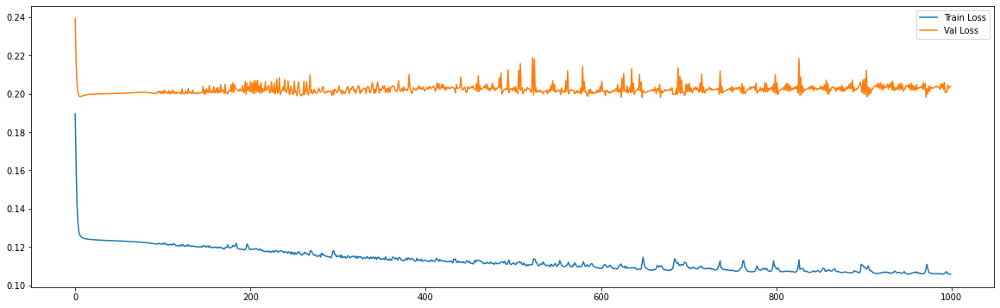

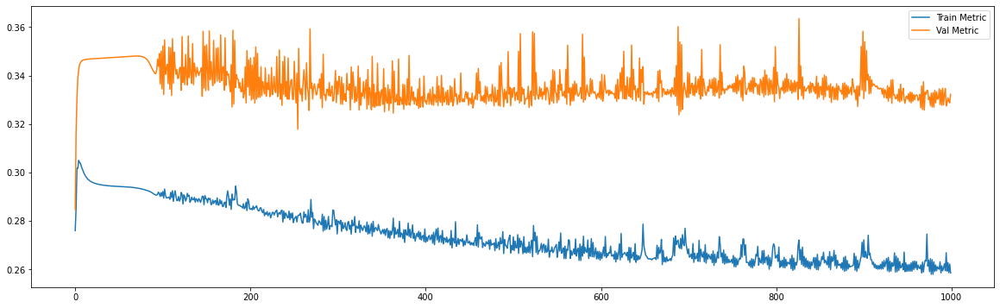

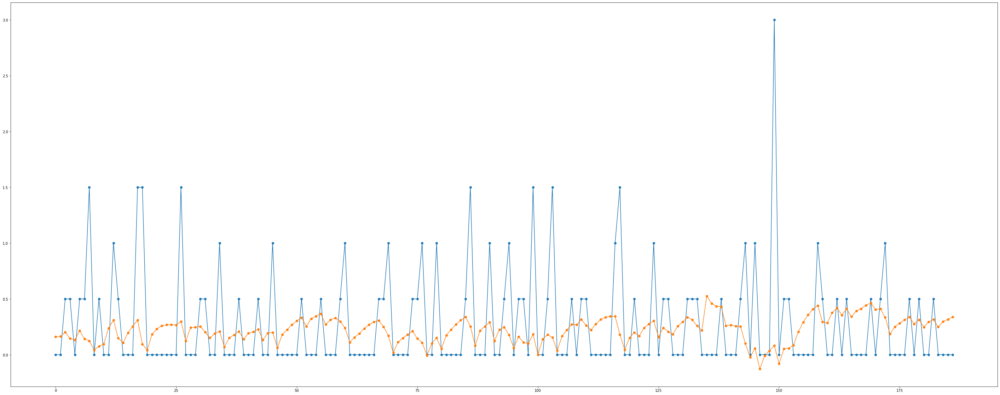

============================model:14===========================


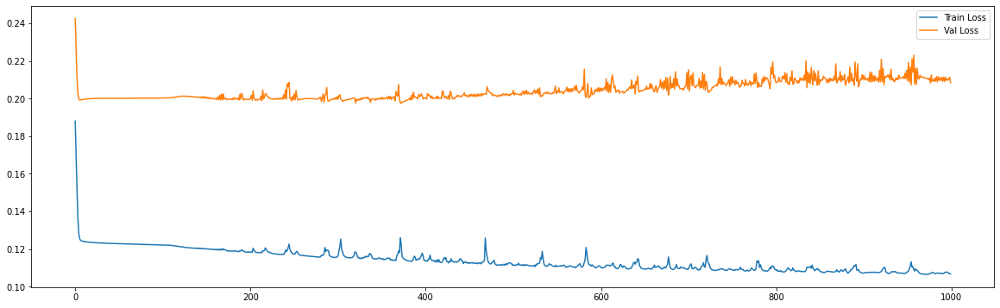

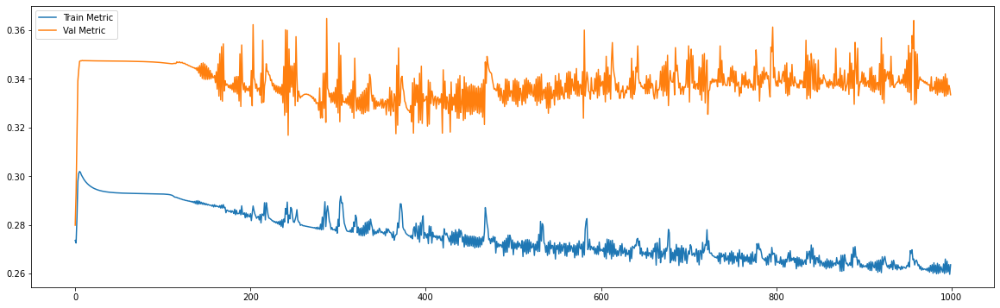

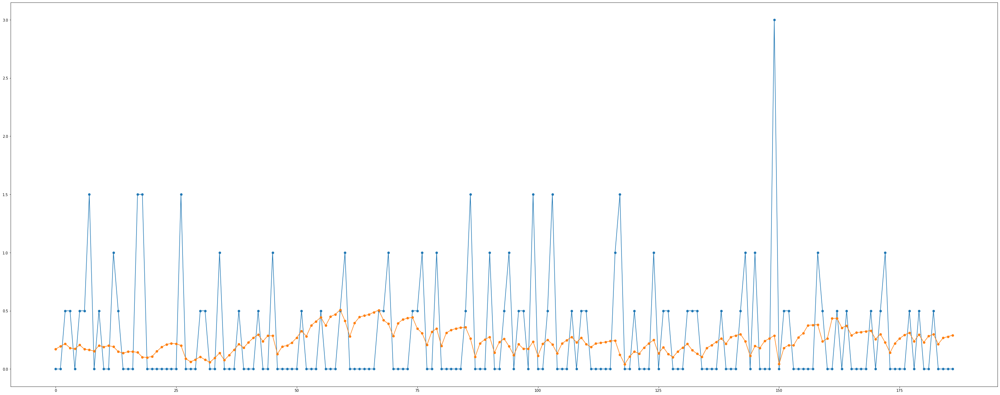

============================model:15===========================


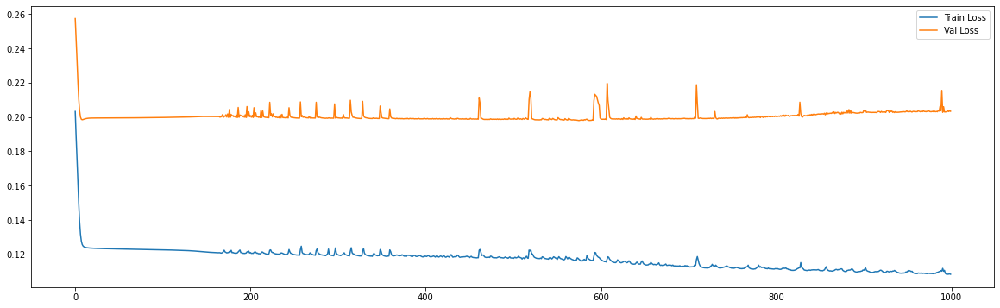

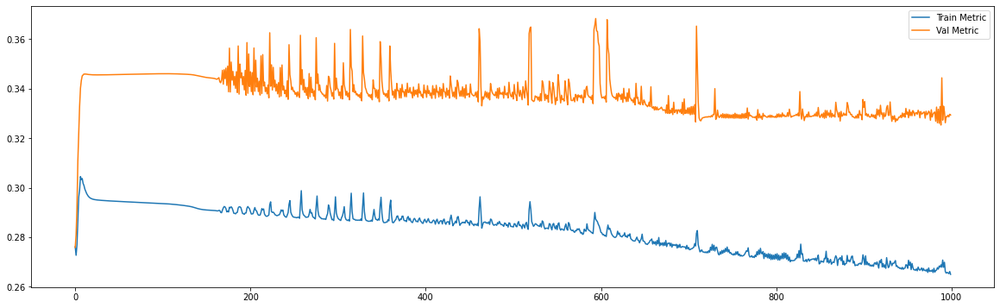

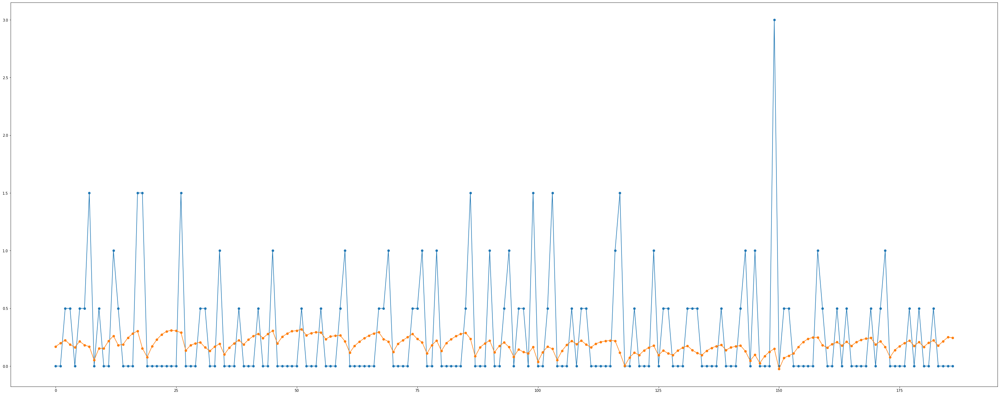

============================model:16===========================


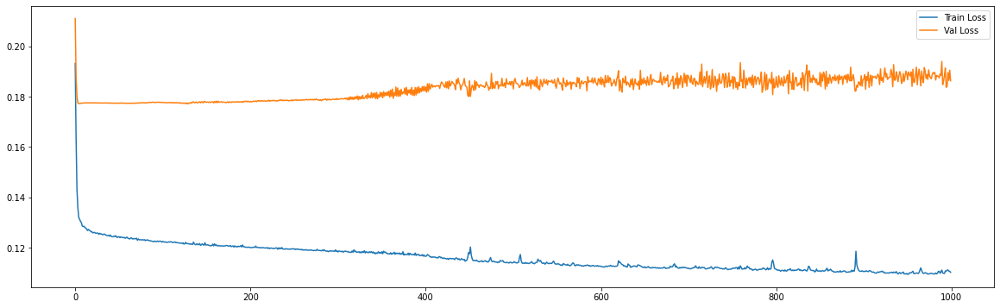

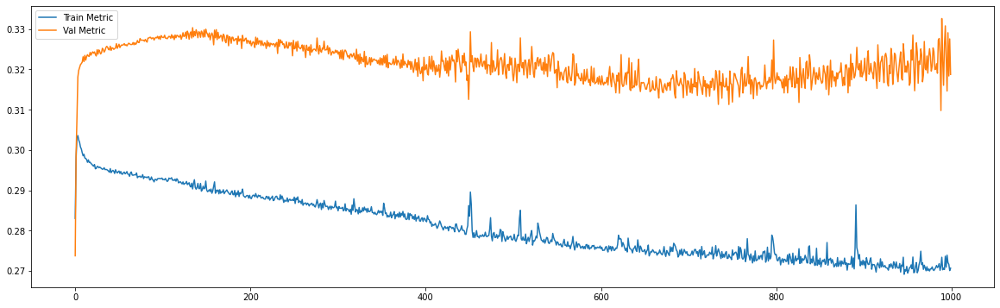

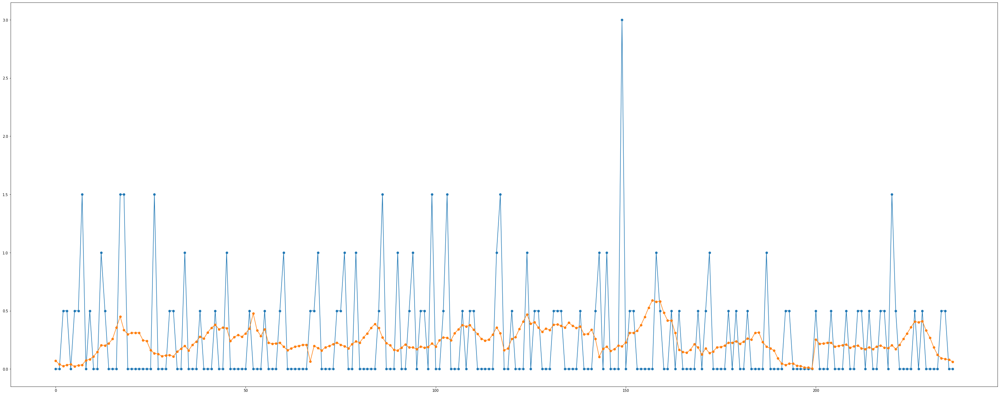

============================model:17===========================


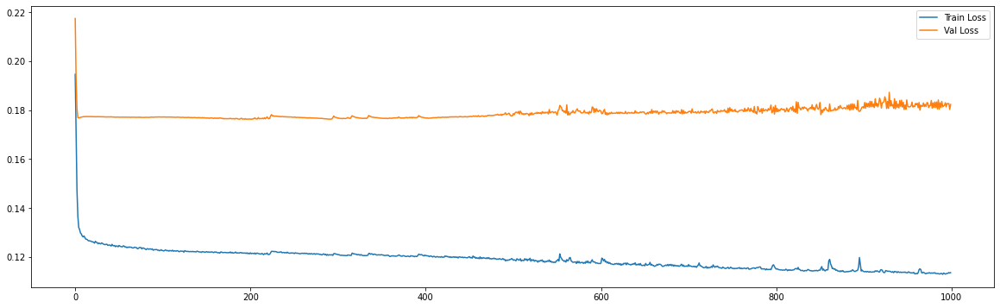

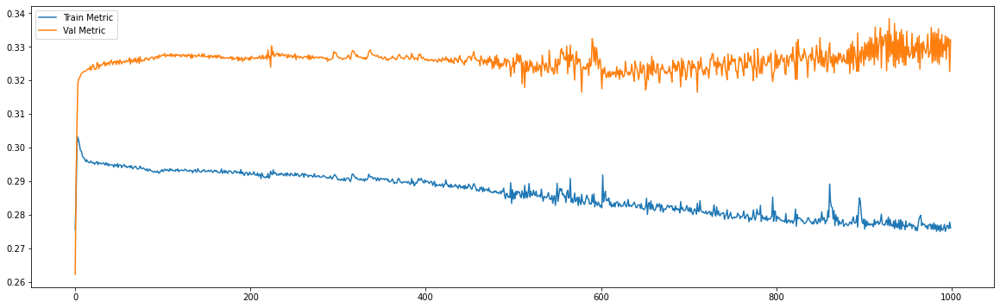

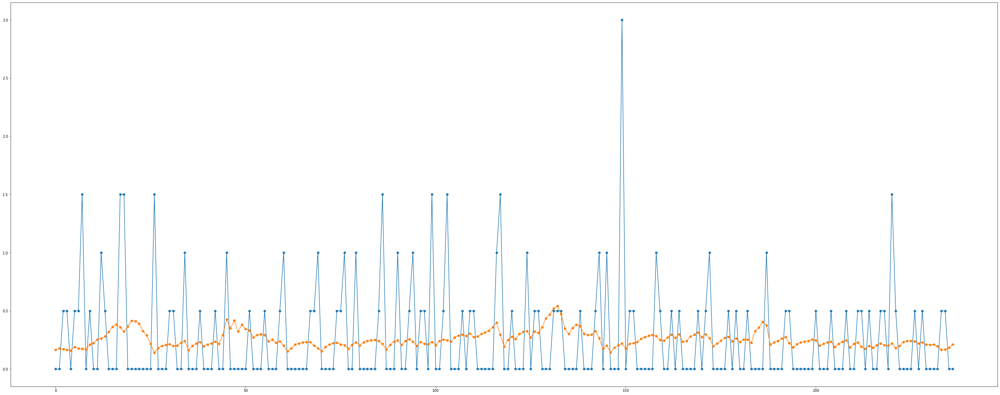

============================model:18===========================


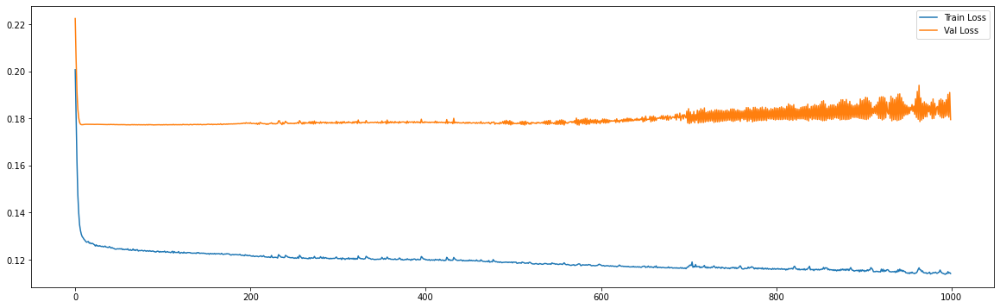

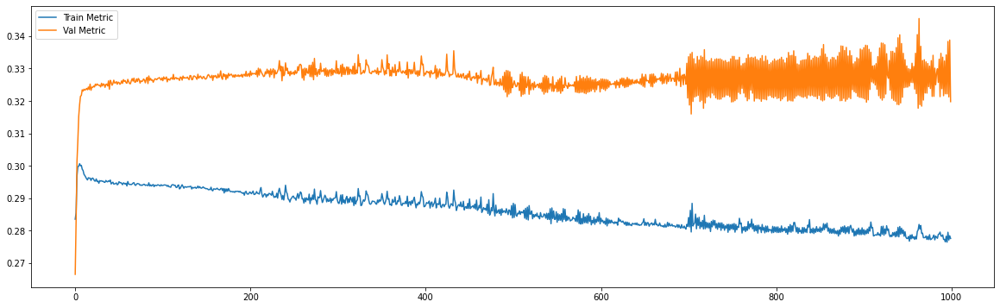

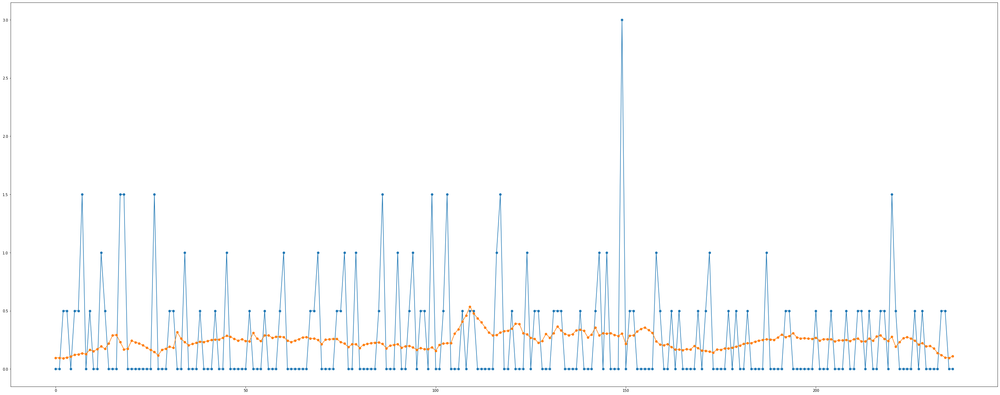

============================model:19===========================


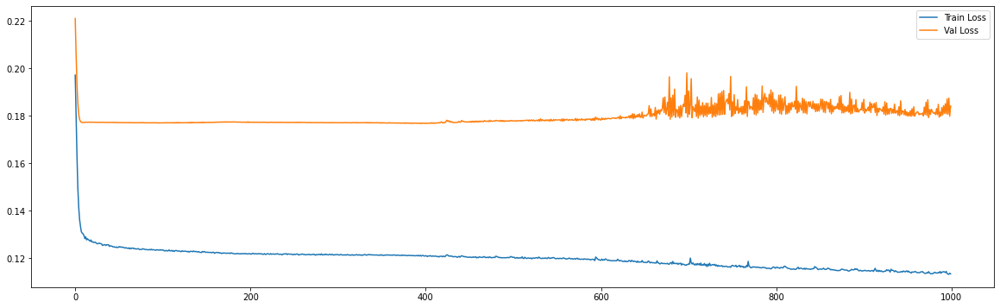

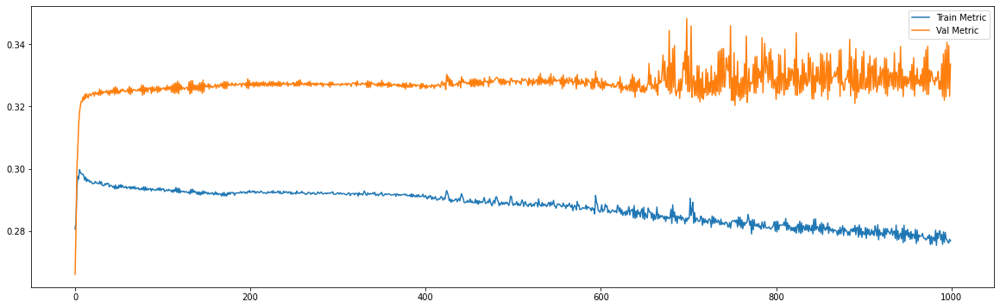

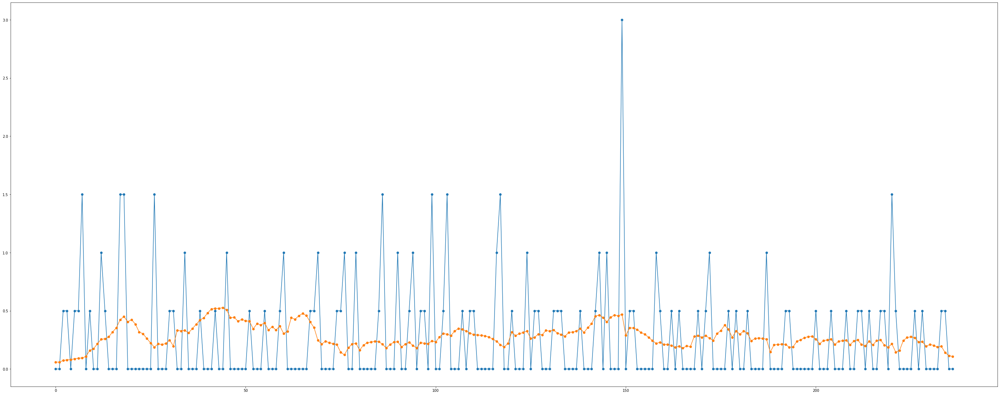

============================model:20===========================


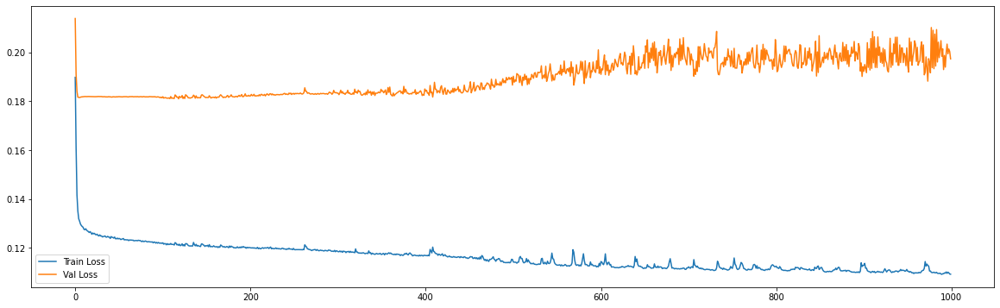

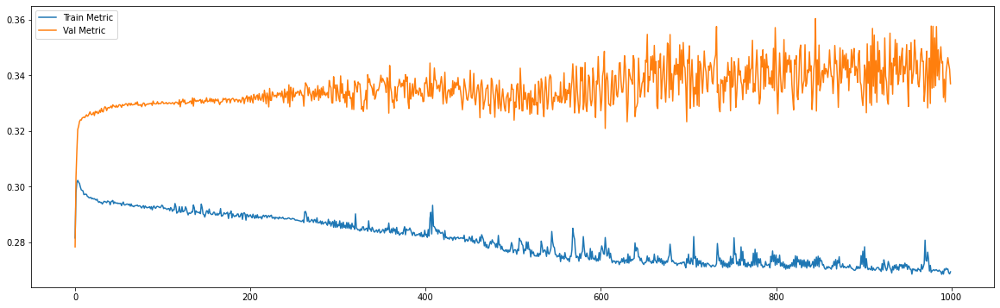

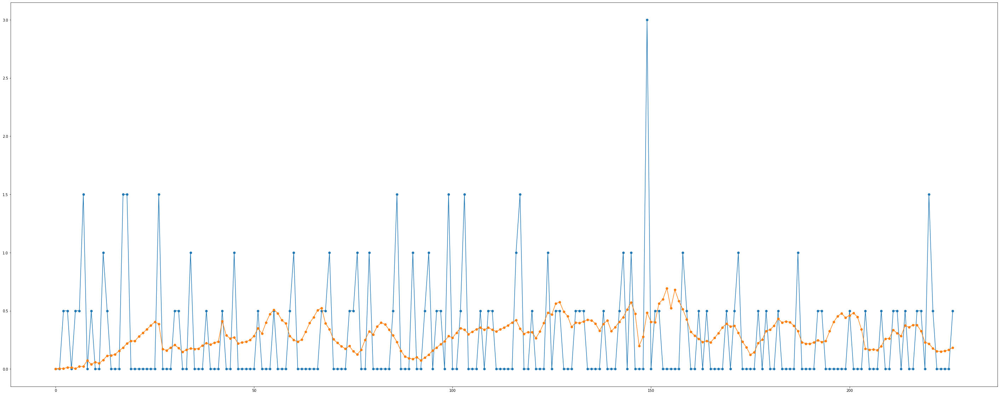

============================model:21===========================


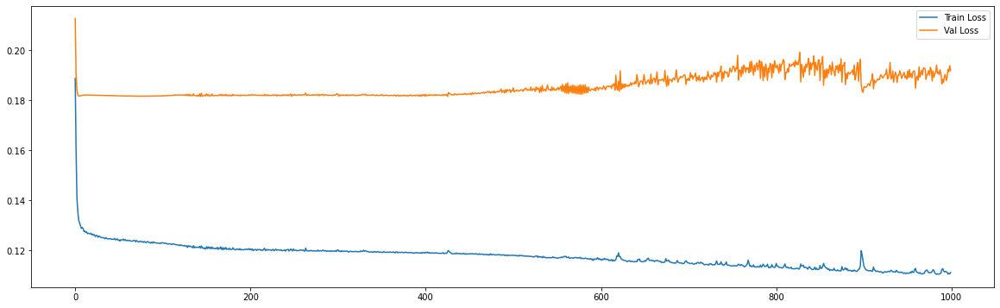

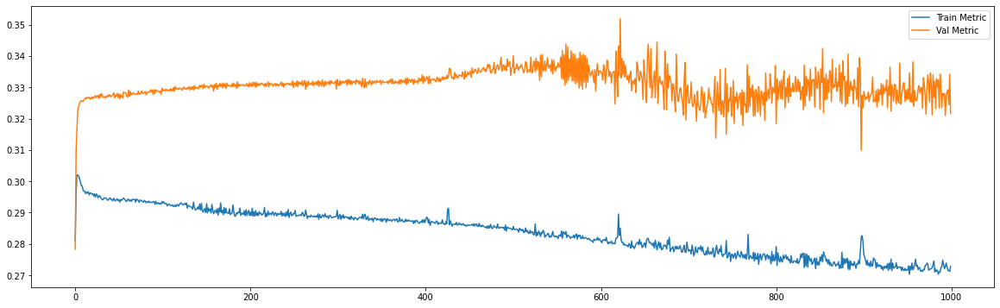

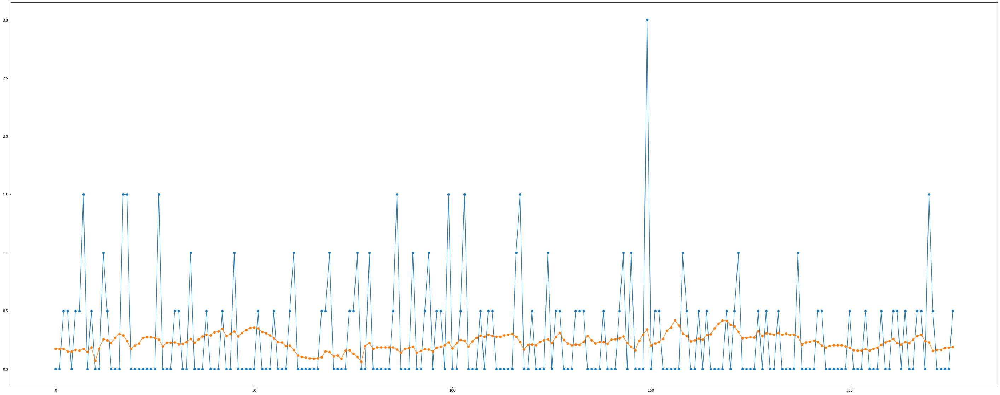

============================model:22===========================


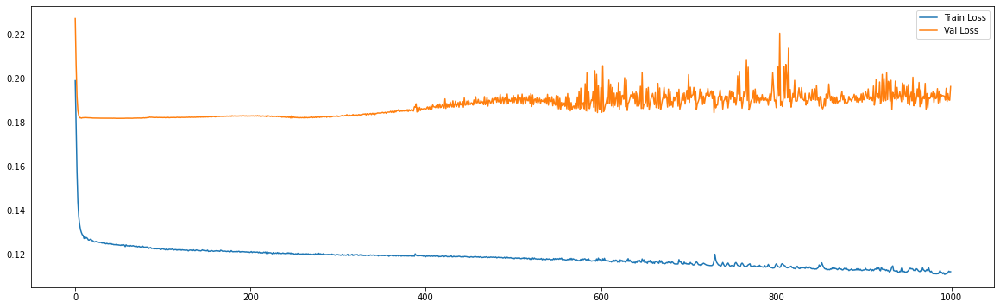

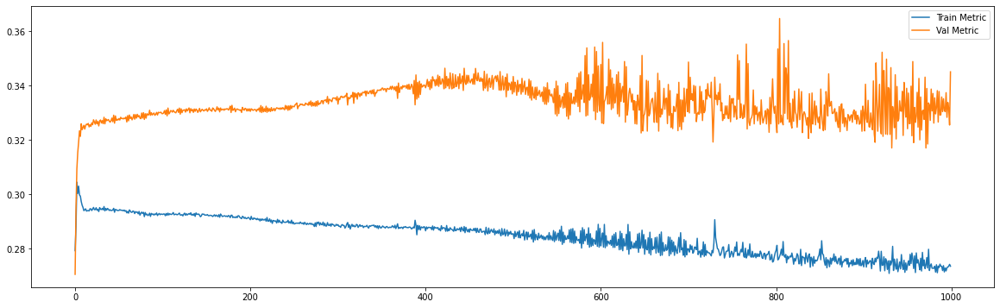

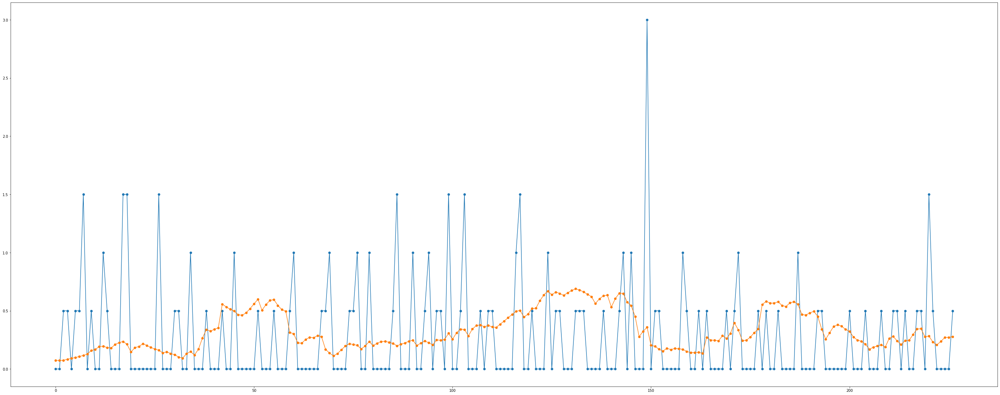

============================model:23===========================


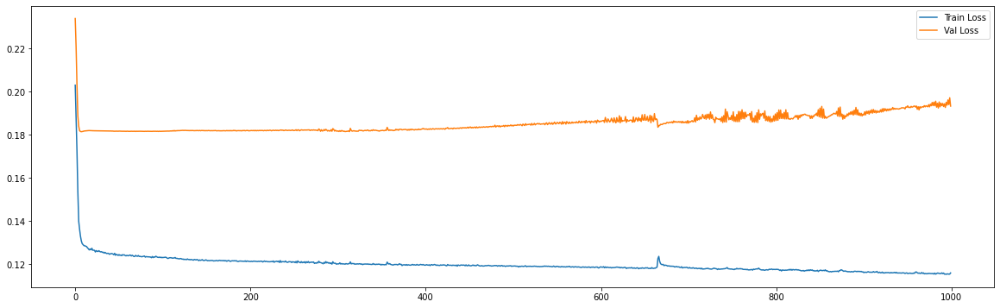

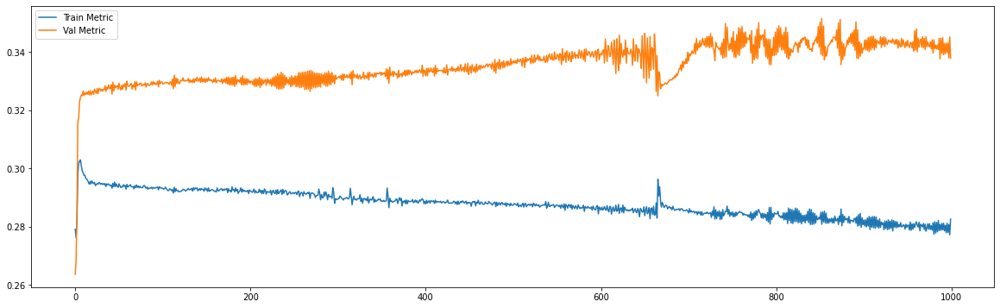

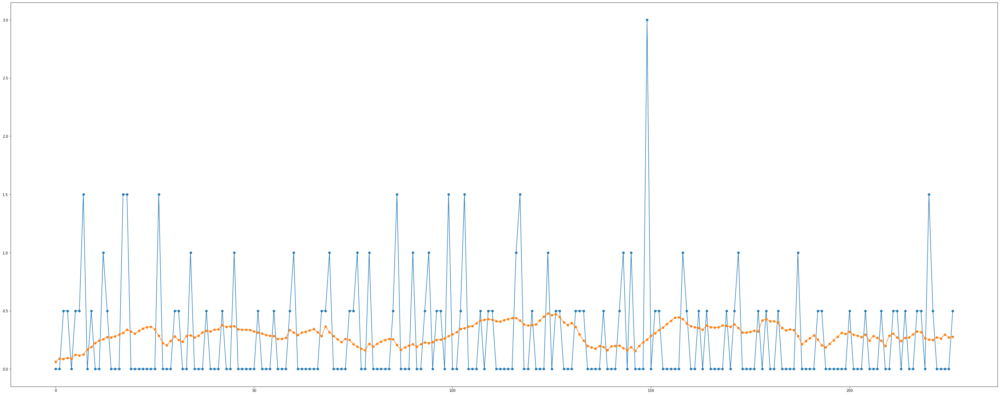

============================model:24===========================


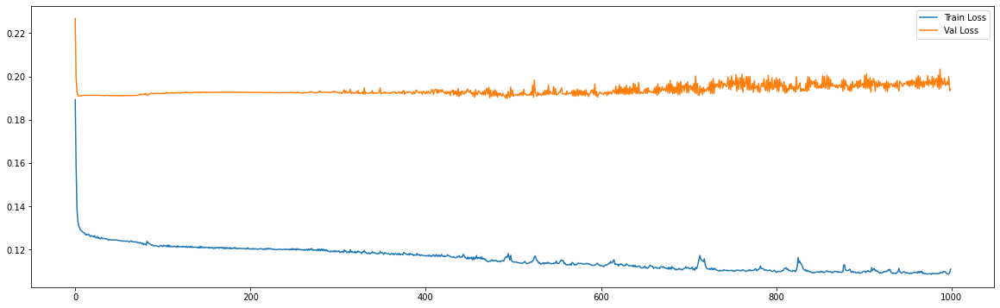

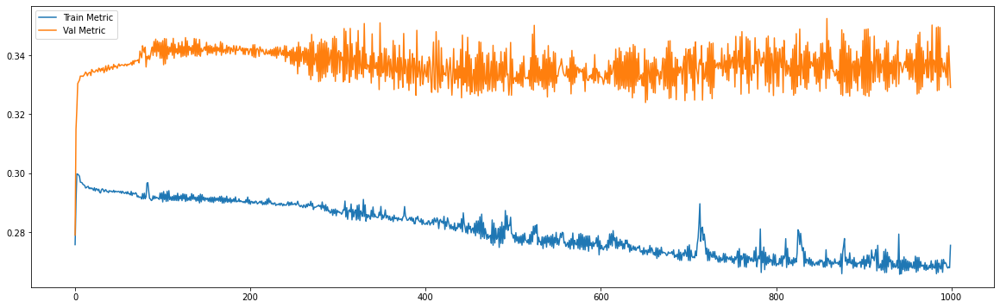

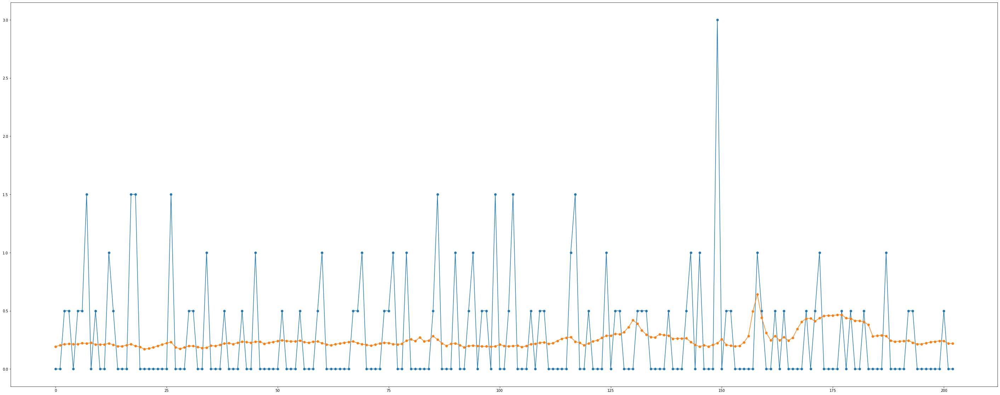

============================model:25===========================


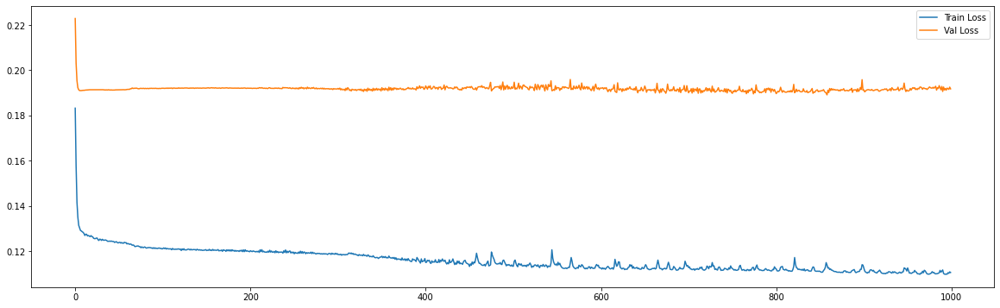

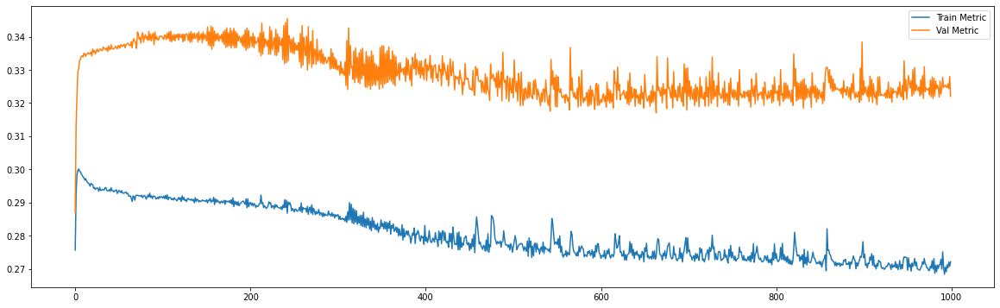

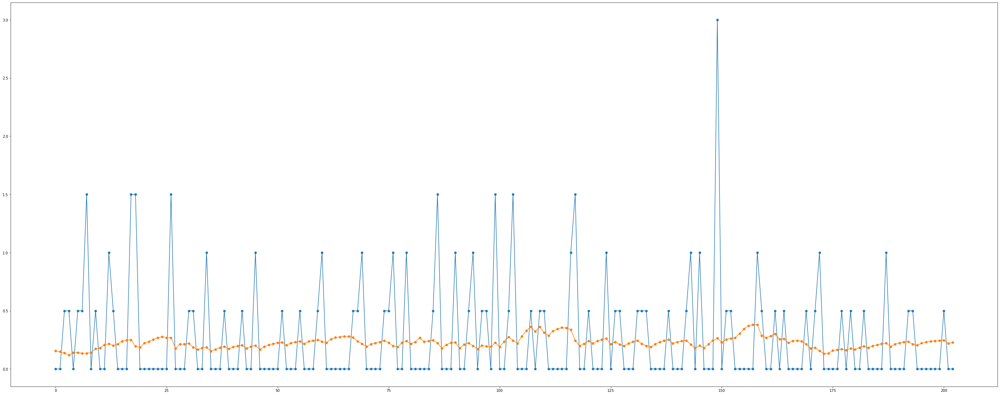

============================model:26===========================


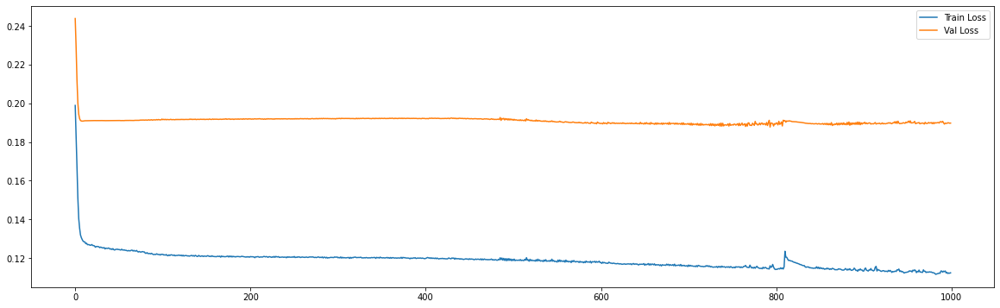

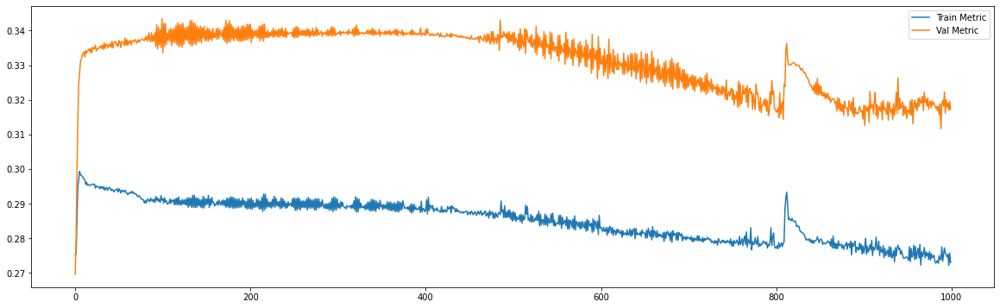

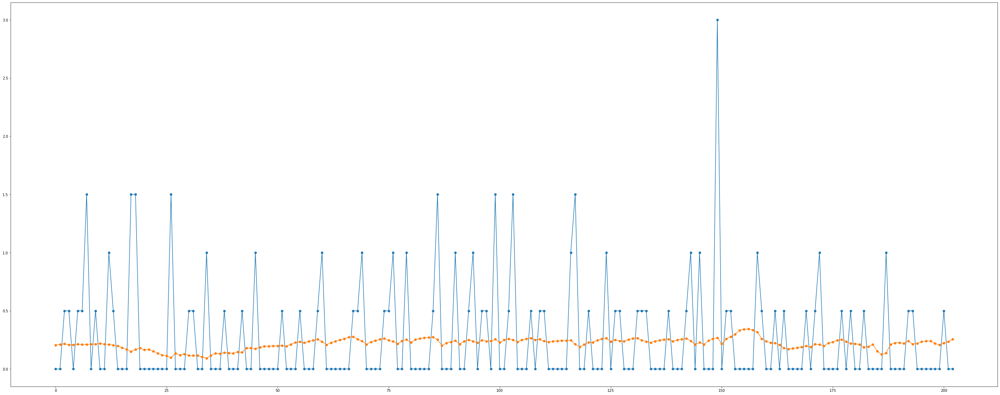

============================model:27===========================


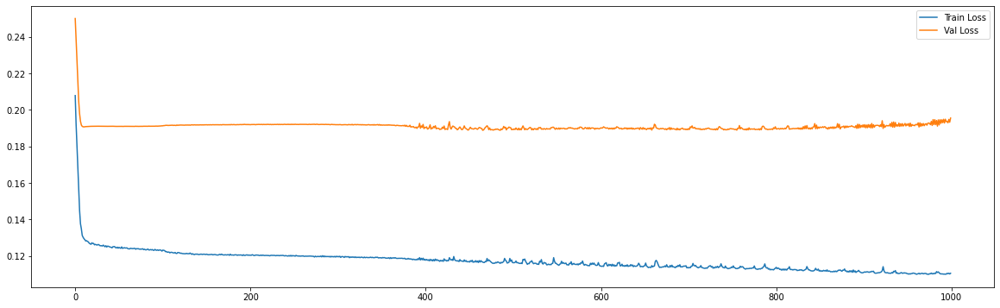

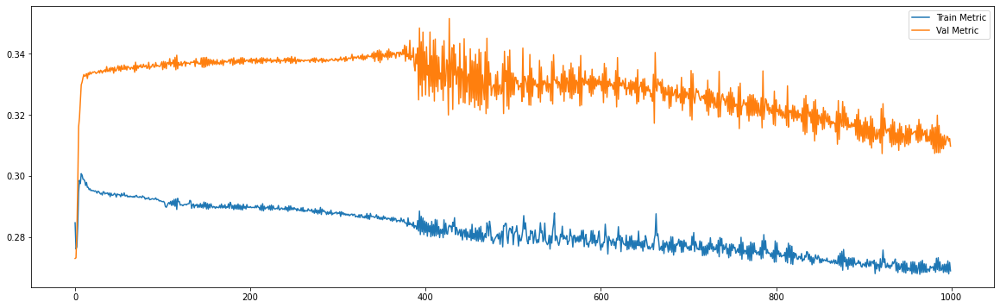

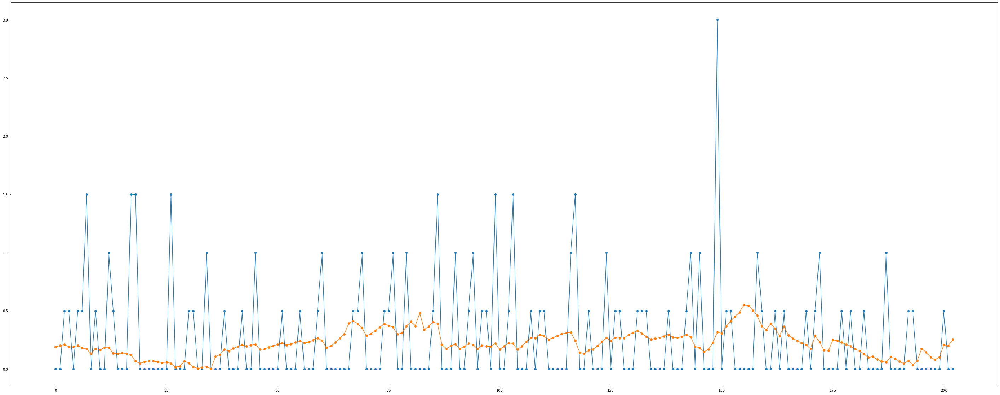

============================model:28===========================


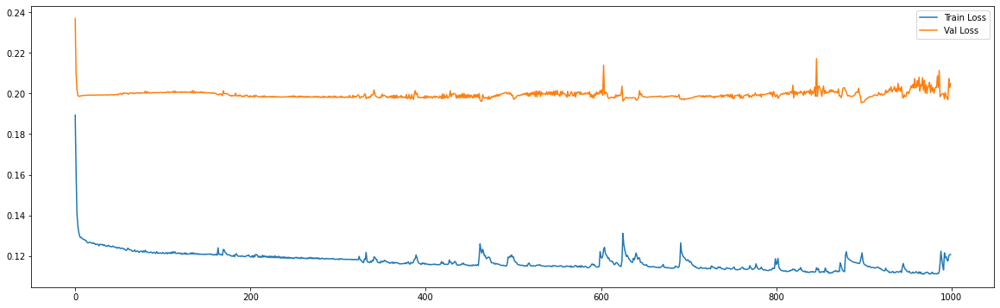

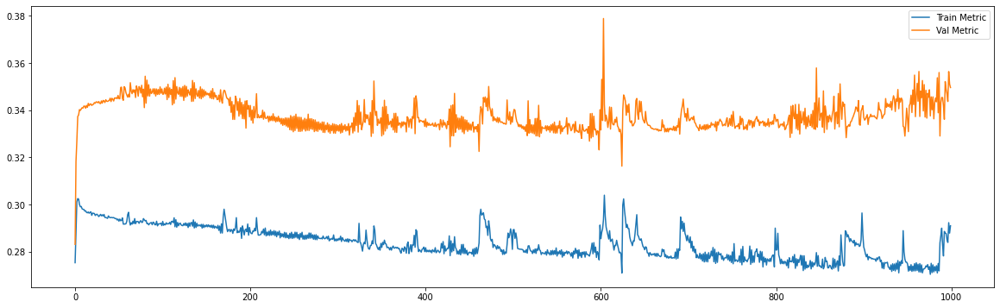

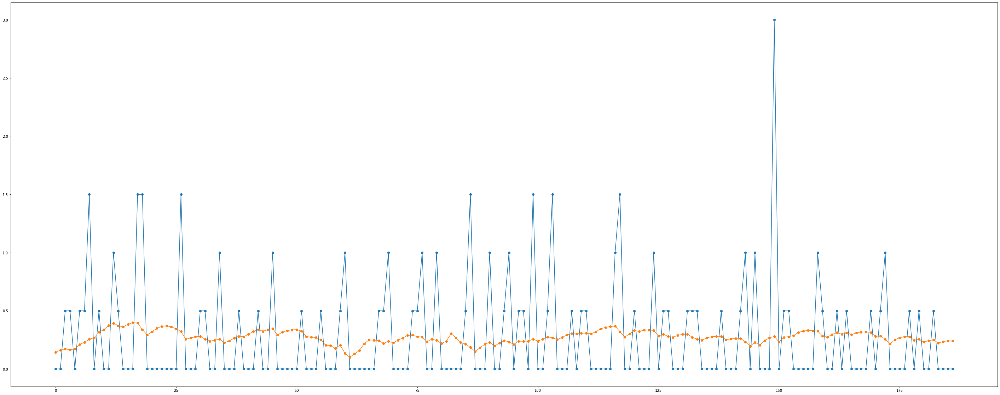

============================model:29===========================


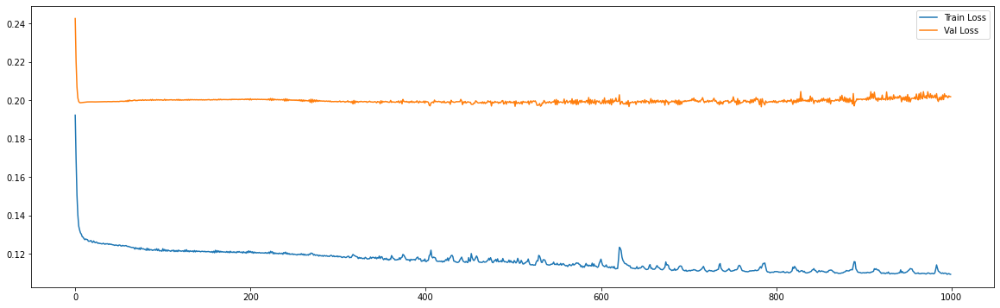

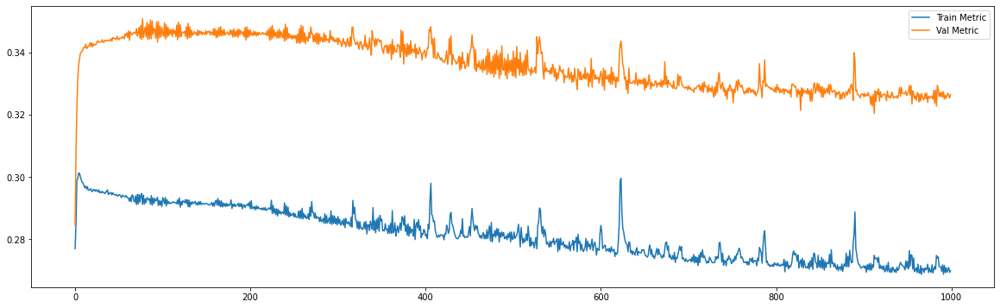

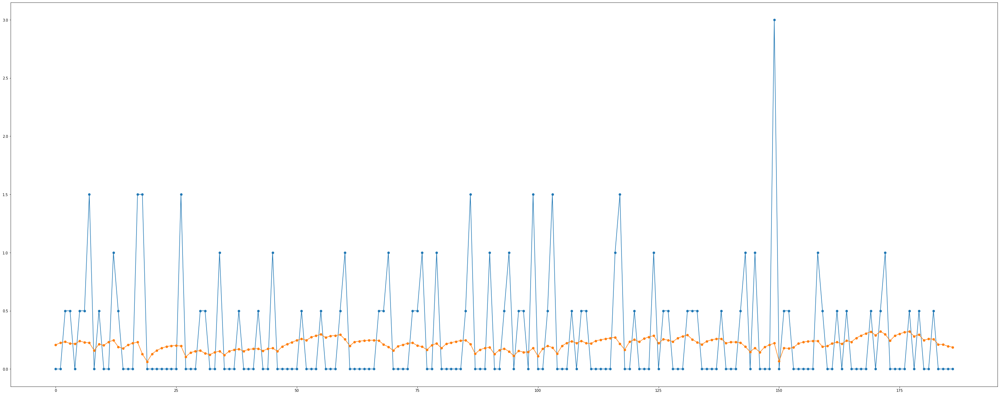

============================model:30===========================


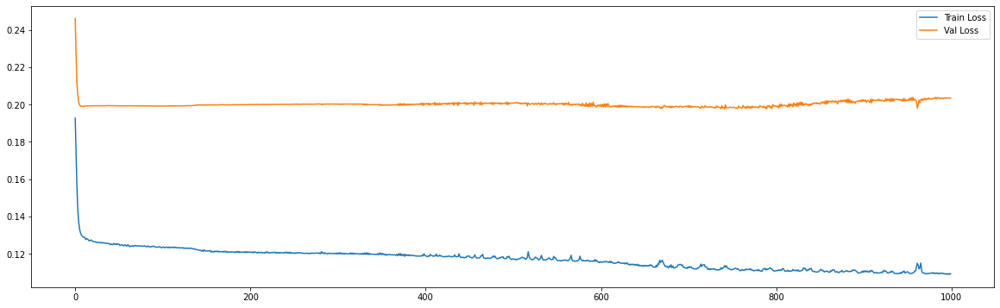

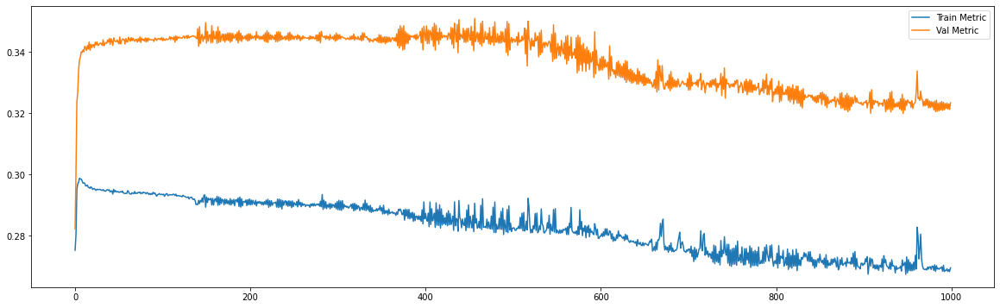

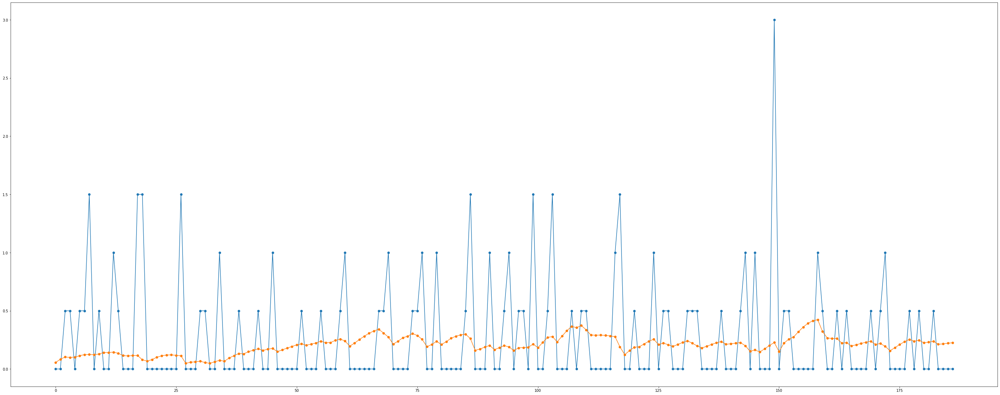

============================model:31===========================


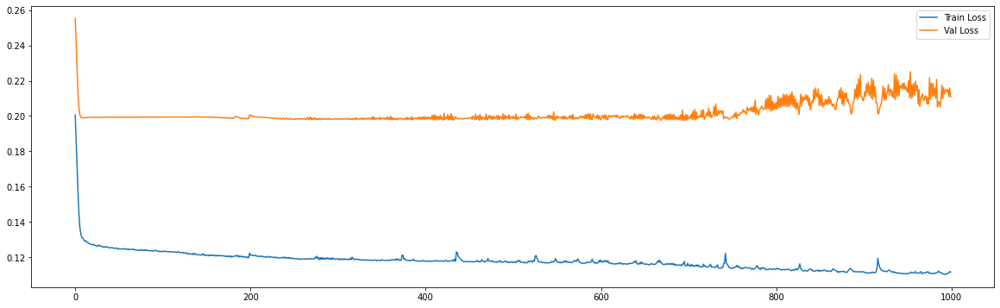

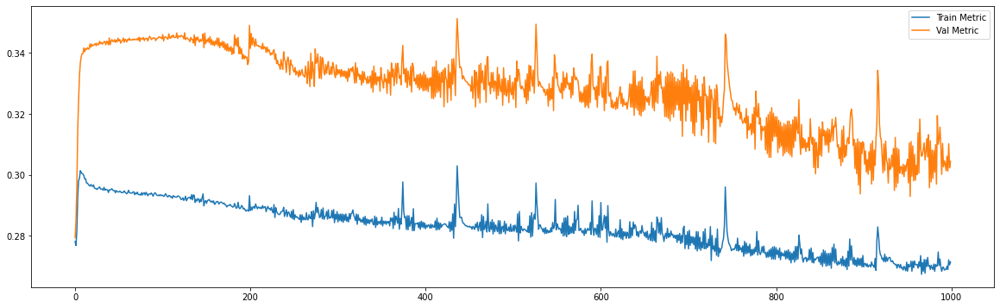

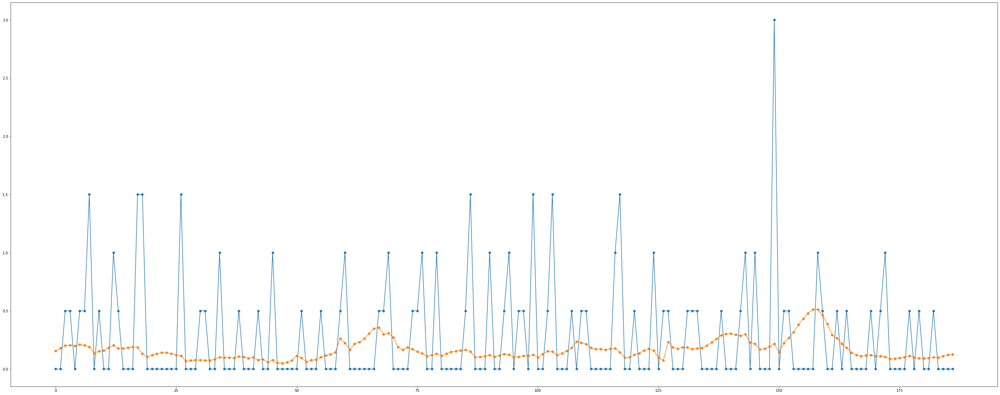

============================model:32===========================


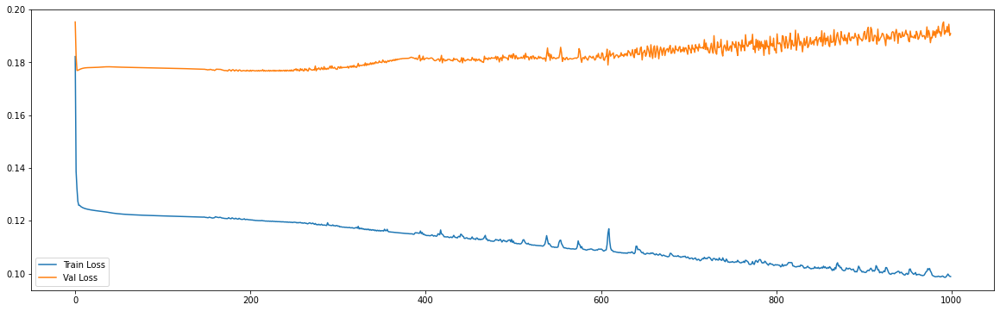

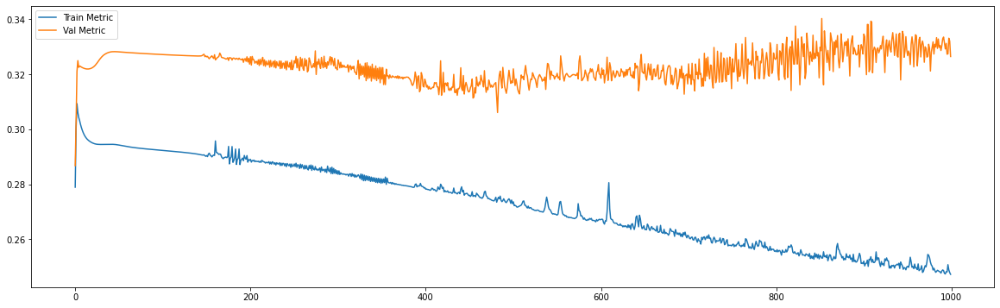

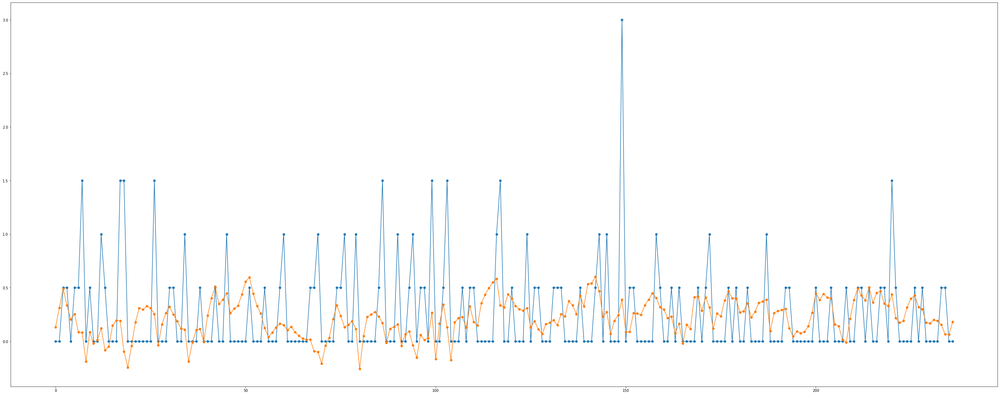

============================model:33===========================


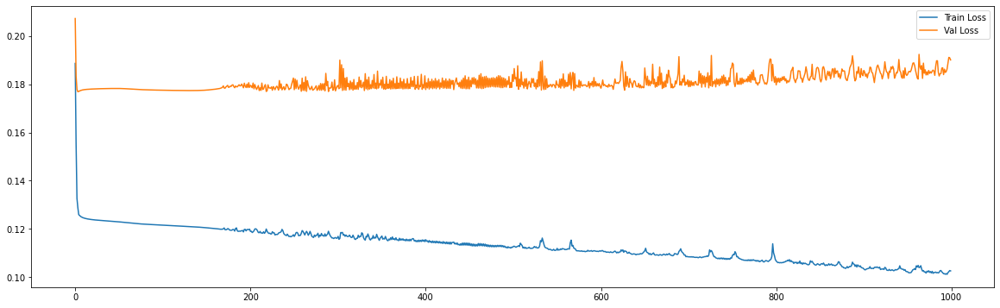

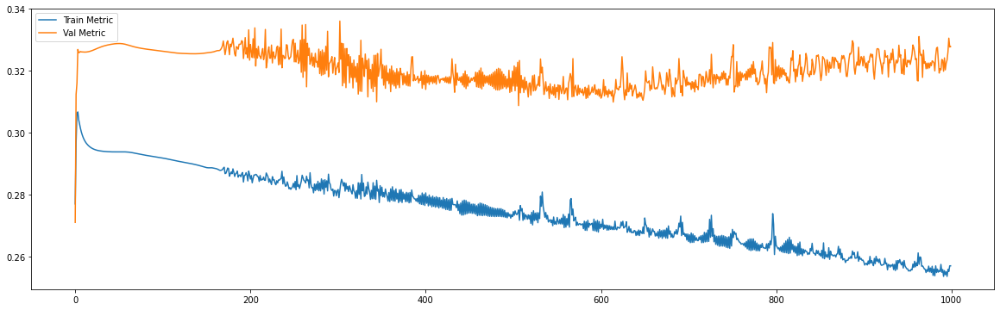

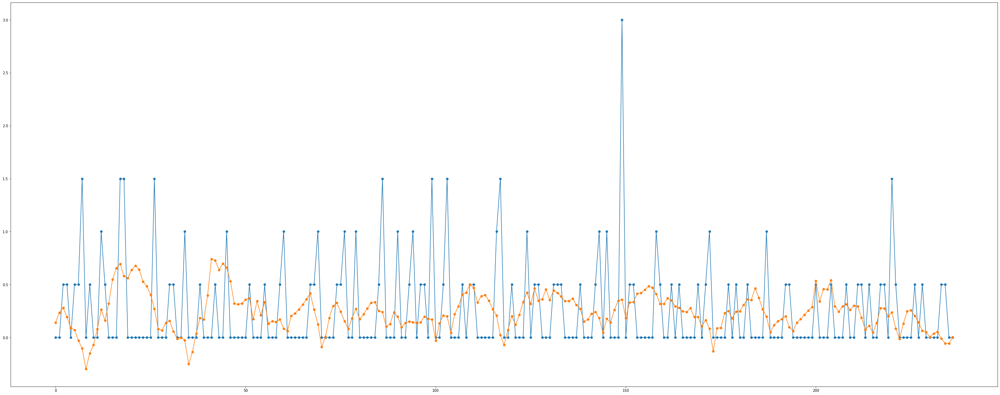

============================model:34===========================


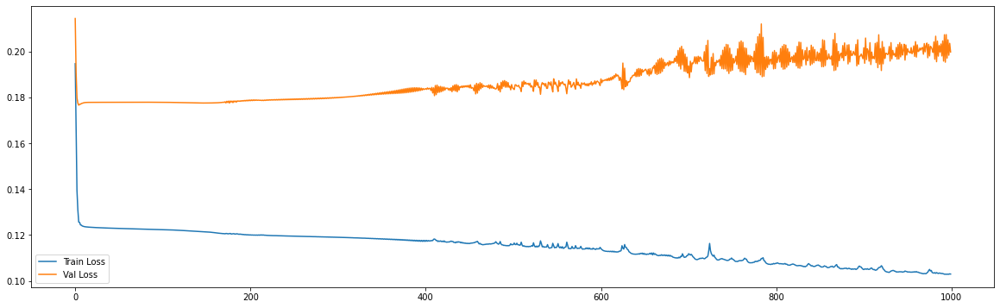

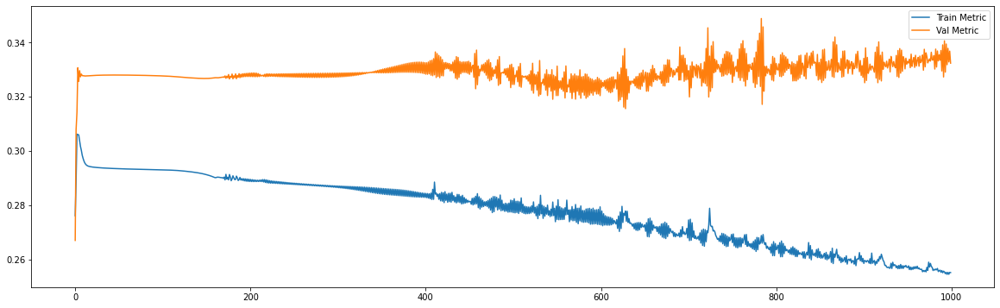

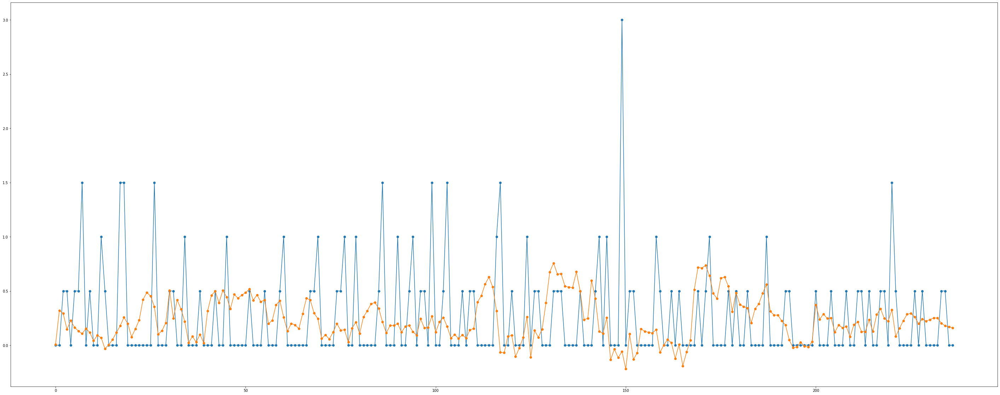

============================model:35===========================


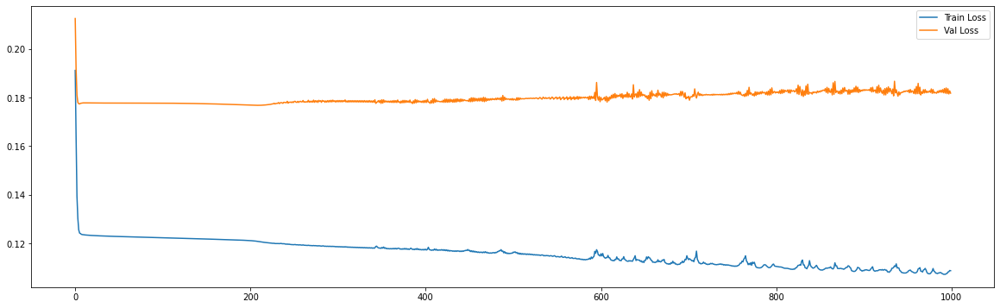

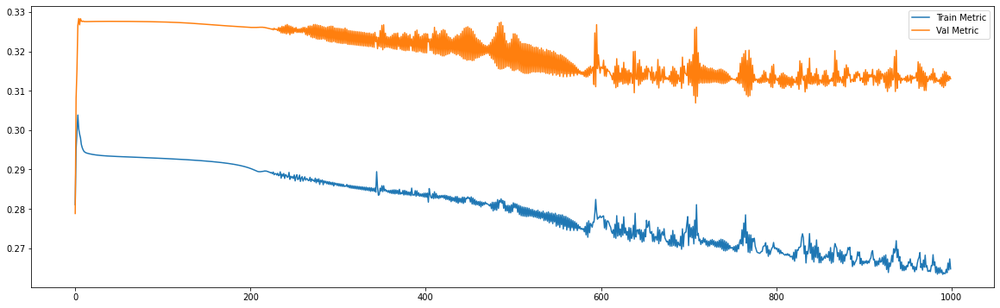

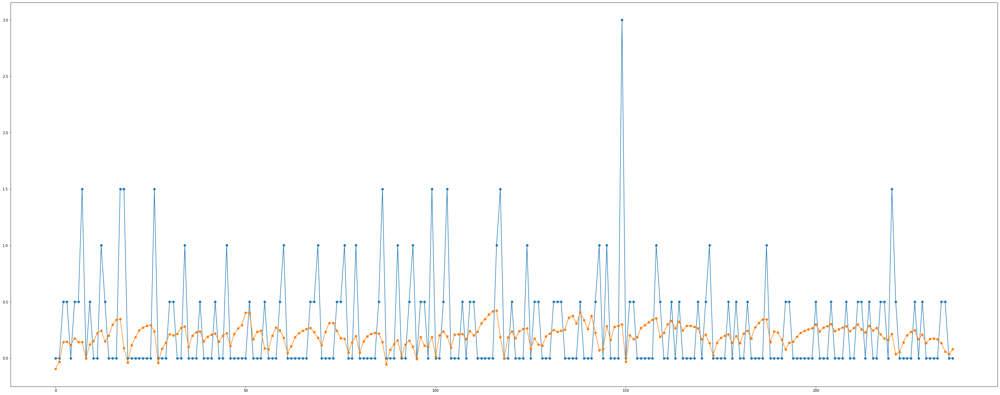

============================model:36===========================


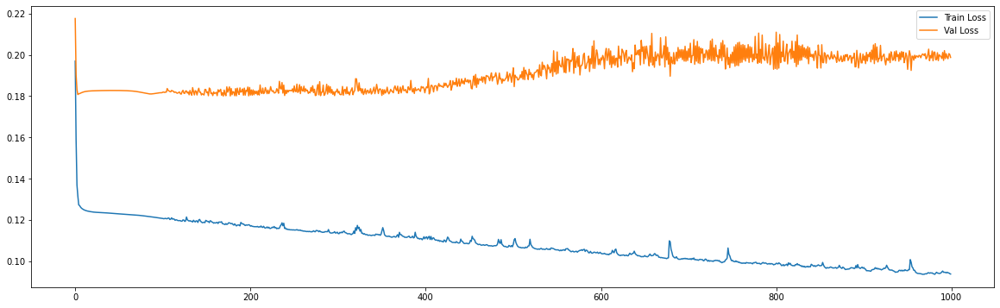

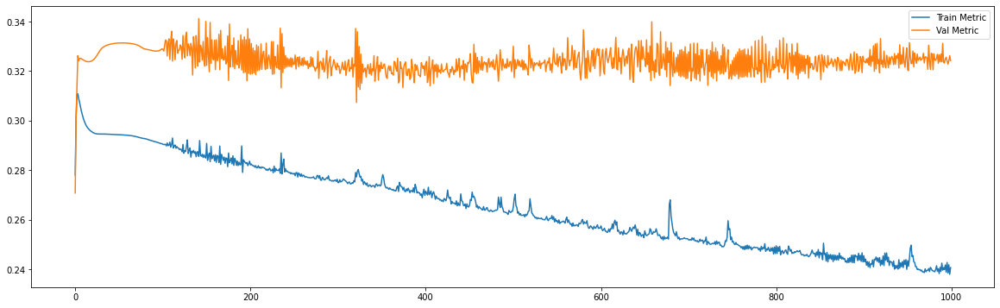

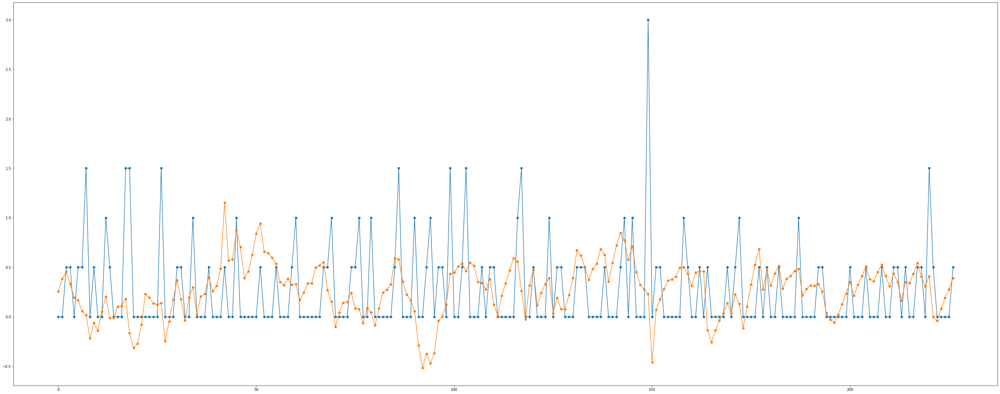

============================model:37===========================


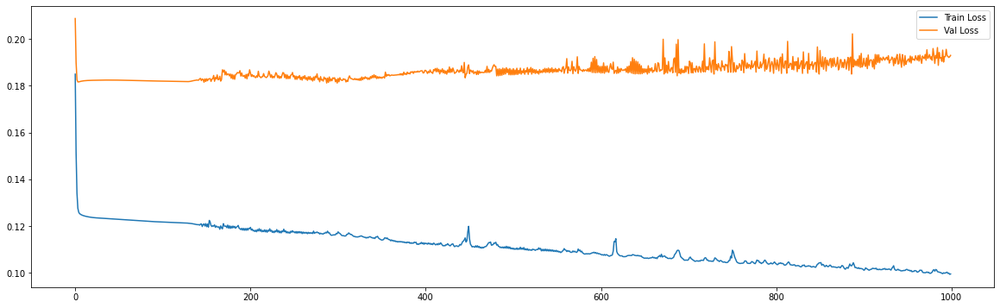

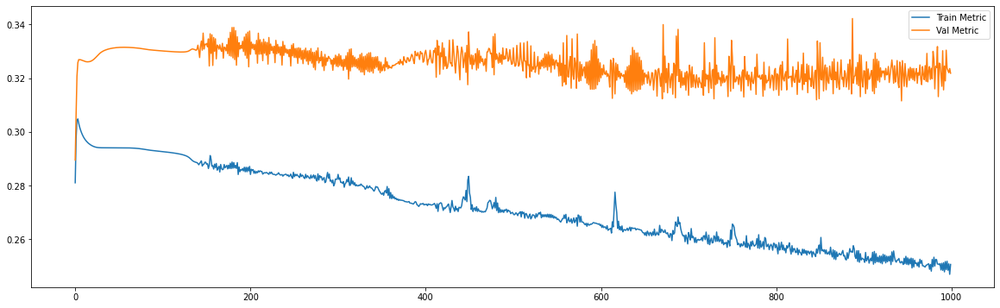

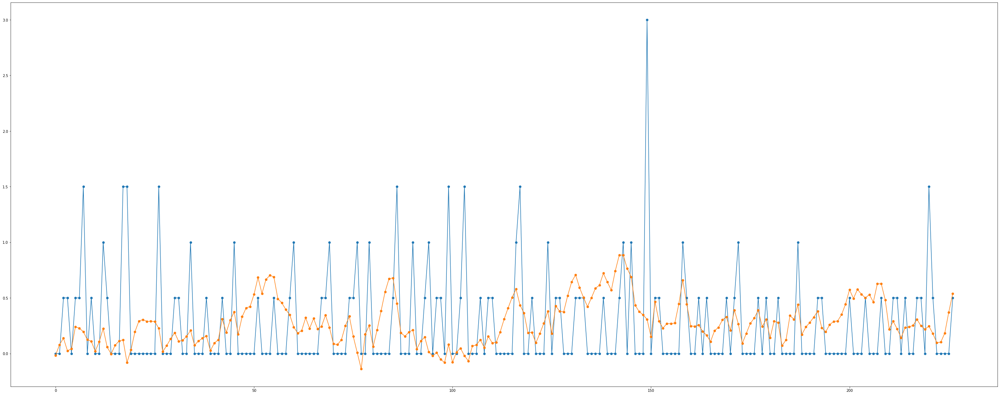

============================model:38===========================


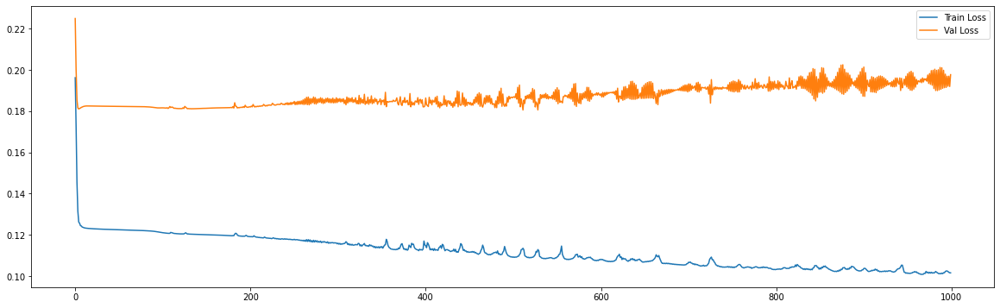

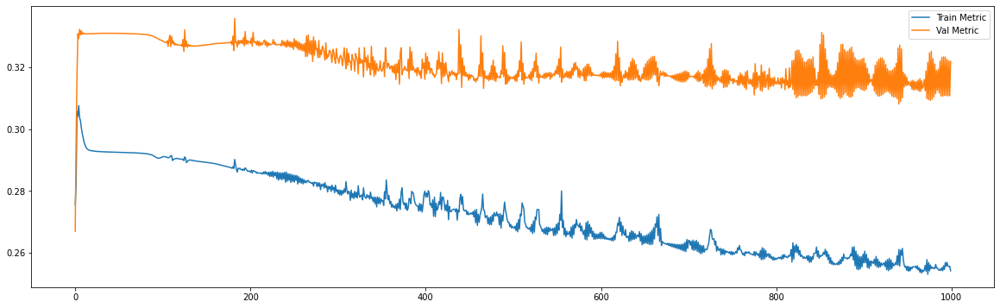

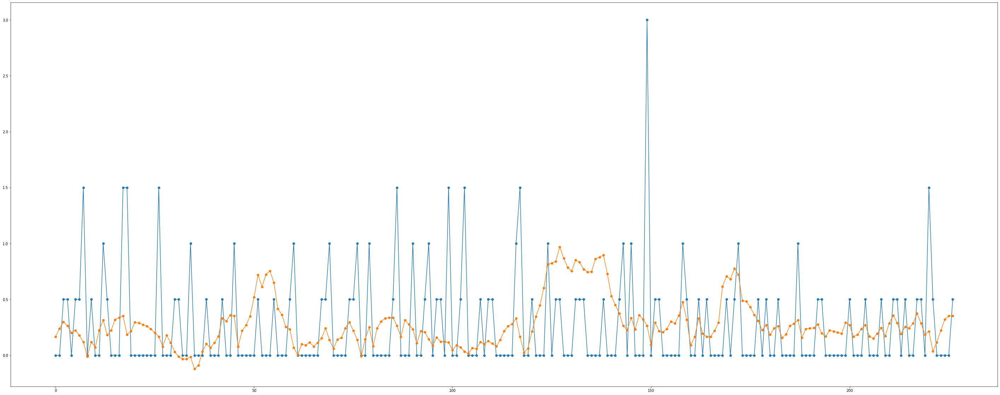

============================model:39===========================


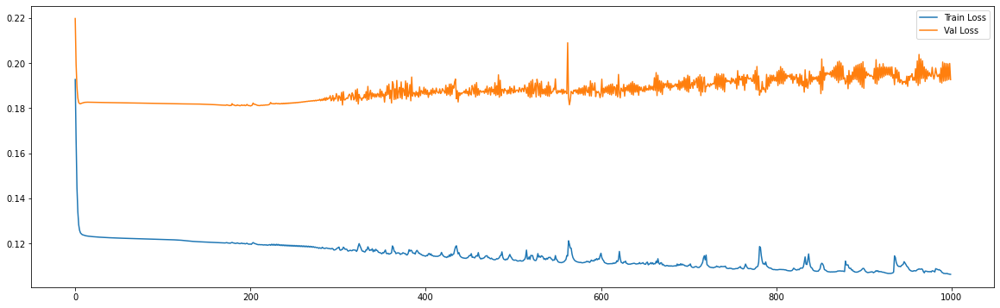

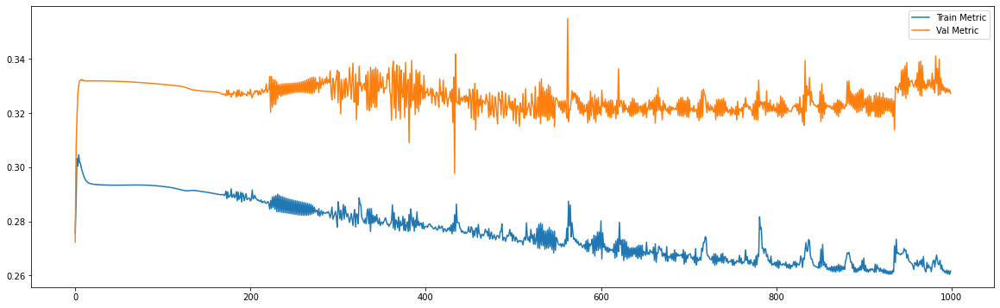

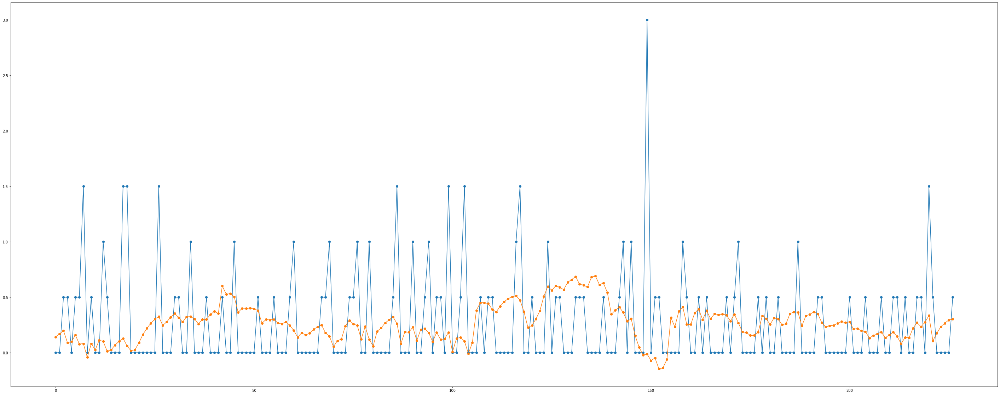

============================model:40===========================


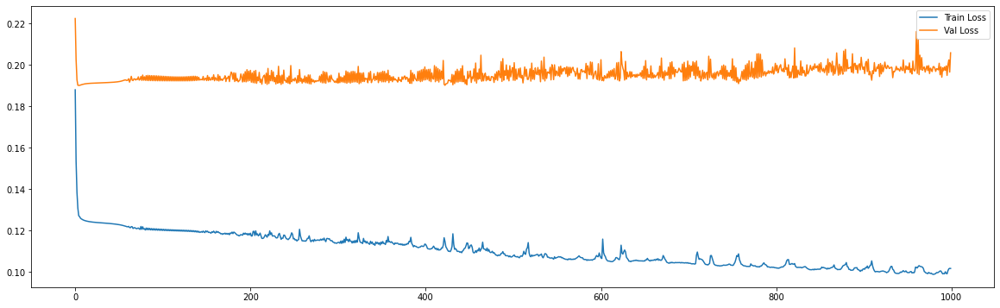

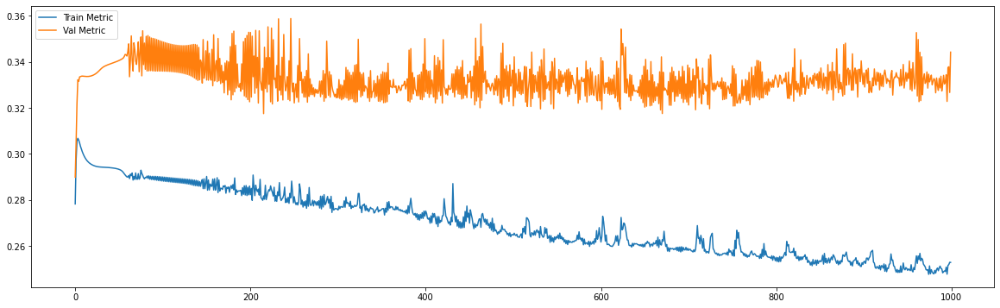

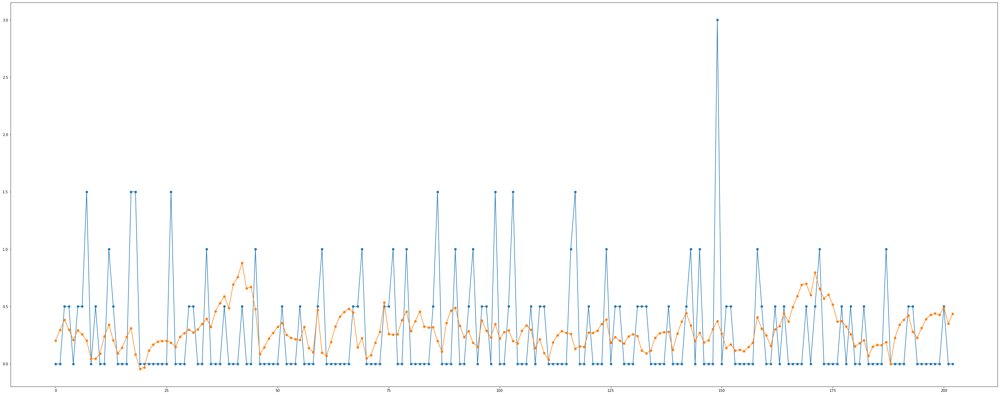

In [0]:
future_steps = 28
n_features = 1

neurons_list = [20,30,40,50]
dropout_list = [0.0,0.2]
time_steps_list = [50,60,84,100]
bach_list = [50,60,84,100]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch in bach_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_food_train,df_val = df_food_val,df_test = df_food_test)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}".format(neurons,dropout,time_steps,batch)

        # The LSTM architecture
        models[i] = Sequential()
        models[i].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i].add(Dropout(dropout))
        models[i].add(Dense(units=28))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        #Fitting to traning set
        history = models[i].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=batch, verbose = 0, shuffle= False)

        print('============================model:{}==========================='.format(i))
        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        y_val_pred = models[i].predict(x_val)
        plt.figure(figsize=(50,20))
        plt.plot(y_val[:,0],marker='o')
        plt.plot(y_val_pred[:,0],marker='o')
        plt.show()

        i+=1